In [1]:
#!/usr/bin/env python
import sys,os
#print sys.path
sys.path=["../../QA-sim","../../april/py"]+sys.path
print(sys.path)
from Parameter import Parameter
from BaseLikelihood import BaseLikelihood
import MCMCAnalyzer
import numpy as np
import quasim as qua
import math
import matplotlib.pyplot as plt
import corner
from uncertainties import ufloat
from uncertainties.umath import sqrt
from scipy.optimize import minimize
from scipy.optimize import fsolve

['../../QA-sim', '../../april/py', '/home/Zhi/QA-sim/notebook', '/usr/lib64/python310.zip', '/usr/lib64/python3.10', '/usr/lib64/python3.10/lib-dynload', '', '/home/Zhi/.local/lib/python3.10/site-packages', '/usr/lib64/python3.10/site-packages', '/usr/lib/python3.10/site-packages', '/usr/lib/python3.10/site-packages/IPython/extensions', '/home/Zhi/.ipython']


In [2]:
'''Find initial ra so that dot product at t = 0 is zero'''

def dot_(p,source,baseline, latitude = 0.71):
    x = np.cos(source[:,2])*np.cos(source[:,1]-p)
    y = np.cos(source[:,2])*np.sin(source[:,1]-p)
    z = np.sin(source[:,2])
    
    mid_x = (x[0]+x[1])/2
    mid_y = (y[0]+y[1])/2
    mid_z = (z[0]+z[1])/2
    
    dx = x[0]-x[1]
    dy = y[0]-y[1]
    dz = (z[0]-z[1]) - np.sin(latitude)
    
    
    maximum = np.sqrt(dy**2+dx**2+dz**2)*np.sqrt(baseline[0]**2+baseline[1]**2)
    #print('max =',maximum)
    #para = -baseline[1]*np.sin(baseline[2])*dx + baseline[0]*dy + baseline[1]*np.cos(baseline[2])*dz
    ortho = -baseline[1]*np.sin(baseline[2])*mid_x + baseline[0]*mid_y + baseline[1]*np.cos(baseline[2])*mid_z
    
    #print(para)
    return ortho
    #return para

In [3]:
'''Find brightest star with 4.86e-6 rad separation and 1.45e-4 rad separation'''

QT = qua.QuaTel(A=1.0,ph=0.0)
BSC = qua.BSC_process("/home/Zhi/QA-sim/bsc5.dat") 
pos = []
for time in range(1,13):
    pair = BSC.BSC_filter(obs_t = time)
    pos.append(pair)
    
pos = np.array(pos)
print('different pos are :', pos)
print('end of line')
lam = 0.55*10**(-6)

# Baseline vector in [B_EW,B_NS,L=latitude]
B = [200.,0.,0.71]

# Use some sample star, here I use sample pos[0] as a sample star
T = [-500,500]
numAll = []
tAll = []
sourceList = []
for i in range(12):
    source = pos[i][0]
    print(source)
    arg = (source,B)
    extra_ra = fsolve(dot_,np.pi/4,arg)
    source -= np.array([[0.,extra_ra[0]+np.pi/2,0.,0.],[0.,extra_ra[0]+np.pi/2,0.,0.]])
    sourceList.append(source)
    num, t, baseline, theo_phase, d_source = QT.get_num_photon(source,B,lam,T,'pos')
    numAll.append(num)
    tAll.append(t)
    baseline = None
    theo_phase = None
    d_source = None
numAll = np.array(numAll)
tAll = np.array(tAll)

different pos are : [[[[4.05800000e+03 2.70515853e+00 3.46283020e-01 1.09926243e+02]
   [4.05700000e+03 2.70513671e+00 3.46302412e-01 3.28928408e+02]]]


 [[[5.05500000e+03 3.50785000e+00 9.58563914e-01 9.57417549e+01]
   [5.05400000e+03 3.50778455e+00 9.58626940e-01 4.49884866e+02]]]


 [[[5.05500000e+03 3.50785000e+00 9.58563914e-01 9.57417549e+01]
   [5.05400000e+03 3.50778455e+00 9.58626940e-01 4.49884866e+02]]]


 [[[5.50600000e+03 3.86148279e+00 4.72533351e-01 3.02762013e+02]
   [5.50500000e+03 3.86148279e+00 4.72547895e-01 3.25912775e+01]]]


 [[[7.95600000e+03 5.44184934e+00 5.99942386e-01 3.91833338e+01]
   [7.94900000e+03 5.43762419e+00 5.92893195e-01 3.77660343e+02]]]


 [[[7.95600000e+03 5.44184934e+00 5.99942386e-01 3.91833338e+01]
   [7.94900000e+03 5.43762419e+00 5.92893195e-01 3.77660343e+02]]]


 [[[7.95600000e+03 5.44184934e+00 5.99942386e-01 3.91833338e+01]
   [7.94900000e+03 5.43762419e+00 5.92893195e-01 3.77660343e+02]]]


 [[[6.04000000e+02 5.40666641e-01 7.388124

ValueError: not enough values to unpack (expected 5, got 3)

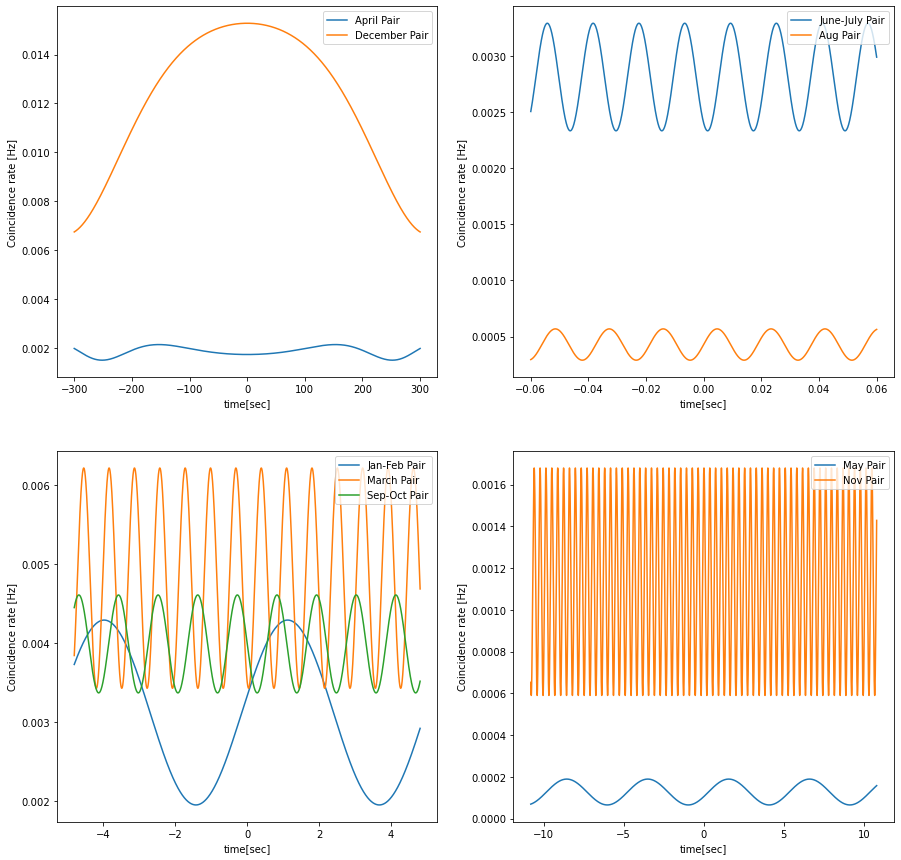

In [6]:
mid = tAll.shape[1]//2
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(221)
ax1 = fig.add_subplot(222)
ax2 = fig.add_subplot(223)
ax3 = fig.add_subplot(224)
#for i in range(12):
#    ax.plot(tAll[i,mid-50000:mid+50000],numAll[i,0,mid-50000:mid+50000],label = i)
ax2.plot(tAll[0,mid-80000:mid+80000],numAll[0,0,mid-80000:mid+80000],label = 'Jan-Feb Pair')
ax2.plot(tAll[2,mid-80000:mid+80000],numAll[2,0,mid-80000:mid+80000],label = 'March Pair')
ax.plot(tAll[3,mid-5000000:mid+5000000],numAll[3,0,mid-5000000:mid+5000000],label = 'April Pair')
ax3.plot(tAll[4,mid-180000:mid+180000],numAll[4,0,mid-180000:mid+180000],label = 'May Pair')
ax1.plot(tAll[5,mid-1000:mid+1000],numAll[5,0,mid-1000:mid+1000],label = 'June-July Pair')
ax1.plot(tAll[7,mid-1000:mid+1000],numAll[7,0,mid-1000:mid+1000],label = 'Aug Pair')
ax2.plot(tAll[8,mid-80000:mid+80000],numAll[8,0,mid-80000:mid+80000],label = 'Sep-Oct Pair')
ax3.plot(tAll[10,mid-180000:mid+180000],numAll[10,0,mid-180000:mid+180000],label = 'Nov Pair')
ax.plot(tAll[11,mid-5000000:mid+5000000],numAll[11,0,mid-5000000:mid+5000000],label = 'December Pair')
ax.set_xlabel('time[sec]');ax.set_ylabel('Coincidence rate [Hz]')
ax.legend(loc='upper right')
ax1.set_xlabel('time[sec]');ax1.set_ylabel('Coincidence rate [Hz]')
ax1.legend(loc='upper right')
ax2.set_xlabel('time[sec]');ax2.set_ylabel('Coincidence rate [Hz]')
ax2.legend(loc='upper right')
ax3.set_xlabel('time[sec]');ax3.set_ylabel('Coincidence rate [Hz]')
ax3.legend(loc='upper right')

In [ ]:
# Create Input data
# Create star pair position placed in the E-W direction. Dec=0
QT = qua.QuaTel(A=5.0,ph=0.0)
BSC = qua.BSC_process("/home/Zhi/QA-sim/bsc5.dat")

pos_ew = BSC.BSC_filter(limit=[5.0e-5,9.0e-5])   # 15arcsec separation
pos_ns = BSC.BSC_filter(limit=[5.0e-5,9.0e-5])

#pos_ew = BSC.BSC_filter(limit=[3.0e-6,7.0e-6]) 
#pos_ns = BSC.BSC_filter(limit=[3.0e-6,7.0e-6]) 
lam = 0.55*10**(-6)

# Baseline vector in [B_EW,B_NS,L=latitude]
B_ew = [200.,0.,0.71]
B_ns = [0.,200.,0.71]
# Use some sample star, here I use sample pos[0] as a sample star
T = [-5000,5000]      #[-10000,+10000]
source_ns = pos_ew[0]
source_ew = pos_ns[0]
arg_ns = (source_ns,B_ns)
extra_ra_ns = fsolve(dot_,np.pi/4,arg_ns)
arg_ew = (source_ew,B_ew)
extra_ra_ew = fsolve(dot_,np.pi/4,arg_ew)

source_ns -= np.array([[0.,extra_ra_ns[0]+np.pi,0.,0.],[0.,extra_ra_ns[0]+np.pi,0.,0.]])
source_ew -= np.array([[0.,extra_ra_ew[0]+np.pi/2,0.,0.],[0.,extra_ra_ew[0]+np.pi/2,0.,0.]])

num_ns, t_ns, theo_phase_ns = QT.get_num_photon(source_ns,B_ns,lam,T,'pos')
#num_ns = num_ns[0] 

num_ew, t_ew, theo_phase_ew = QT.get_num_photon(source_ew,B_ew,lam,T,'pos')
#num_ns = num_ns[0] 

f_ew, new_t_ew= QT.freq_func(theo_phase_ew,t_ew)
f_ns, new_t_ns= QT.freq_func(theo_phase_ns,t_ns)

theo_phase_ew = None
theo_phase_ns = None


/usr/lib64/python3.10/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


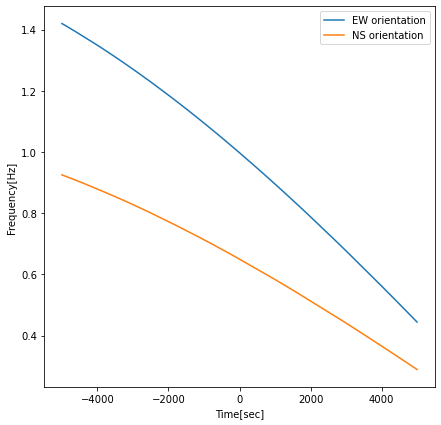

In [8]:
fig1 = plt.figure(figsize=(7,7))
ax1 = fig1.add_subplot(111)

ax1.plot(new_t_ew[np.arange(0,new_t_ew.size,20)],f_ew[0][np.arange(0,new_t_ew.size,20)],label='EW orientation')
ax1.plot(new_t_ns[np.arange(0,new_t_ns.size,20)],np.absolute(f_ns[0][np.arange(0,new_t_ns.size,20)]),label='NS orientation')
ax1.set_xlabel('Time[sec]');ax1.set_ylabel('Frequency[Hz]')
ax1.legend(loc='upper right')



fig1.savefig('ew_vs_ns_freq',facecolor='white')

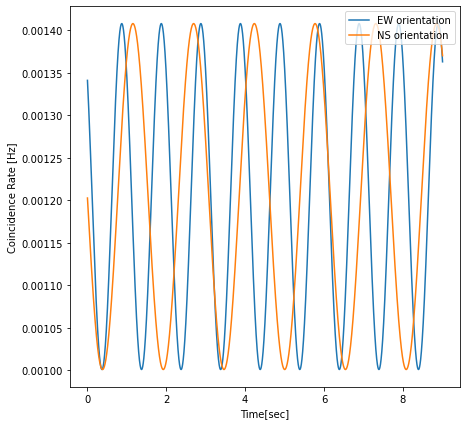

In [7]:
fig2 = plt.figure(figsize=(7,7))
ax2 = fig2.add_subplot(111)
ax2.plot(t_ew[t_ew.size//2:t_ew.size//2+100000],num_ew[0][t_ew.size//2:t_ew.size//2+100000],label='EW orientation')
ax2.plot(t_ns[t_ew.size//2:t_ew.size//2+100000],num_ns[0][t_ew.size//2:t_ew.size//2+100000],label='NS orientation')
ax2.set_xlabel('Time[sec]');ax2.set_ylabel('Coincidence Rate [Hz]')
ax2.legend(loc='upper right')
fig2.savefig('ew_vs_ns_rate',facecolor='white')

[-0.00314474]


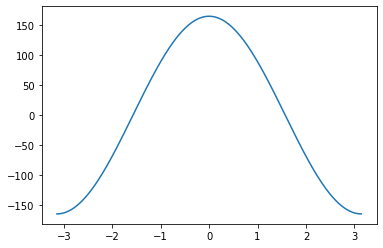

In [9]:
x= np.linspace(-np.pi,np.pi,1000)
y = []

for i in x:
    #print(i)|
    yi = dot_(i,source,B)
    y.append(yi)
    
plt.plot(x,y)
print(x[np.where(y==np.amax(y))])


TypeError: 'NoneType' object is not subscriptable

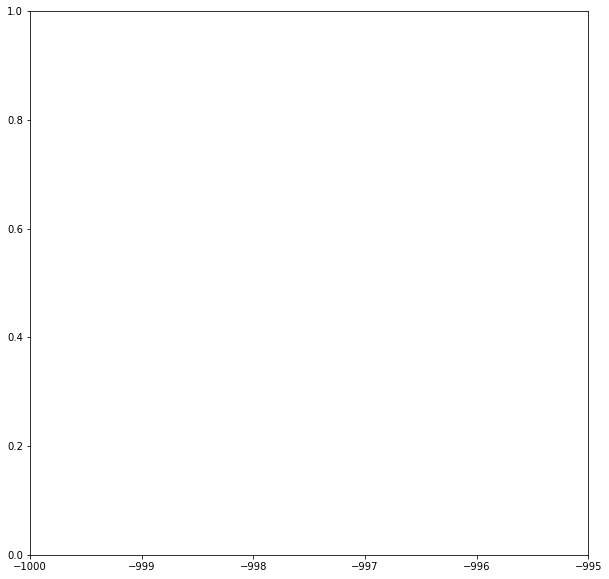

In [4]:
plt.figure(figsize=(10,10))
plt.xlim([-1000,-995])
plt.plot(t_pos[:1500000],(posNum[0]*20.0)[:1500000],label='Theo rate curve')
plt.scatter(posData.timestamp[:],posData.sim_num[:])
plt.xlabel('time[sec]');plt.ylabel('Rates[Hz]')
#plt.legend()

In [3]:
# Create Input data
# Create star pair position placed in the E-W direction. Dec=0

QT = qua.QuaTel(A=5.0, ph=0.0)
BSC = qua.BSC_process("/home/Zhi/QA-sim/bsc5.dat")

#pos = np.array([[0,1.2,0.0,450.0],[0,1.202,0.0,90.0]])
#pos = BSC.BSC_filter(limit=[3.0e-6,7.0e-6])   # 1arcsec separation
#pos = BSC.BSC_filter(limit=[5.0e-5,9.0e-5])   # 15arcsec separation
pos = BSC.BSC_filter(obs_t = 8)
print(pos)
lam = 0.55*10**(-6)

# Baseline vector in [B_EW,B_NS,L=latitude]
B = [200.,0.,0.71]

# Use some sample star, here I use sample pos[0] as a sample star
T = [-10000,10000]      #[-10000,+10000]
#source = pos[3] - np.array([[0.,0.,pos[3][0,2],0.,],[0.,0.,pos[3][1,2],0.]]) 
source = pos[0]
#source -= np.array([[0.,0.0,pos[0][0,2],0.,],[0.,0.,pos[0][1,2],0.]]) 
print('source before modification :', source)
arg = (source,B)
extra_ra = fsolve(dot_,np.pi/2,arg)
print('Extra ra that need to get subtracted from original =', extra_ra)
extra_ra =(source[0,1]+source[1,1])/2
#source -= np.array([[0.,extra_ra[0]+np.pi/2,0.,0.],[0.,extra_ra[0]+np.pi/2,0.,0.]])    #paper setup
#source -= np.array([[0.,extra_ra[0]+5*np.pi/4,0.,0.],[0.,extra_ra[0]+5*np.pi/4,0.,0.]])  # 1arcsec ns
#source -= np.array([[0.,extra_ra[0]+1*np.pi+1e-5,0.,0.],[0.,extra_ra[0]+1*np.pi/2+1e-5,0.,0.]])    #15arcsec ns
source -= np.array([[0.0,extra_ra+3*np.pi/2,0.0,0.0],[0.0,extra_ra+3*np.pi/2,0.0,0.0]])

print('source after modification: ',source)
print('dot product after modification on init ra =',dot_(0.,source,B))

boost = 1.0

posNum, t_pos, posPhase = QT.get_num_photon(source,B,lam,T,'pos')
posData = qua.sim_data(posNum[0]*boost, t_pos, posPhase[0],'pos')   
posPhase = None
posNum = None

print('Positive Data Done')

negNum, t_neg, negPhase = QT.get_num_photon(source,B,lam,T,'neg')
negData = qua.sim_data(negNum[0]*boost,t_neg, negPhase[0],'neg')
negPhase = None
negNum = None

#print('theo_d',np.linalg.norm(d_source[0,int(d_source[0,:,0].size/2),:]))
#vmag = -2.5*np.log10(source[:,3]/3640.)
#print(vmag)
#print(QT.vis[0][0])

[[[6.04000000e+02 5.40666641e-01 7.38812417e-01 4.21794958e+01]
  [6.03000000e+02 5.40615736e-01 7.38793024e-01 4.54047599e+02]]]
source before modification : [[6.04000000e+02 5.40666641e-01 7.38812417e-01 4.21794958e+01]
 [6.03000000e+02 5.40615736e-01 7.38793024e-01 4.54047599e+02]]
Extra ra that need to get subtracted from original = [0.54064119]
source after modification:  [[604.          -4.71236353   0.73881242  42.17949576]
 [603.          -4.71241443   0.73879302 454.04759918]]
dot product after modification on init ra = 147.85506801258143
Positive Data Done


In [19]:
class sim_like(BaseLikelihood):
    
    def __init__(self, seed, pos_t, pos_s, lam, t_pos = None, t_neg = None):  # seed = [V_init,d_ra_init, d_dec_init]
        BaseLikelihood.__init__(self,"sim_data")  
        
        # free par
        self.seed = seed
        self.V = seed[0]
        self.d_ew = seed[1]
        self.d_ns = seed[2]
        self.offset = seed[3]
        
        # fixed values
        self.t_pos = t_pos             # timestamp for the sim data
        self.t_neg = t_neg
        
        self.baseline = np.array(pos_t)
        
        pos_s = np.delete(pos_s, 0, axis=1)  # delete star # part.
        self.pos_s = pos_s     # position of sources to determine midpoint
        
        self.lam = lam         # lambda for observation
        self.Omega_E = 7.292e-5
    # ,bounds=(self.seed[2]-5.5*8e-10,self.seed[2]+5.5*8e-10)
    def freeParameters(self):
        return [
                Parameter("V", self.seed[0], err=0.04,bounds=(0.0,1.0)),    #0.1 for 1arcsec ,bounds=(-0.1,0.7)
                Parameter("d_ew",self.seed[1], err=5e-10,),   #5e-10
                Parameter("d_ns",self.seed[2], err=15e-10,),   #12e-10 for 1arcsec, 5e-10 for 15arcsec
                Parameter("offset",self.seed[3], err=np.pi/10,bounds=(-np.pi,np.pi)),   #bounds=(-np.pi,np.pi)
                ]
    
    def updateParams(self,params):    #params is also a class, updates param value.
        for p in params:
            if p.name=="V":
                self.V=p.value
            if p.name=="d_ew":
                self.d_ew=p.value
            if p.name=="d_ns":
                self.d_ns=p.value
            if p.name=="offset":
                self.offset=p.value
                
        
    def source_pos(self,ti):
        N = ti.size
        M = len(self.pos_s)  
            
        PHI = self.pos_s[:,0]
        PHI_mid = np.tile((PHI[0]+PHI[1])/2,(N))-self.Omega_E*ti
        DEC = self.pos_s[:,1]
        DEC_mid = np.tile((DEC[0]+DEC[1])/2,(N))  
            
        dx = -np.sin(DEC_mid)*np.cos(PHI_mid)*self.d_ns - self.d_ew*np.sin(PHI_mid)
        dy = -np.sin(DEC_mid)*np.sin(PHI_mid)*self.d_ns + self.d_ew*np.cos(PHI_mid)
        dz = self.d_ns * np.cos(DEC_mid)
        
        new_posi = np.column_stack((dx,dy,dz))
        
        return new_posi

    
    
    def get_phase(self):
        if self.t_pos is not None:
            new_pos_s = self.source_pos(self.t_pos)
            dot = -self.baseline[1]*np.sin(self.baseline[2])*new_pos_s[:,0] \
               + self.baseline[0] *new_pos_s[:,1] \
               +self.baseline[1]*np.cos(self.baseline[2])*new_pos_s[:,2]
       
            phase_pos = 2*np.pi/self.lam*dot + self.offset   # Total phase with the offset for plus mode
            
        
        if self.t_neg is not None:
            new_pos_s = self.source_pos(self.t_neg)
            
            dot = -self.baseline[1]*np.sin(self.baseline[2])*new_pos_s[:,0] \
               + self.baseline[0] *new_pos_s[:,1] \
               +self.baseline[1]*np.cos(self.baseline[2])*new_pos_s[:,2]
       
            phase_neg = 2*np.pi/self.lam*dot + self.offset   # Total phase with the offset for plus mode
                        
        
        if (self.t_neg is None and self.t_pos is not None):
            
            return phase_pos
        
        elif (self.t_neg is not None and self.t_pos is None):
            
            return phase_neg
        
        else:
            
            return [phase_pos,phase_neg]
        
    
    
    def loglike_wprior(self):
        phase = self.get_phase()
        
        if (self.t_neg is None and self.t_pos is not None):
           
            res = np.sum(np.log(1+self.V*np.cos(phase)) , axis=None)
            
        elif (self.t_neg is not None and self.t_pos is None):
  
            res = np.sum(np.log(1-self.V*np.cos(phase)), axis=None)
        
        else:

            res = np.sum(np.log(1+self.V*np.cos(phase[0])), axis=None) \
                    + np.sum(np.log(1-self.V*np.cos(phase[1])), axis=None)
            
        
        
        return res


In [20]:
# Find theoretical parameter values
d_ns_theo = source[0,2]-source[1,2]
d_ew_theo = np.cos((source[0,2]+source[1,2])/2)*(source[0,1]-source[1,1])
theo_par = np.array([posData.V,d_ew_theo,d_ns_theo,QT.ph])

def distance(s1,s2):
    DEC_mid = (s1[2]+s2[2])/2.0
    PHI_mid = (s1[1]+s2[1])/2.0
    d_DEC = s1[2]-s2[2] 
    d_PHI = s1[1]-s2[1]
    # Find theoretical separation
    dx = -np.sin(DEC_mid)*np.cos(PHI_mid)*d_DEC - d_PHI*np.cos(DEC_mid)*np.sin(PHI_mid)
    dy = -np.sin(DEC_mid)*np.sin(PHI_mid)*d_DEC + d_PHI*np.cos(DEC_mid)*np.cos(PHI_mid)
    dz = d_DEC * np.cos(DEC_mid)
    
    theo_d = np.sqrt(dx**2+dy**2+dz**2)
    
    return theo_d

print(source[0])
print(source[1])
theo_d = distance(source[0],source[1])
print(theo_d)
print(theo_par)

L= sim_like(theo_par, B, source, lam, t_pos = posData.timestamp, t_neg = negData.timestamp)
L.loglike_wprior()

[604.          -4.71236353   0.73881242  42.17949576]
[603.          -4.71241443   0.73879302 454.04759918]
4.233584363400375e-05
[8.43344623e-02 3.76331339e-05 1.93925472e-05 0.00000000e+00]


4.596352817858109

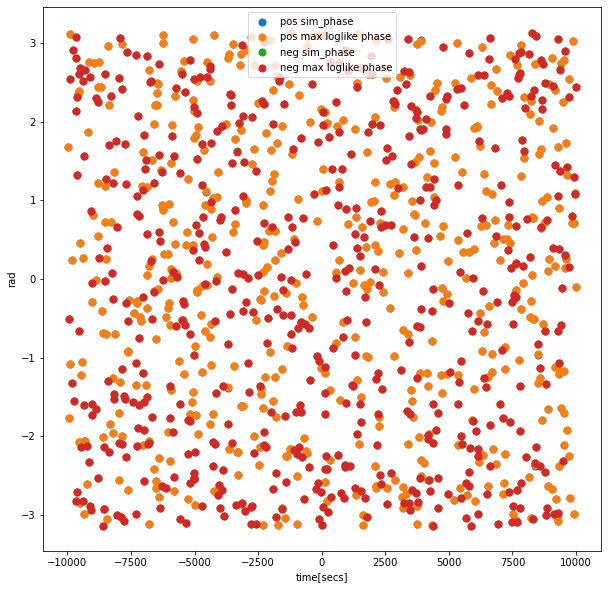

In [10]:
plt.figure(figsize=(10,10))
#plt.subplot(2,2,1)
#plt.xlim([-5000,-3000])
#plt.plot(t[:200000], np.mod((theo_phase[:200000]+ np.pi),2*np.pi) - np.pi, color = 'g',label='theo phase curve')

plt.scatter(posData.timestamp[:],np.mod((posData.phase[:]+ np.pi),2*np.pi) - np.pi,s=50, label = 'pos sim_phase')
plt.scatter(posData.timestamp[:], np.mod((L.get_phase()[0][:]+ np.pi),2*np.pi) - np.pi, s= 50,label = 'pos max loglike phase')

plt.scatter(negData.timestamp[:],np.mod((negData.phase[:]+ np.pi),2*np.pi) - np.pi,s=50, label = 'neg sim_phase')
plt.scatter(negData.timestamp[:], np.mod((L.get_phase()[1][:]+ np.pi),2*np.pi) - np.pi, s= 50,label = 'neg max loglike phase')
plt.xlabel('time[secs]');plt.ylabel('rad')
#plt.xlim([19.0,20])
plt.legend()

In [21]:
MCMCAnalyzer.MCMCAnalyzer(L,"/home/Zhi/QA-sim/MCMC_output/EW_Aug_5m",temp=2, nsamp=300000)

Bounds: [ 0.00000000e+00  3.76306339e-05  1.93865472e-05 -3.14159265e+00] [1.00000000e+00 3.76356339e-05 1.93985472e-05 3.14159265e+00]
Starting chain...
Accepted samples 1000 1
Accepted samples 2000 2
Accepted samples 3000 1
Accepted samples 4000 1
Accepted samples 5000 1
Re-initializing covariance matrix after burn-in
[[5.09967552e-03 1.36321251e-11 1.38814254e-11 1.62763418e-02]
 [1.36321251e-11 1.91367201e-19 1.01235533e-20 2.24287513e-11]
 [1.38814254e-11 1.01235533e-20 6.48796890e-19 6.65492519e-10]
 [1.62763418e-02 2.24287513e-11 6.65492519e-10 8.92967733e-01]]
V 0.011442492441281265 0.07141201245206569
d_ew 3.763112988035674e-05 4.374553699960457e-10
d_ns 1.93940800909998e-05 8.054792923521194e-10
offset 2.236807780393716 0.944969699668855
New maxloglike -0.26615608607849484
New maxloglike 0.3752493902872387
New maxloglike 0.9269849592182688
New maxloglike 1.3275184030545555
New maxloglike 2.891006819565654
New maxloglike 5.738895715120134
New maxloglike 5.978007829843943
New m

Accepted samples 277000 5
Accepted samples 278000 4
Accepted samples 279000 1
Accepted samples 280000 5
Accepted samples 281000 2
Accepted samples 282000 1
Accepted samples 283000 1
Accepted samples 284000 1
Accepted samples 285000 9
Accepted samples 286000 6
Accepted samples 287000 1
Accepted samples 288000 2
Accepted samples 289000 1
Accepted samples 290000 1
Accepted samples 291000 1
Accepted samples 292000 3
Accepted samples 293000 3
Accepted samples 294000 2
Accepted samples 295000 2
Accepted samples 296000 5
Accepted samples 297000 1
Accepted samples 298000 1
Accepted samples 299000 3
Accepted samples 300000 2


Theoretical parameter:  [ 2.68284711e-01  0.00000000e+00 -4.84813681e-06  0.00000000e+00]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.15967490648578858
590004
Sigma from MCMC = [0.0374675  0.02817352 0.25777645 1.35937308]


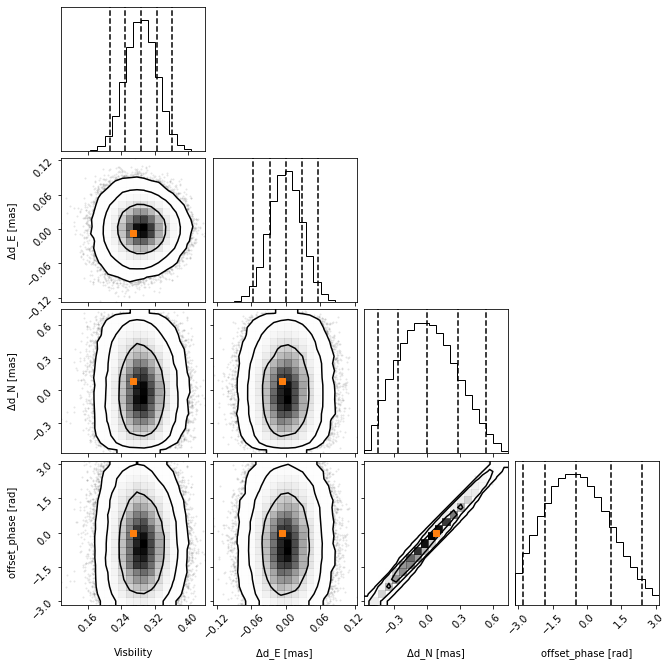

In [8]:
#loglike = 60
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_Dec_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_dec_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Theoretical parameter:  [8.43344623e-02 3.76331339e-05 1.93925472e-05 0.00000000e+00]
Sigma ew from general formula = 0.17616706135036622
Sigma ns from general formula = 0.09077979178290124
590004
Sigma from MCMC = [0.0591962  0.12974756 0.43497726 1.7932473 ]


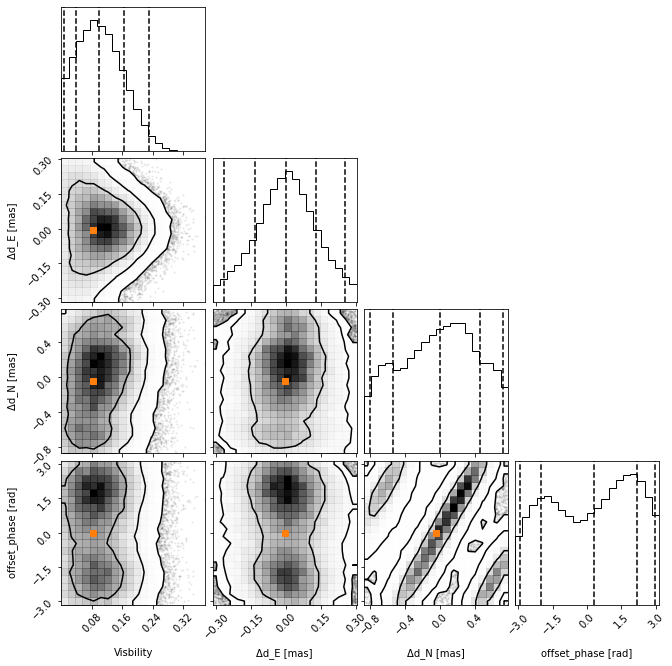

In [18]:
#loglike = 4.7
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_Aug_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_aug_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Theoretical parameter:  [0.09309216 0.00349569 0.00704919 0.        ]
Sigma ew from general formula = 0.35740307867881665
Sigma ns from general formula = 0.7207165040926844
590004
Sigma from MCMC = [0.07234528 0.1387088  0.27639128 1.64055447]


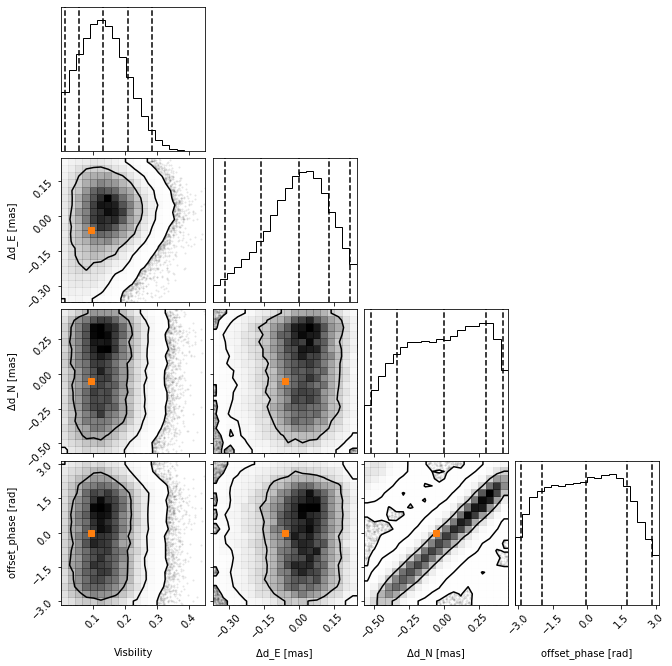

In [10]:
#loglike = 3.0
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_May_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_may_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Theoretical parameter:  [ 9.61787196e-02  0.00000000e+00 -1.45444104e-05  0.00000000e+00]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.5019047821110649
590004
Sigma from MCMC = [0.10482399 0.1620192  0.30519225 1.66828611]


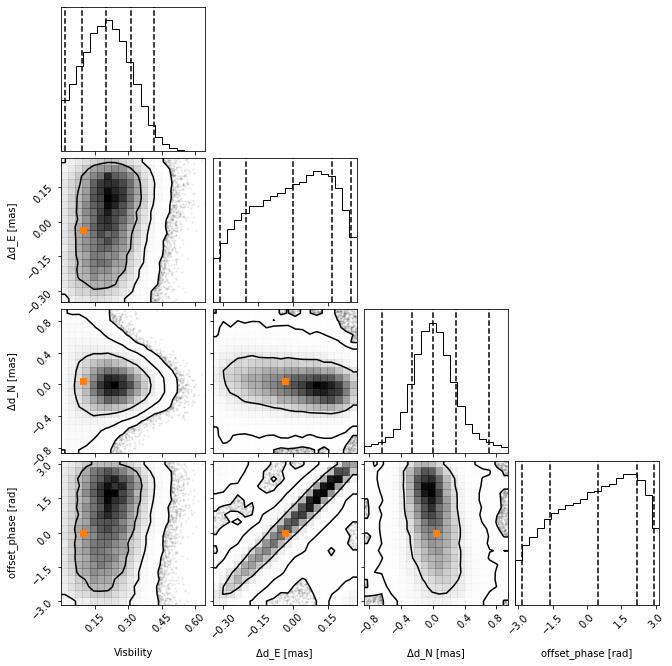

In [7]:
#loglike = 3
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_Apr_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_apr_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Theoretical parameter:  [ 1.69154507e-01  3.76120658e-05 -6.30257785e-05  0.00000000e+00]
Sigma ew from general formula = 0.05809049498759751
Sigma ns from general formula = 0.09734106848209971
590004
Sigma from MCMC = [0.06528233 0.15804582 0.26759331 1.67469971]


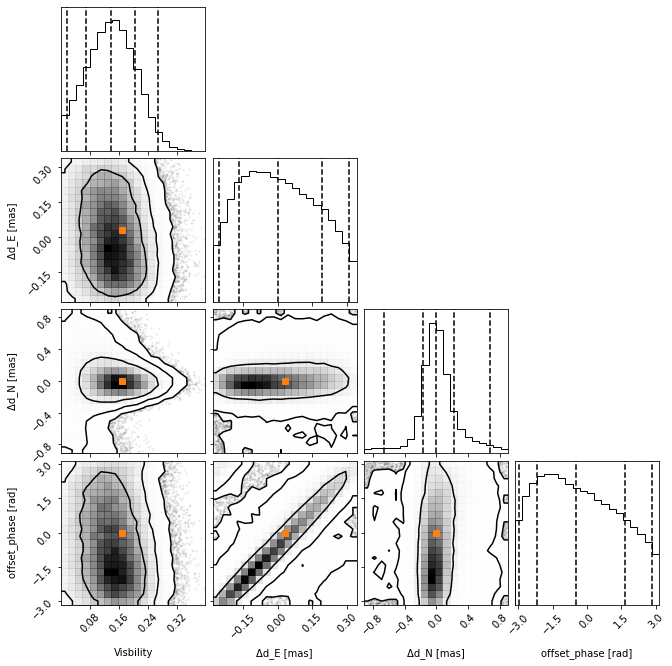

In [8]:
#loglike = 8
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_Mar_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_mar_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Theoretical parameter:  [ 2.31135865e-01  2.05215262e-05 -1.93925472e-05  0.00000000e+00]
Sigma ew from general formula = 0.15805655005531416
Sigma ns from general formula = 0.14936116732898191
590004
Sigma from MCMC = [0.07515308 0.15259754 0.21741313 1.57137754]


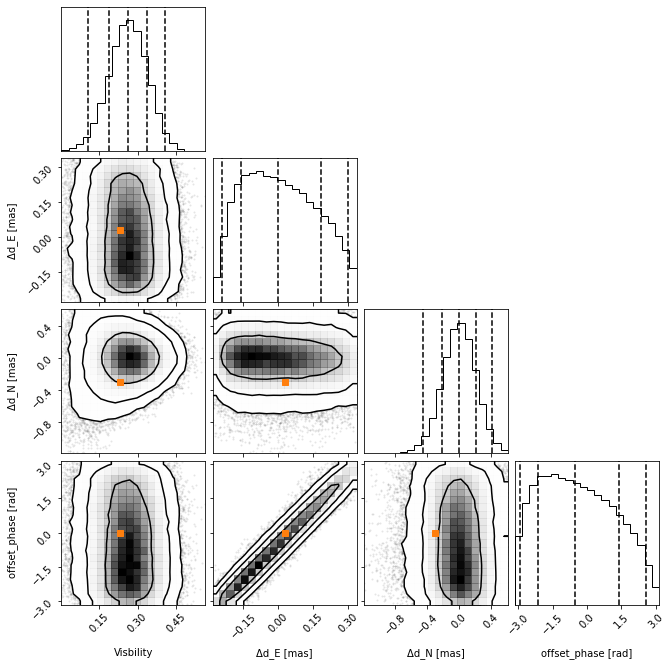

In [10]:
#loglike = 13
print('Theoretical parameter: ', theo_par)
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_Jan_5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_jan_5m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08618987796743445
Sigma ns from general formula = 0.14442663667236966
590004
Sigma from MCMC = [0.04795692 0.11469474 1.16649167 0.80351924]


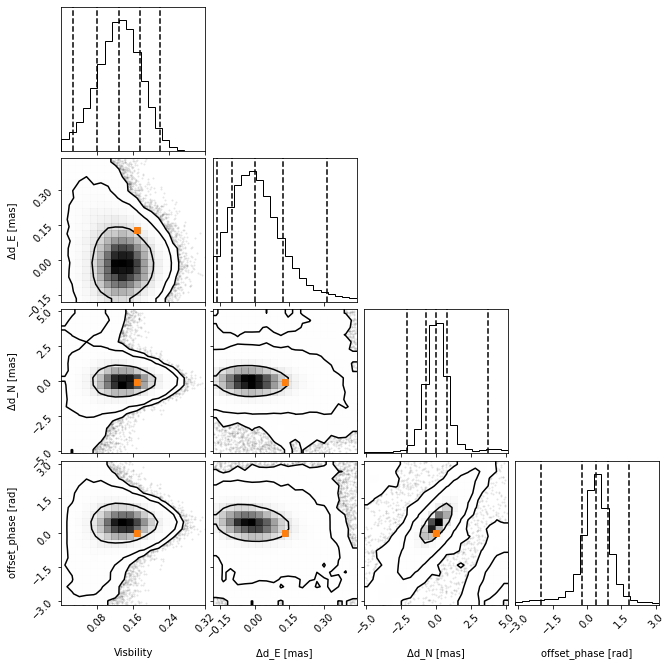

In [7]:
#loglike = 17
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_7.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_70_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.1005548576286739
Sigma ns from general formula = 0.16849774278443191
590004
Sigma from MCMC = [0.05656487 0.1327299  1.42874504 0.94584964]


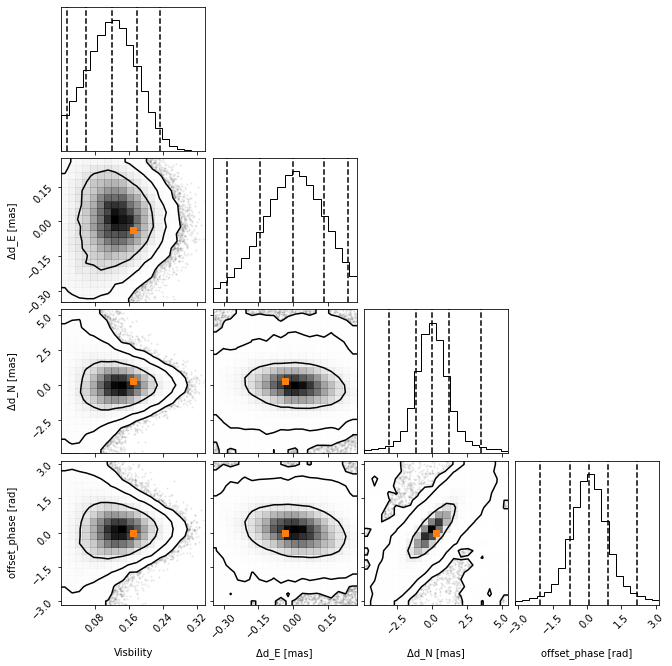

In [12]:
#loglike = 14
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_6.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_60_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 100.76141028570878
Sigma ns from general formula = 168.84385889753926
590004
Sigma from MCMC = [0.05837444 0.17509677 1.15530733 1.04844275]


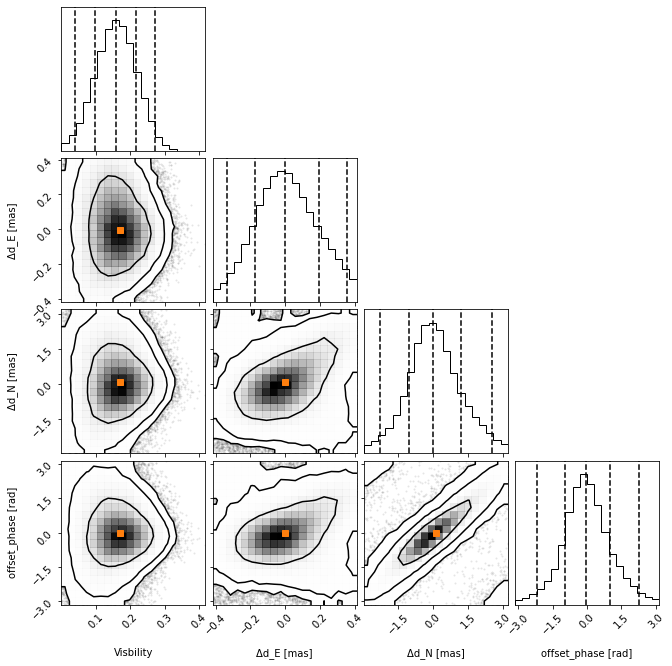

In [6]:
#loglike = 14
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_5.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_15as_mix_55_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.12066582915440867
Sigma ns from general formula = 0.20219729134131825
590004
Sigma from MCMC = [0.06422856 0.17251496 1.11828075 0.97812227]


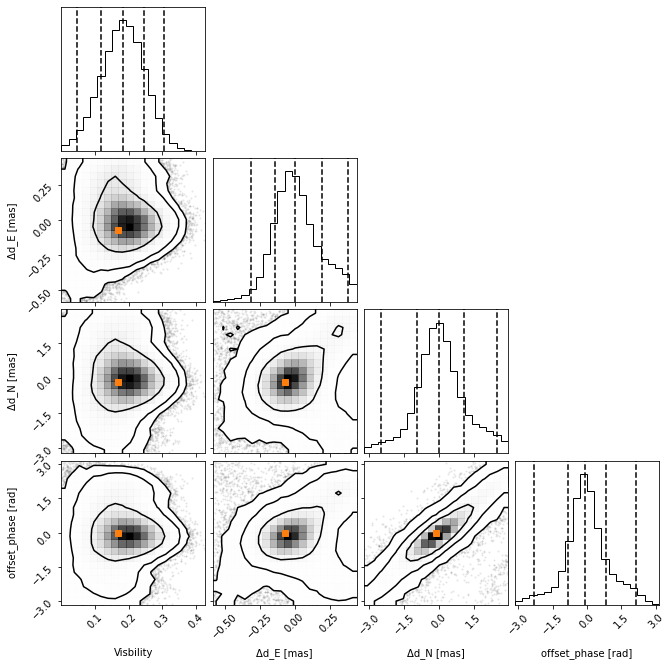

In [15]:
#loglike = 13
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_5.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_50_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08742289670561312
Sigma ns from general formula = 0.14649278125248807
590004
Sigma from MCMC = [0.06757093 0.23430665 2.15428288 1.43969804]


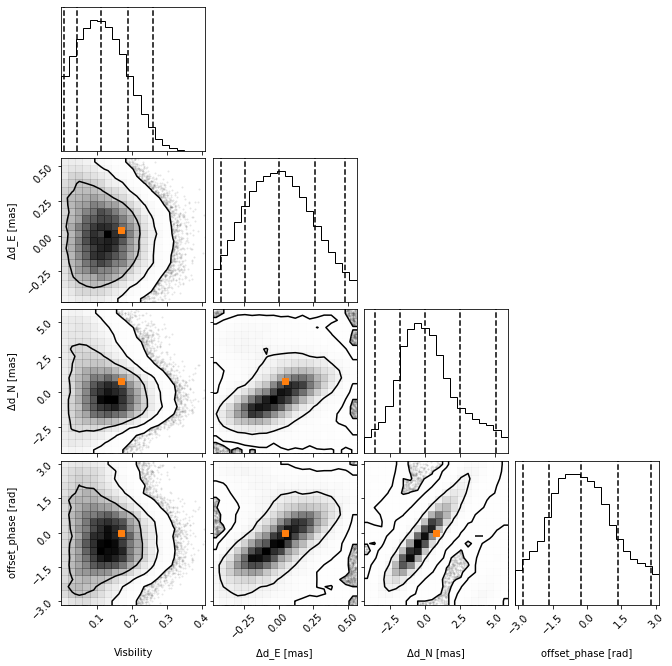

In [9]:
#loglike = 6
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_4.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_45_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.40777193860618044
590004
Sigma from MCMC = [0.06512346 0.09658861 0.44241634 1.60604781]


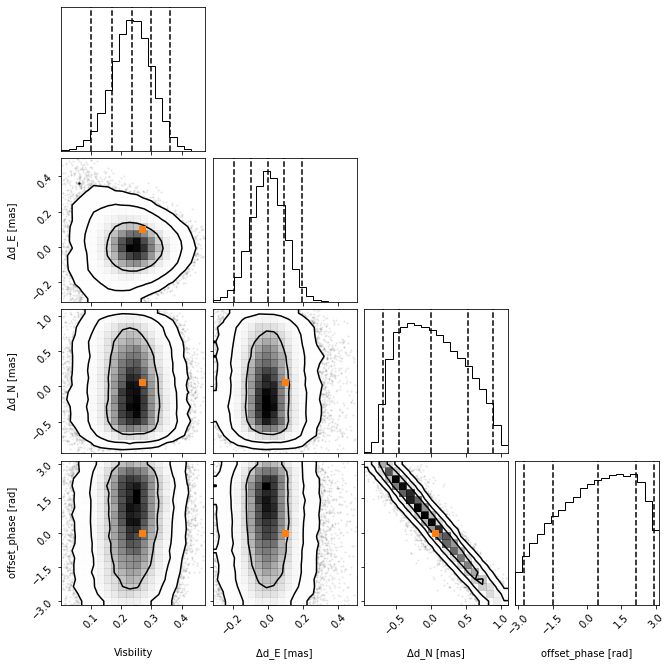

In [13]:
#loglike = 15
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_3.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_30_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.4893263263274168
590004
Sigma from MCMC = [0.07644186 0.10224696 0.42399939 1.54335992]


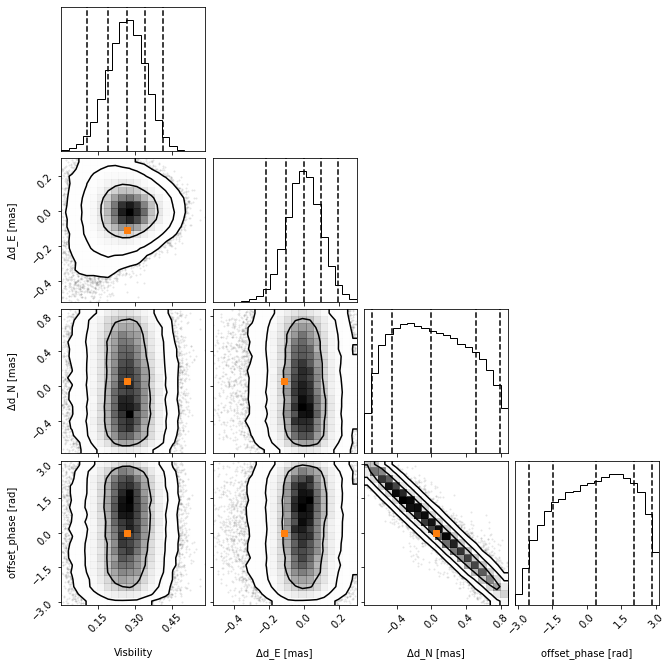

In [10]:
#loglike = 14
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_25_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.6116579079092708
590004
Sigma from MCMC = [0.0944681  0.14330718 0.52582023 1.74066541]


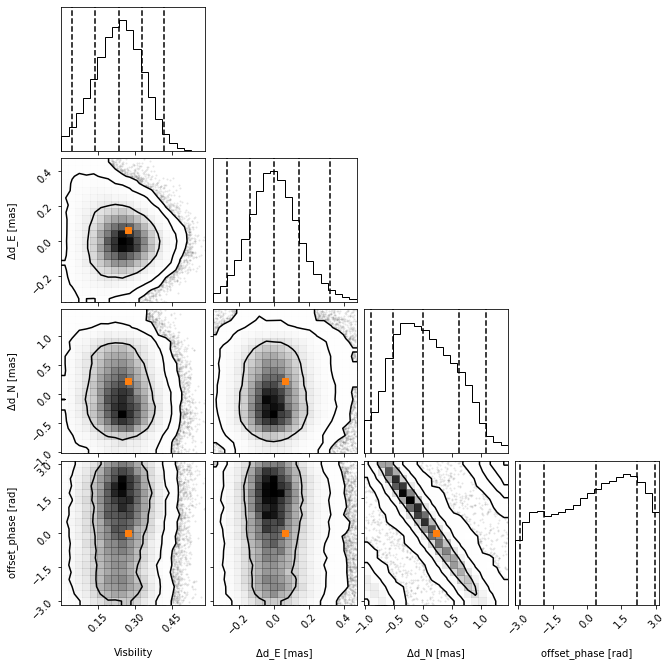

In [29]:
#loglike = 9
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_20_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.8155438772123609
590004
Sigma from MCMC = [0.11829516 0.15954665 0.88388629 1.78725939]


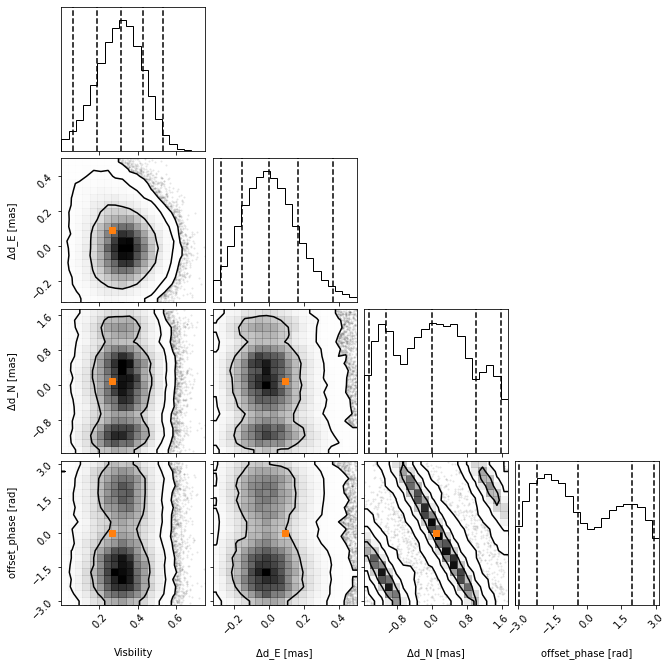

In [25]:
#loglike = 9
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_1.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_15_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.26612484414298093
590004
Sigma from MCMC = [0.06563555 0.0511201  0.29099961 1.55359703]


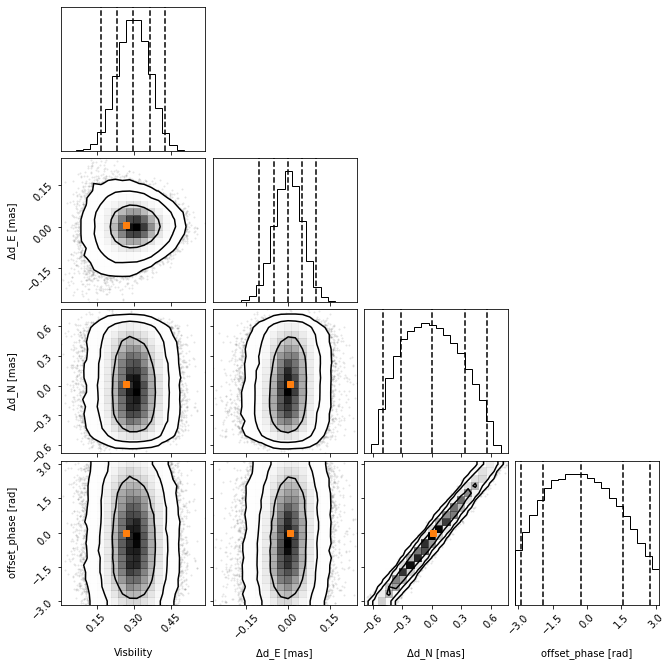

In [7]:
#loglike = 23
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_3.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_30_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.31934981297157716
590004
Sigma from MCMC = [0.07806454 0.06676991 0.30021476 1.61837835]


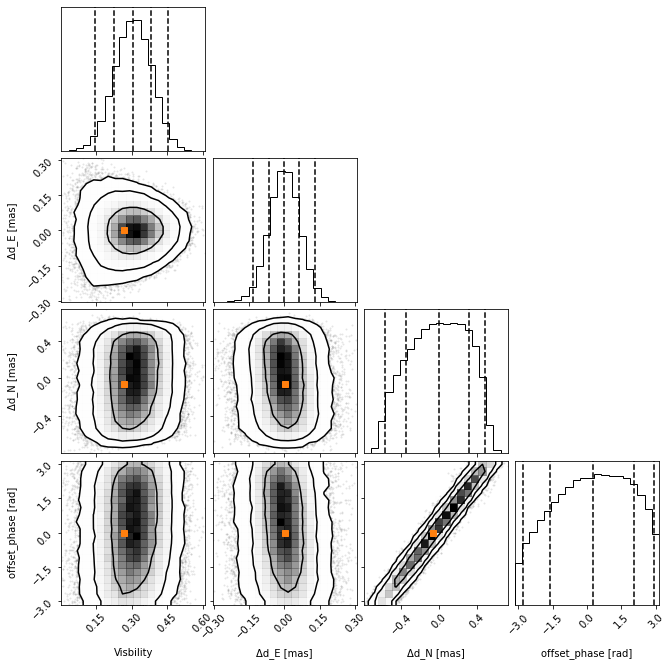

In [7]:
#loglike = 18
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_2.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_25_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.39918726621447137
590004
Sigma from MCMC = [0.09971435 0.08572218 0.29725067 1.55879912]


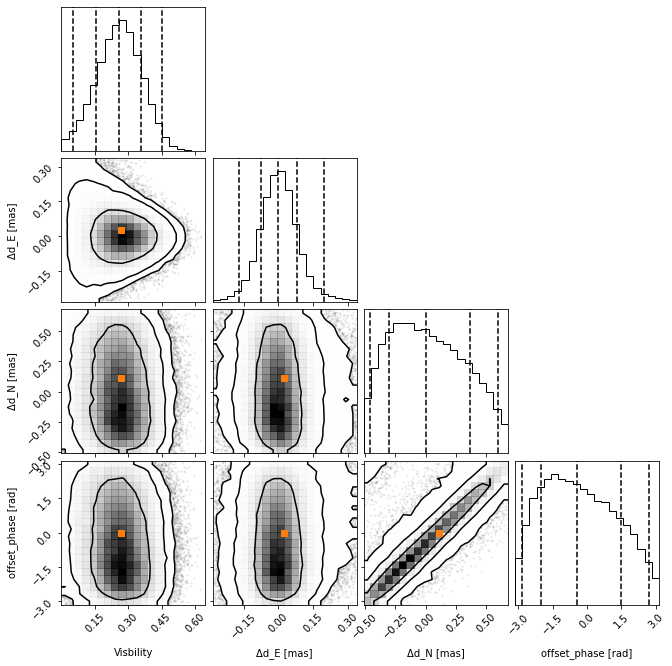

In [57]:
#loglike = 10
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_2.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_20_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.5322496882859619
590004
Sigma from MCMC = [0.12210404 0.1235518  0.26827375 1.46951955]


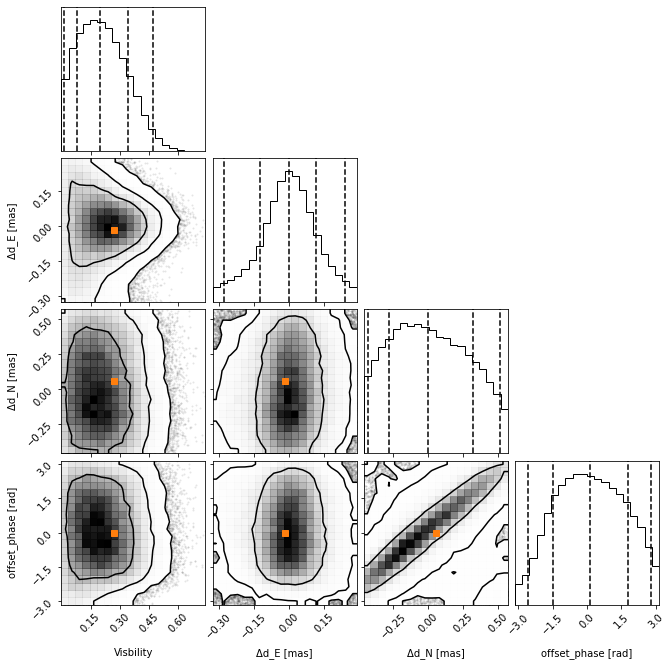

In [7]:
#loglike = ~4
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_1.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_15_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.03934030351725912
Sigma ns from general formula = 0.06592175156361987
590004
Sigma from MCMC = [0.02971001 0.04027039 0.18333218 1.51928852]


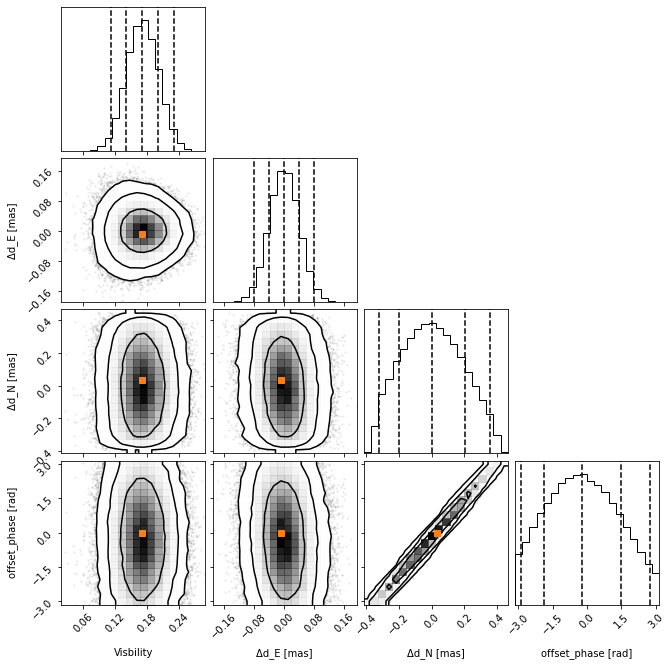

In [8]:
#loglike = 
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_10.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_100_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.056200433596084245
Sigma ns from general formula = 0.09417393080517092
590004
Sigma from MCMC = [0.04456047 0.08069987 0.19249648 1.63011304]


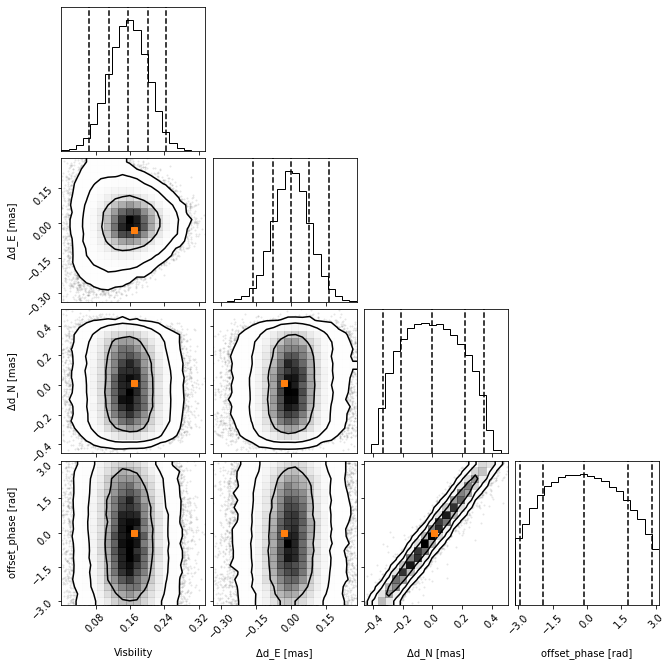

In [11]:
#loglike = 17
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_7.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_70_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.060523543872706115
Sigma ns from general formula = 0.10141807932864562
590004
Sigma from MCMC = [0.04791797 0.07487394 0.19831018 1.64147311]


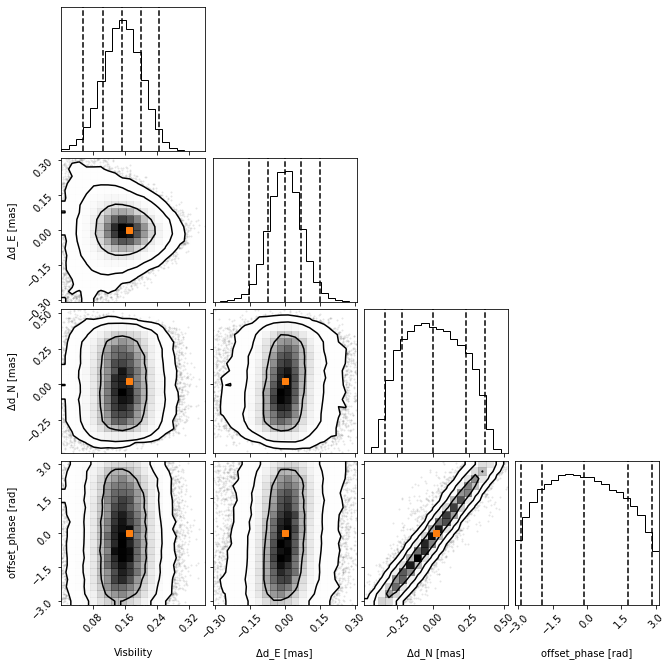

In [9]:
#loglike = 15 
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_6.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_65_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.06556717252876522
Sigma ns from general formula = 0.10986958593936651
590004
Sigma from MCMC = [0.05295924 0.0863067  0.19407577 1.6170395 ]


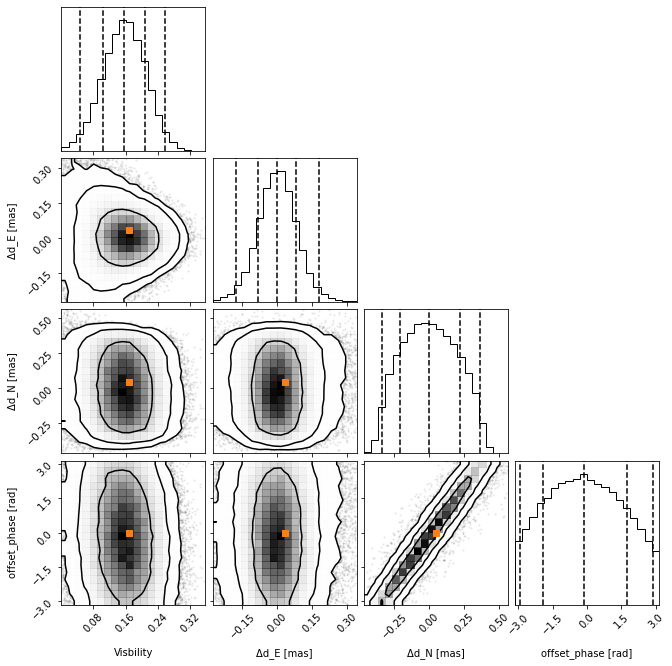

In [12]:
#loglike = 12
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_6.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_60_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.07152782457683476
Sigma ns from general formula = 0.11985773011567252
590004
Sigma from MCMC = [0.05905537 0.09097971 0.19769575 1.64013748]


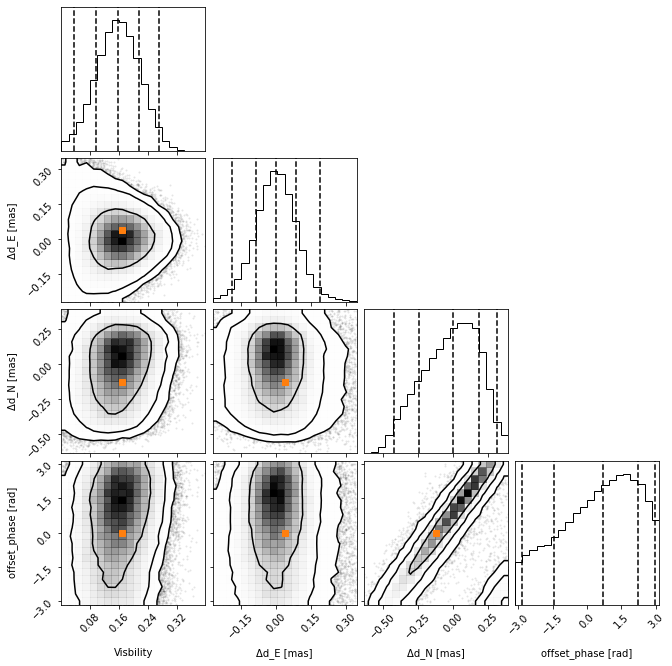

In [7]:
#loglike = 11
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_5.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_55_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.07868060703451824
Sigma ns from general formula = 0.13184350312723975
590004
Sigma from MCMC = [0.06604733 0.09537069 0.24046556 1.82270125]


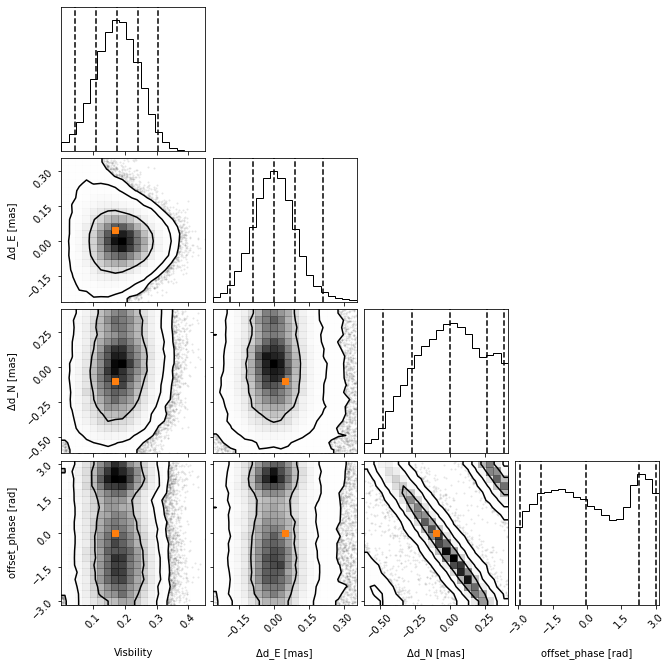

In [28]:
#loglike = 11
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_5.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_50_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08742289670561312
Sigma ns from general formula = 0.14649278125248807
590004
Sigma from MCMC = [0.05248863 0.26264705 2.68857052 1.66674736]


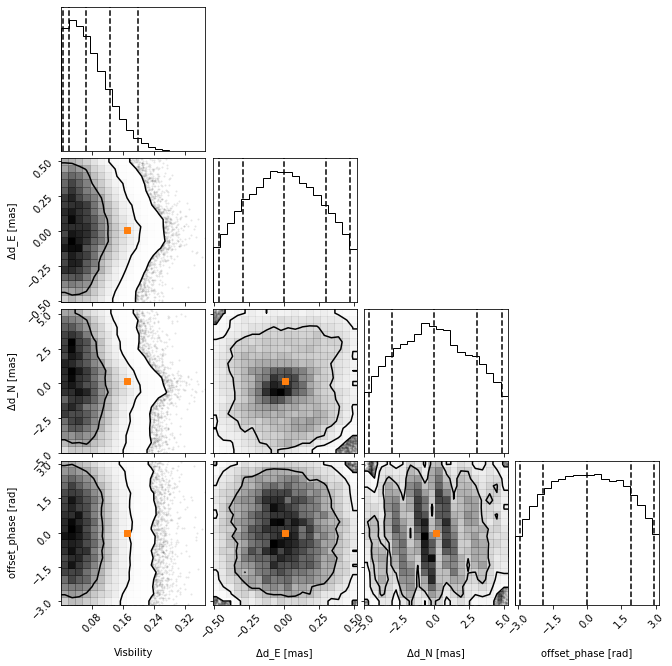

In [12]:
## loglike = 7.3
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_4.5_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_45_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0983507587931474
Sigma ns from general formula = 0.16480437890904906
590004
Sigma from MCMC = [0.07151605 0.14165026 0.2678283  1.87229394]


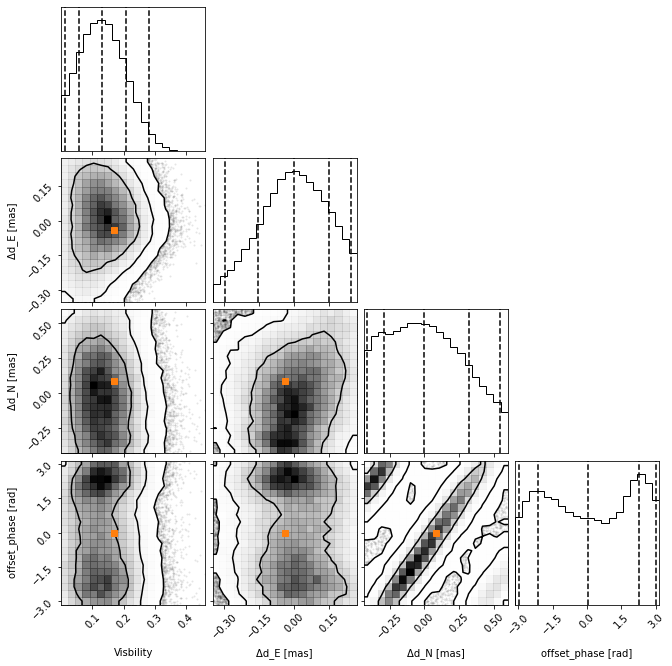

In [7]:
#loglike = 5.8
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_4.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_40_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

In [5]:
#loglike = 17
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_25',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

OSError: /home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.0_1.txt not found.

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.6116579079092708
590004
Sigma from MCMC = [0.09076645 0.29749903 3.0697399  1.69190749]


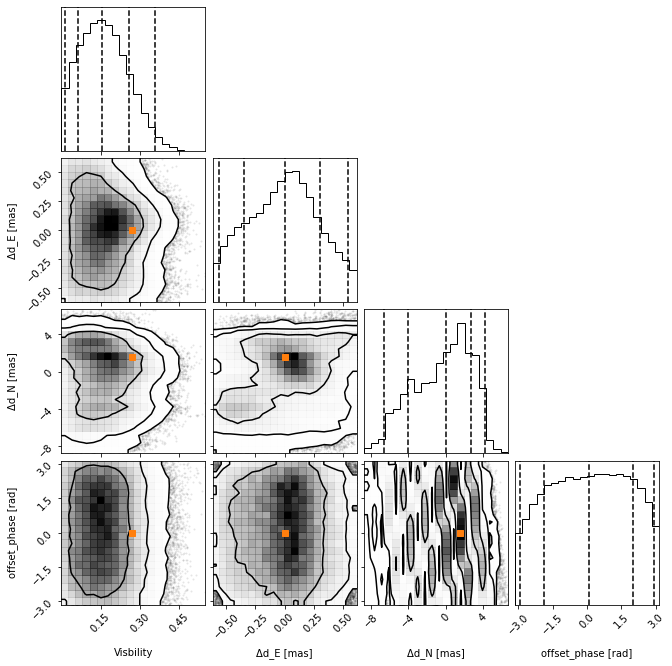

In [6]:
#loglike = 12.5
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.0_2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_20_2',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.6116579079092708
590004
Sigma from MCMC = [0.10174161 0.12810393 0.54069719 1.82699081]


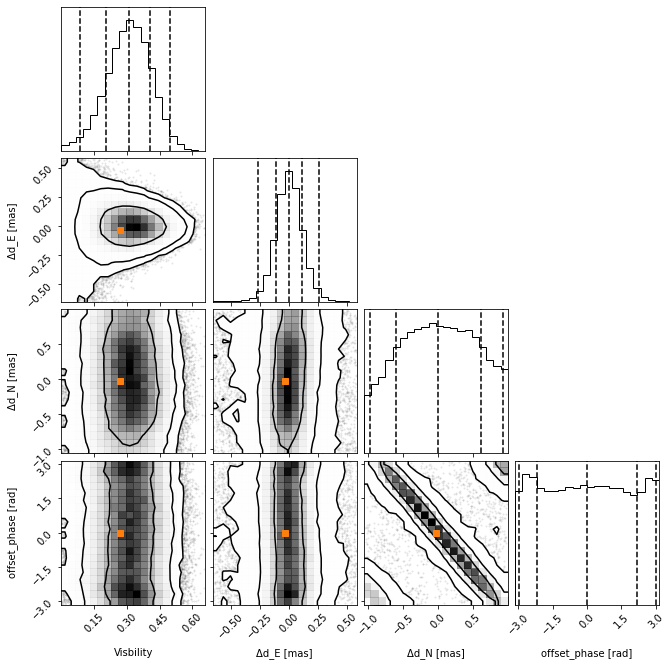

In [7]:
#loglike = 12.5
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.0_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_20_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.6116579079092708
590004
Sigma from MCMC = [0.09058588 0.10761463 0.23136139 0.81324565]


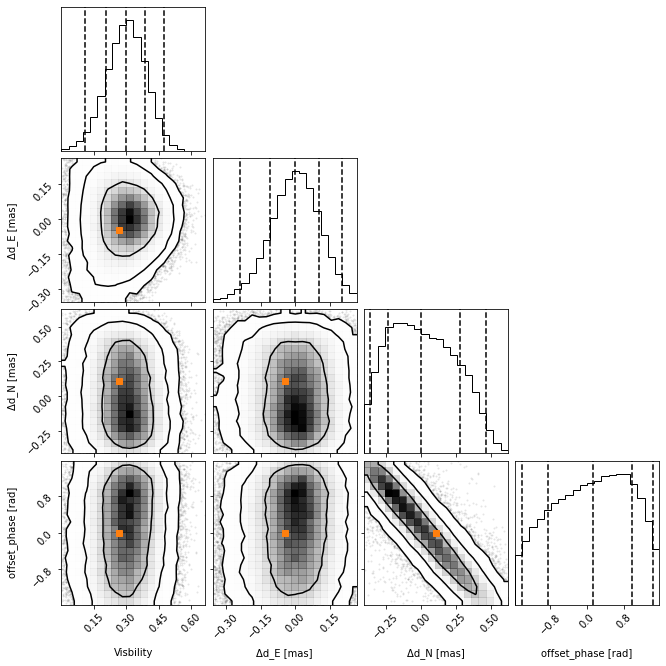

In [7]:
#loglike = 12.5
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_2.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_20',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.8155438772123609
590004
Sigma from MCMC = [0.12343291 0.13643207 0.27222499 1.14107272]


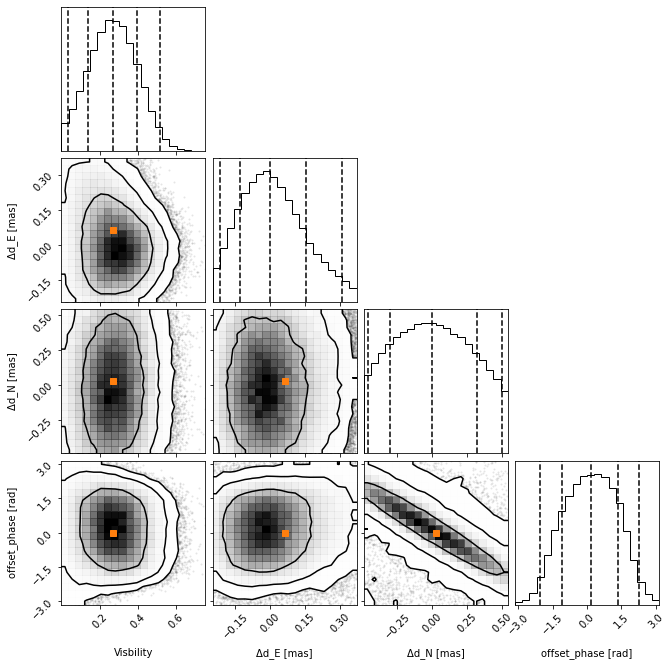

In [9]:
#loglike = 6.7
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_1as_mix_1.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_1as_mix_15',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.12066582915440867
Sigma ns from general formula = 0.20219729134131825
590004
Sigma from MCMC = [0.05778364 0.0901782  0.25850957 0.29471035]


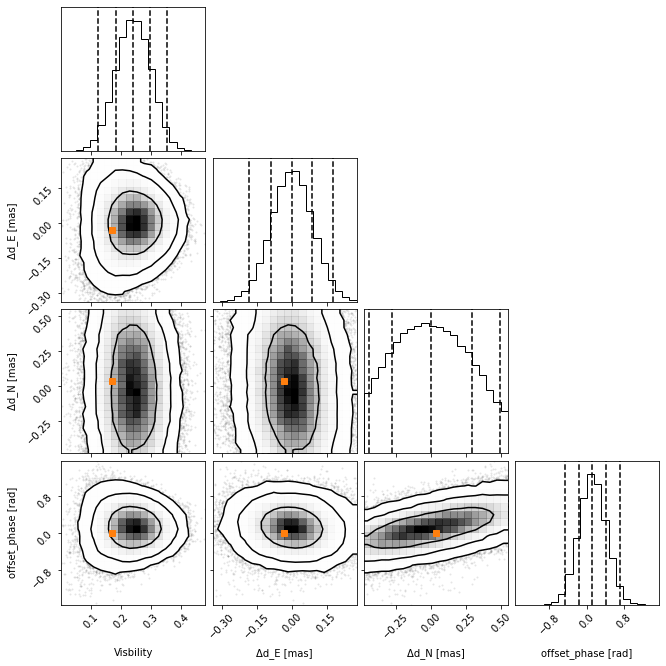

In [6]:
#loglike = 18
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_5.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_15as_mix_50',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.134073143504898
Sigma ns from general formula = 0.22466365704590835
590004
Sigma from MCMC = [0.06937845 0.09420386 0.26163425 0.30853631]


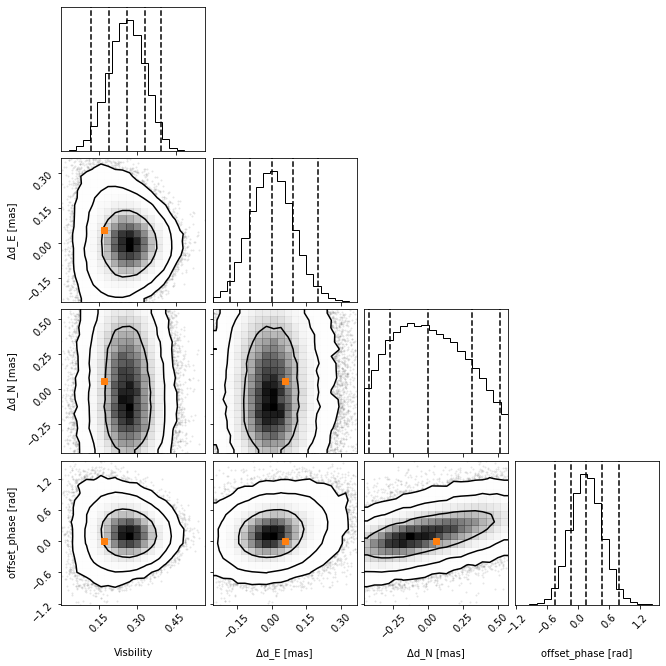

In [16]:
#loglike = 15
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_4.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_15as_mix_45',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.15083228644301022
Sigma ns from general formula = 0.25274661417664684
590004
Sigma from MCMC = [0.07326507 0.13119792 0.26967933 0.50441147]


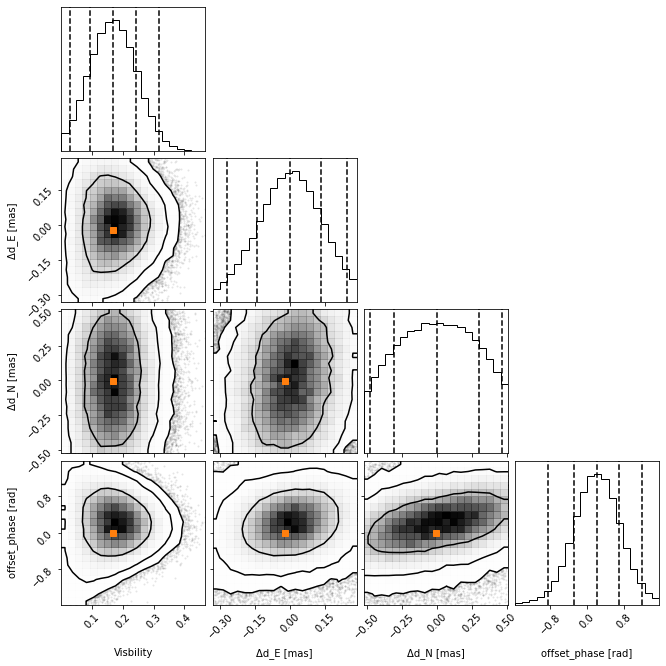

In [6]:
#loglike = 7.8
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/NS_15as_mix_4.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ns_15as_mix_40',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.31934981297157716
590004
Sigma from MCMC = [0.07656655 0.06749478 0.16605959 0.82431205]


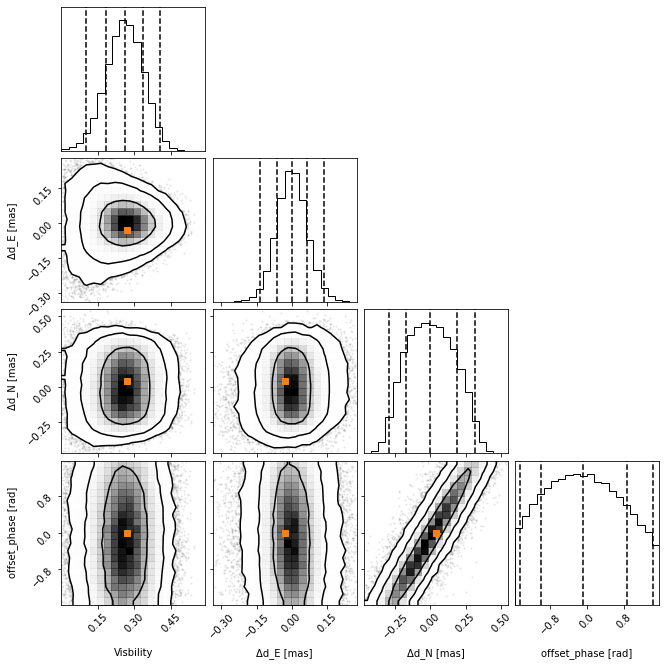

In [6]:
#loglike = 15
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_2.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_25',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.39918726621447137
590004
Sigma from MCMC = [0.09620346 0.08567016 0.16512905 0.8226467 ]


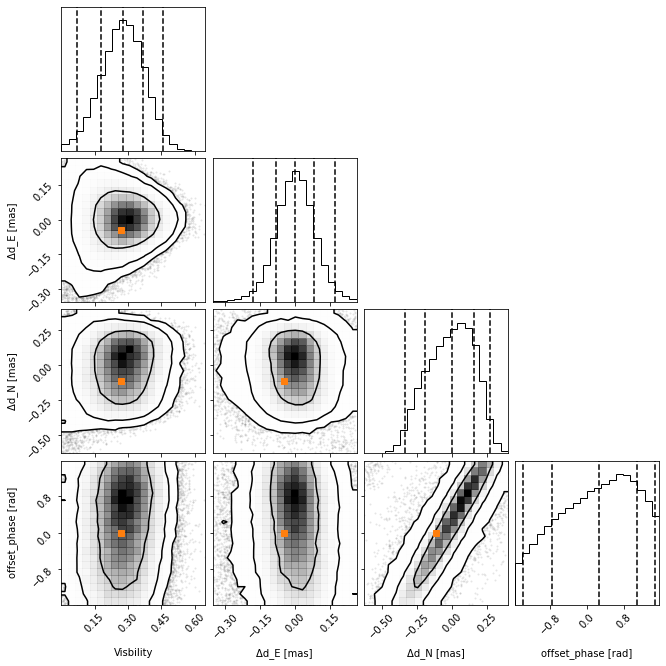

In [6]:
#loglike = 12
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_2.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_20',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.5322496882859619
590004
Sigma from MCMC = [0.1164405  0.1388104  0.20447197 0.82871942]


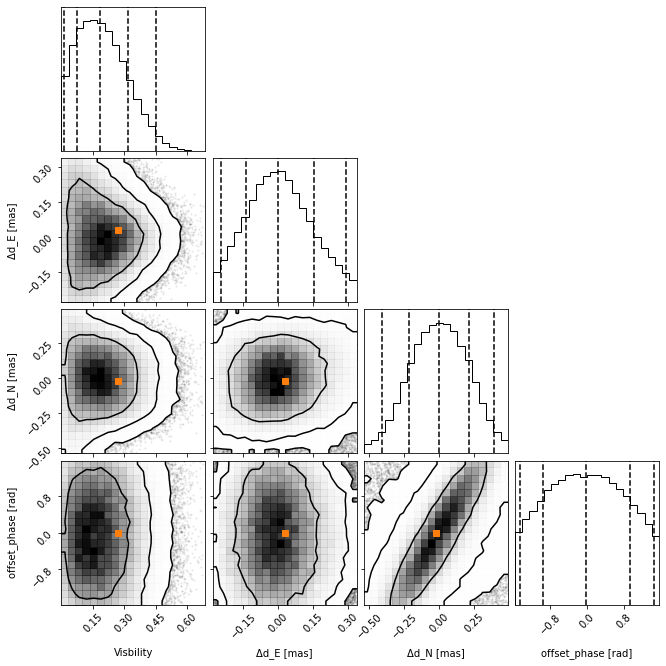

In [10]:
#loglike = 4.7
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_1as_mix_1.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_1as_mix_15',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.07868060703451824
Sigma ns from general formula = 0.13184350312723975
590004
Sigma from MCMC = [0.06503318 0.07648361 0.11987842 0.8301176 ]


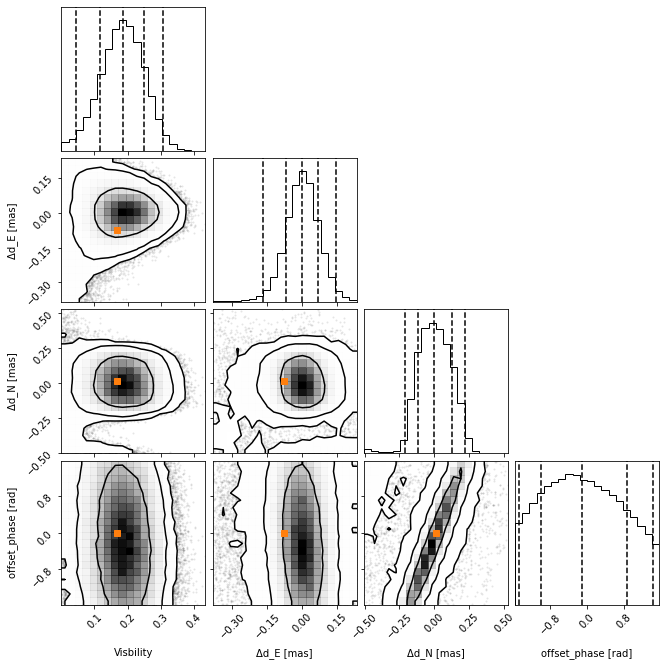

In [6]:
#loglike = 12
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_5.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_50',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08742289670501992
Sigma ns from general formula = 0.14649278125248807
590004
Sigma from MCMC = [0.06854497 0.08148445 0.10729986 0.83325612]


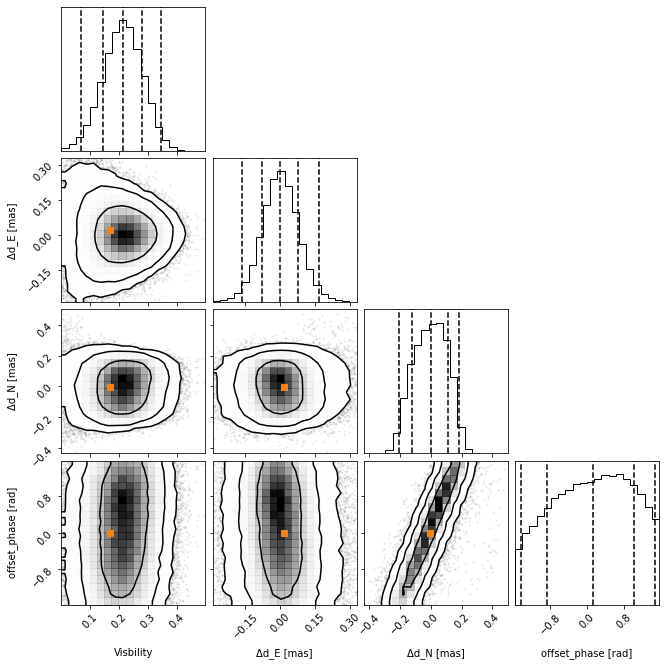

In [6]:
#loglike = 12
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_4.5.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_45',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0983507587931474
Sigma ns from general formula = 0.16480437890904906
590004
Sigma from MCMC = [0.07732805 0.12142782 0.15090019 0.83483828]


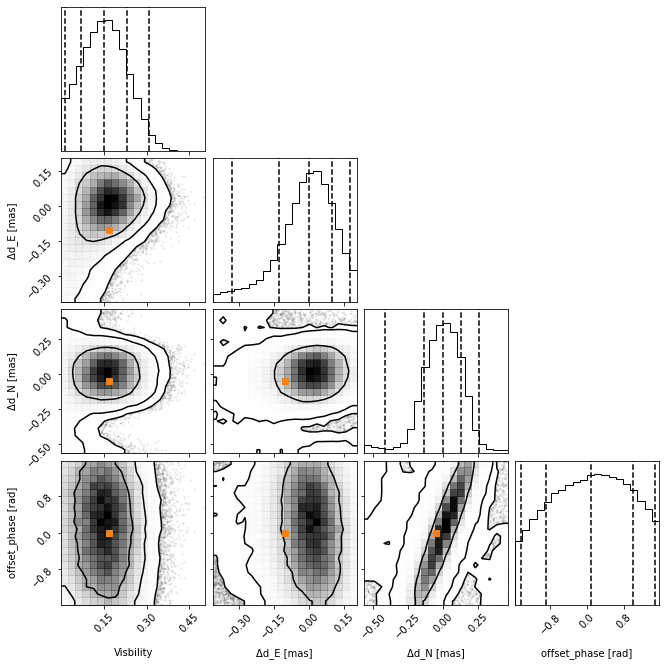

In [6]:
#loglike = 6
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_15as_mix_4.0.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9/np.sqrt(2.0))

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('ew_15as_mix_40',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.03562787733734065
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.02607363 0.03754013 0.27408814 0.15690903]


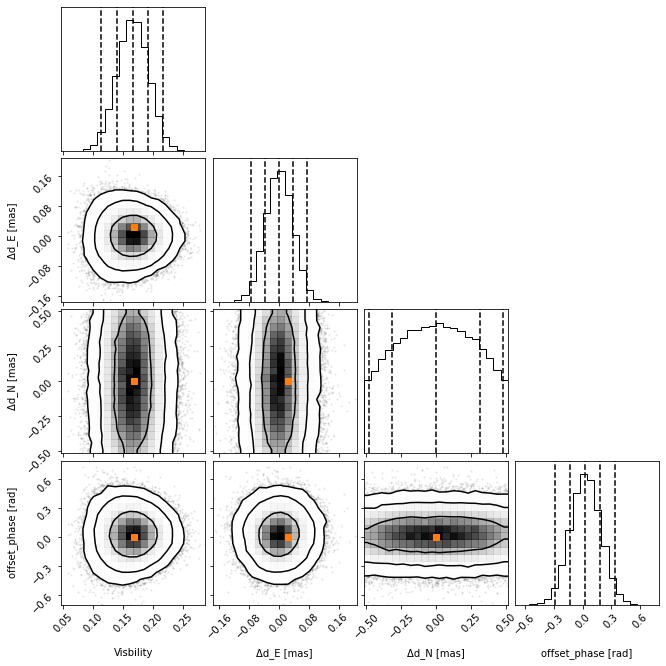

In [6]:
#loglike = 44
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_20x_mix.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_20x_mix',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.05038542732903219
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.03859044 0.05595424 0.27503603 0.2425303 ]


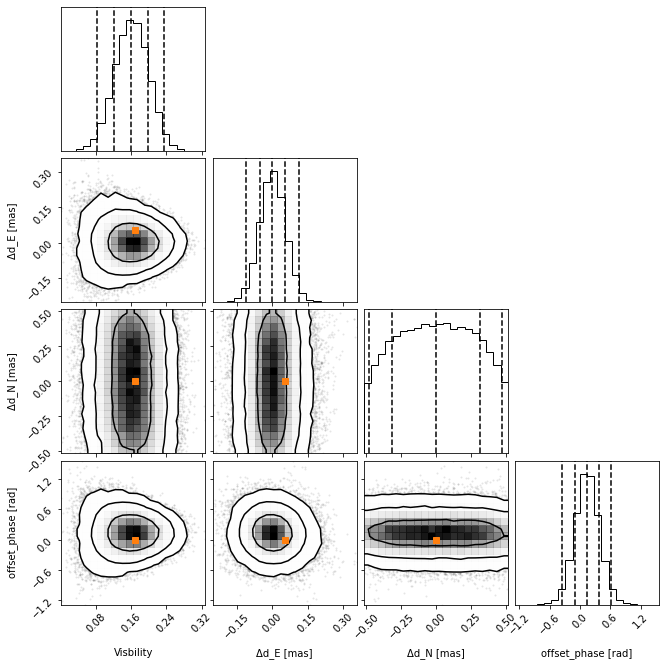

In [8]:
#loglike = 20
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_10x_mix.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_10x_mix',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.03149089208064511
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.02300646 0.03007887 0.2787179  0.1293198 ]


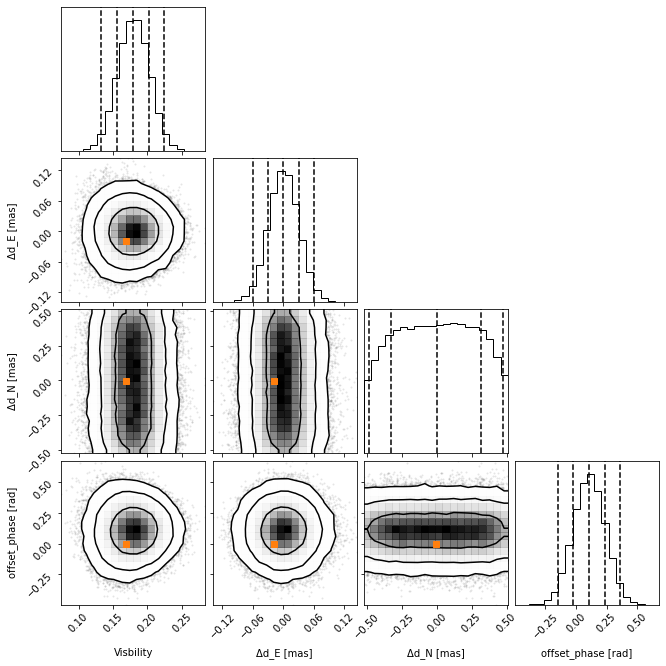

In [6]:
#loglike = 65
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_10x_mix_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_10x_mix_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0712557546746813
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.05733522 0.09011847 0.27932294 0.41805564]


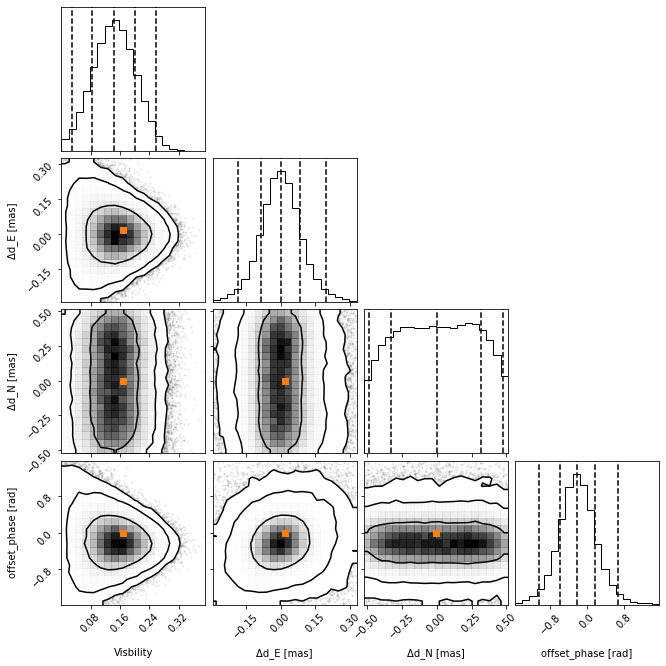

In [6]:
#loglike = 10
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_5x_mix.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_5x_mix',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.044534846671675815
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.03313055 0.04679921 0.27980872 0.1969309 ]


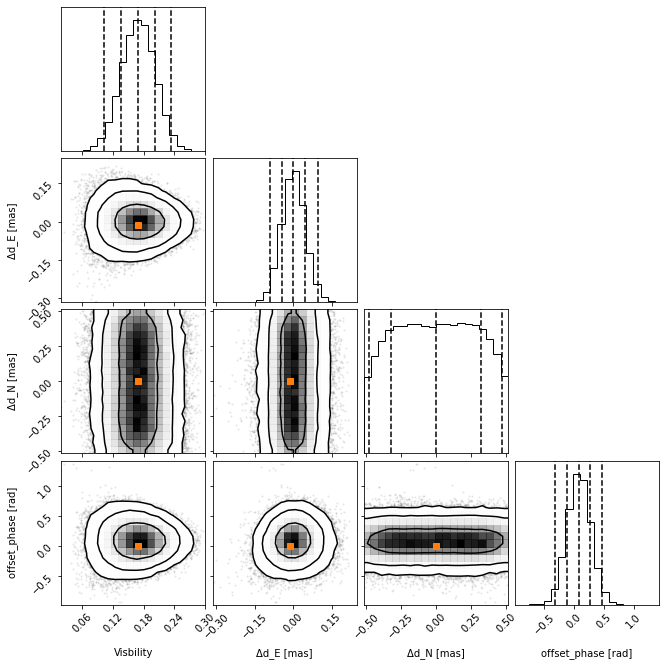

In [6]:
#loglike = 29
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_5x_mix_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_5x_mix_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.091990783725494
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.06510807 0.12570532 0.27917901 0.52419622]


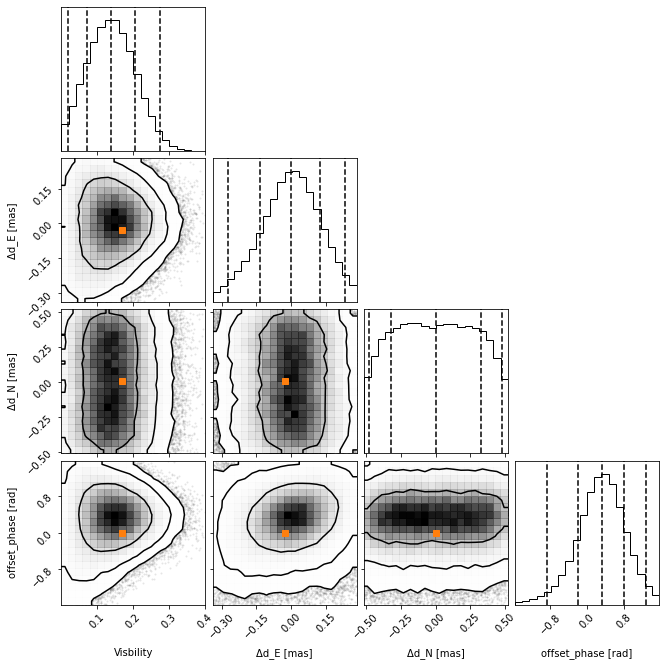

In [7]:
#loglike = 6
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_3x_mix.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_3x_mix',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.05749423982843375
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.04297449 0.06617753 0.27537735 0.25693324]


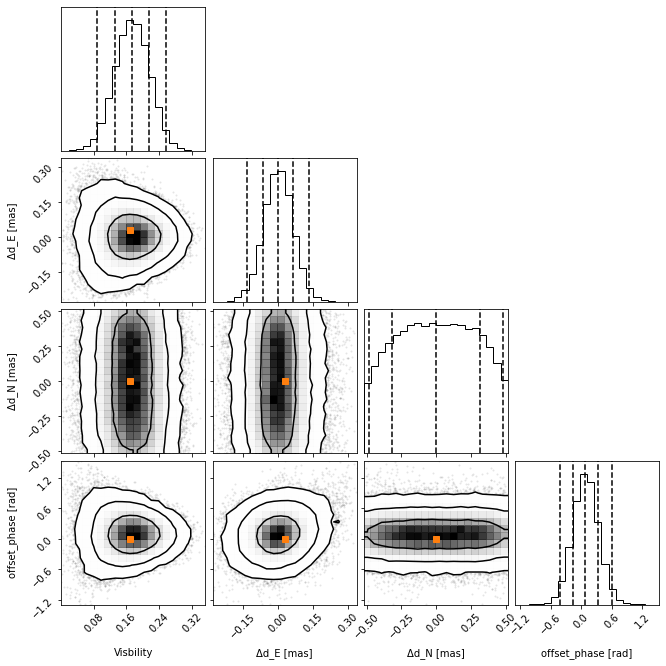

In [7]:
#loglike = ~19
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_3x_mix_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_3x_mix_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.07041577536443226
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.05462446 0.08591801 0.27722822 0.37564502]


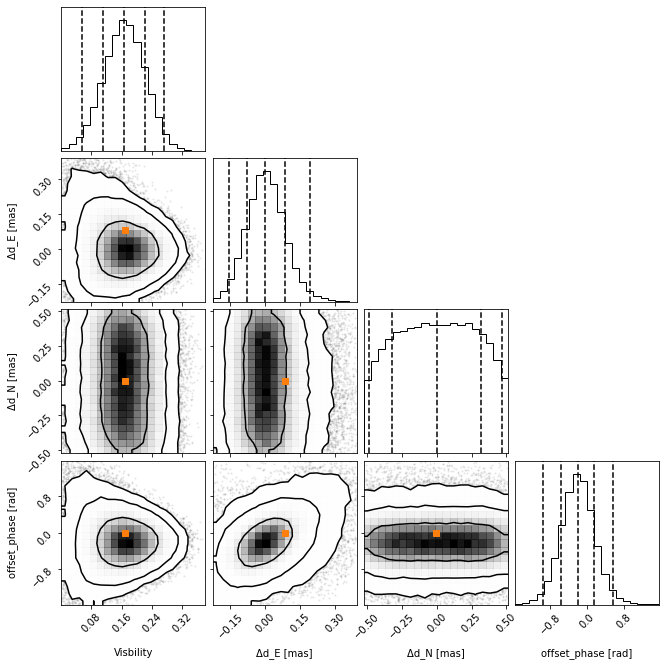

In [6]:
#loglike = ~19
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_2x_mix_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_2x_mix_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.09958294452539737
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.06531754 0.12531401 0.27413372 0.64037809]


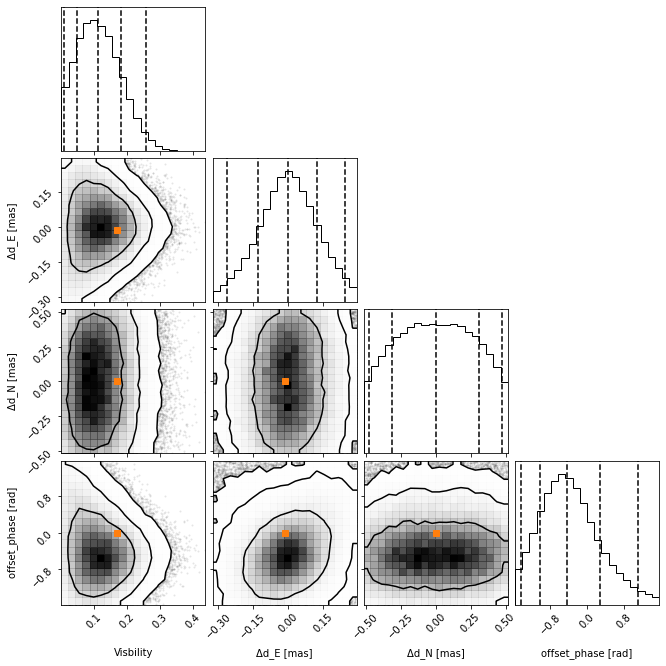

In [6]:
#loglike = 3, A=4.0
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_1x_mix.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_1x_mix',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.09958294452539737
Sigma ns from general formula = 0.0
590004
Sigma from MCMC = [0.06583765 0.15080801 0.27460658 0.76212231]


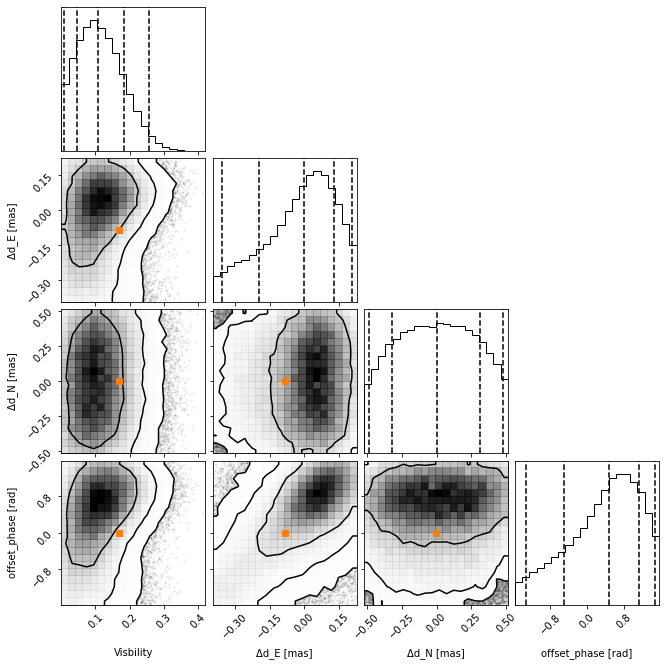

In [6]:
#loglike = 0.6, A=4.0
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_1x_mix_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-posData.V**2))/posData.V**2

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[1]/posData.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/posData.V/np.sqrt(2*T[1]*posData.avg_rate)*theo_par[2]/posData.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9/np.sqrt(2.0))
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_E [mas]','Δd_N [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_1x_mix_1',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.2931775766442095
590004
Sigma from MCMC = [0.08296743 0.08927449 0.19130332 0.81816617]


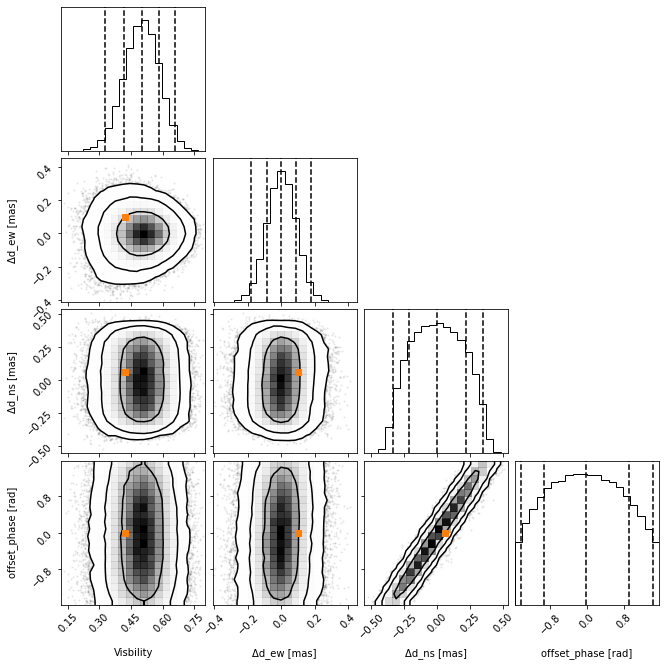

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.5_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_15_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.43976636496631416
590004
Sigma from MCMC = [0.12496356 0.14731573 0.21204928 0.82774655]


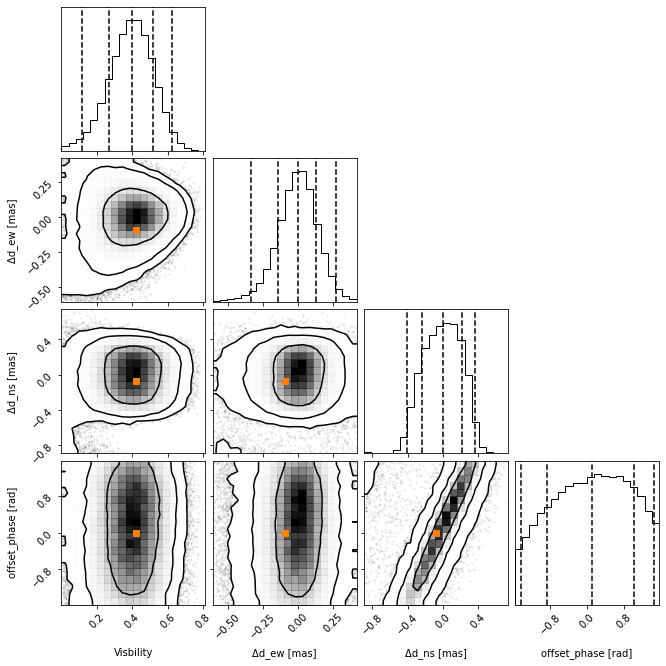

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.0_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_10_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.5497079562078927
590004
Sigma from MCMC = [0.15696921 0.21355501 0.22262877 0.83340007]


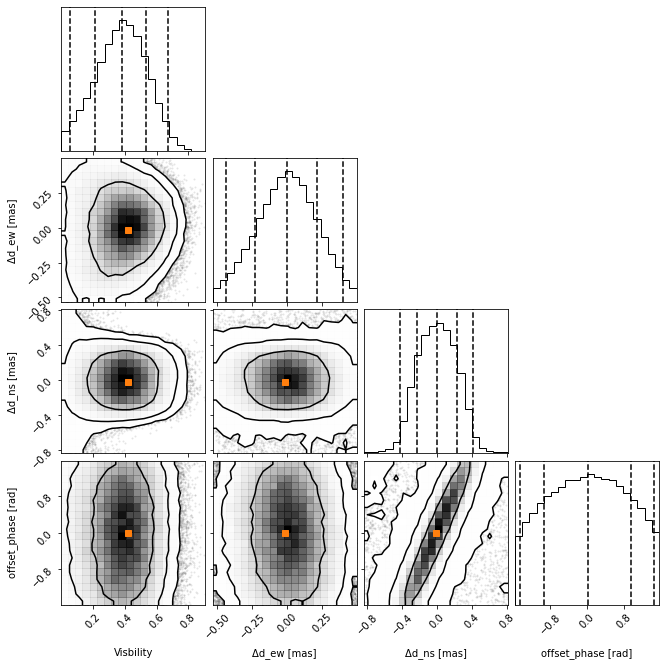

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_0.8_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_08_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.13076399113627243
Sigma ns from general formula = 0.15386504894226385
590004
Sigma from MCMC = [0.08279706 0.1163629  0.28762654 0.81455   ]


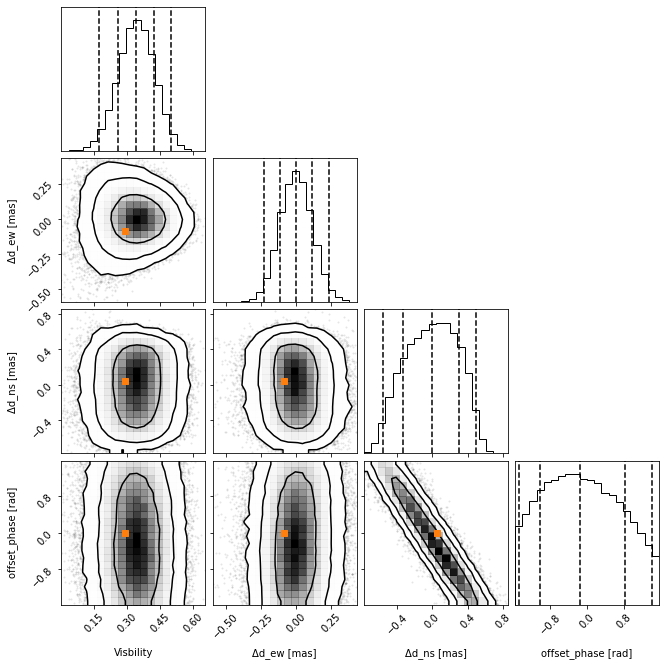

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.5_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_25_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.16345498892034055
Sigma ns from general formula = 0.19233131117782978
590004
Sigma from MCMC = [0.10458417 0.14853447 0.30392821 0.82054498]


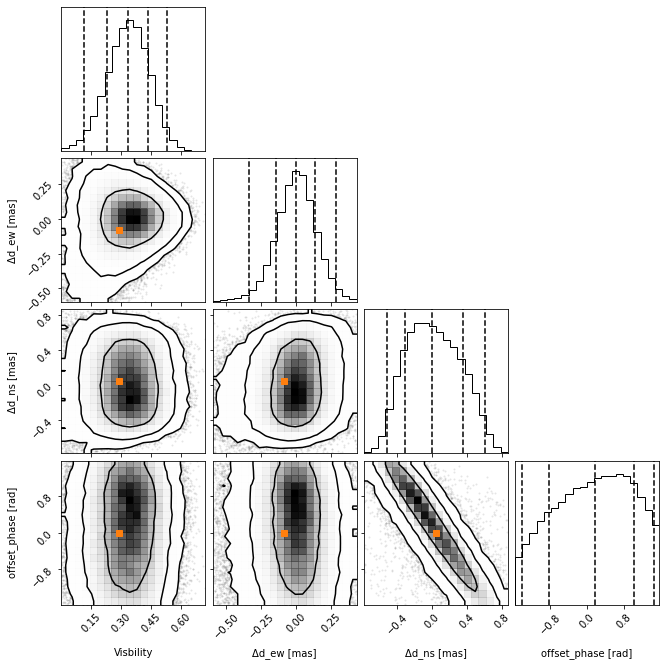

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.0_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_20_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.19229998696510656
Sigma ns from general formula = 0.22627213079744687
590004
Sigma from MCMC = [0.1215598  0.21769612 0.31440262 0.83251851]


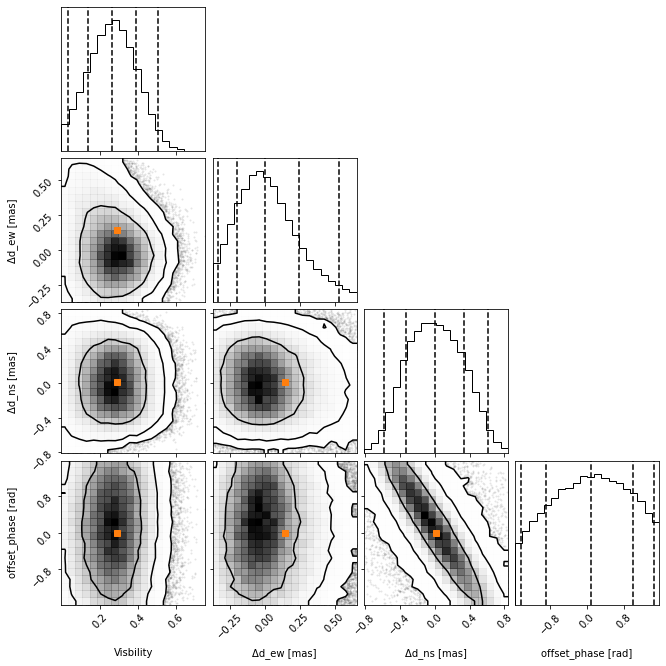

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_1.7_100_ew+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_17_100_ew_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08619969734096014
Sigma ns from general formula = 0.10142792778818847
590004
Sigma from MCMC = [0.08277263 0.07841546 0.08329821 0.83247693]


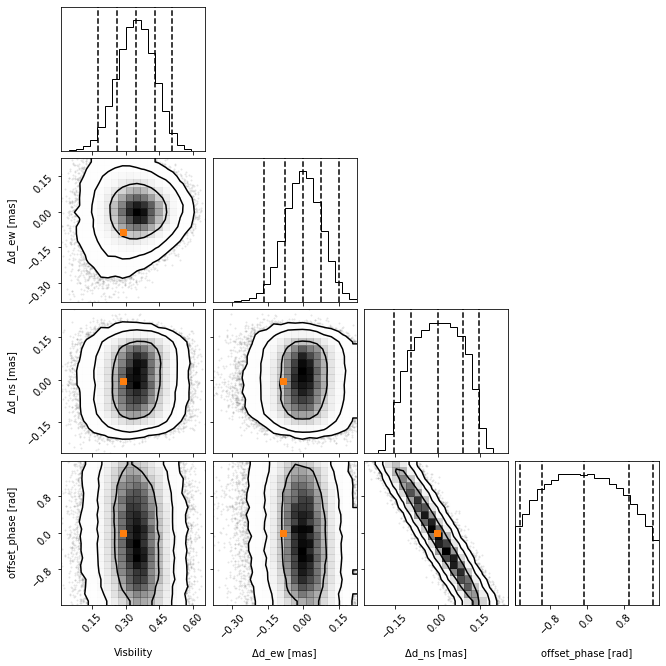

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.5_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_25_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.10774962167620017
Sigma ns from general formula = 0.12678490973523557
590004
Sigma from MCMC = [0.09956142 0.08919694 0.08572353 0.84051481]


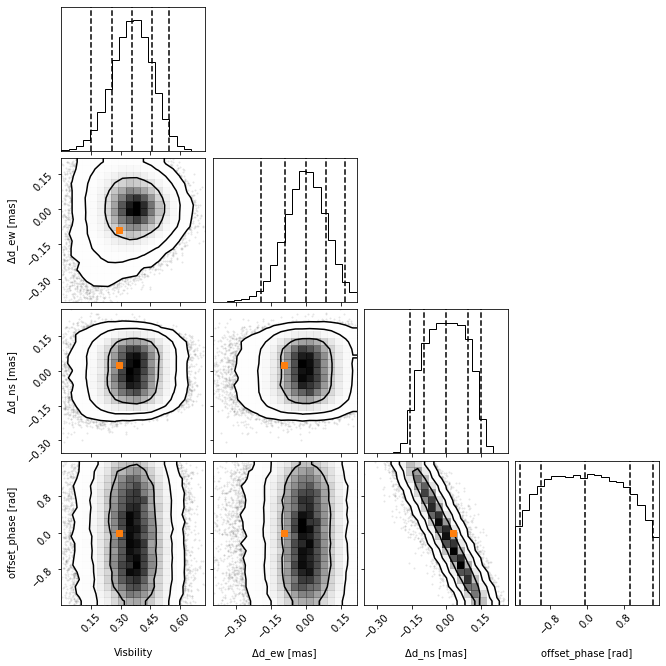

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.0_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_20_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.12676426079552963
Sigma ns from general formula = 0.1491587173355713
590004
Sigma from MCMC = [0.11529359 0.13483855 0.12497012 0.84947658]


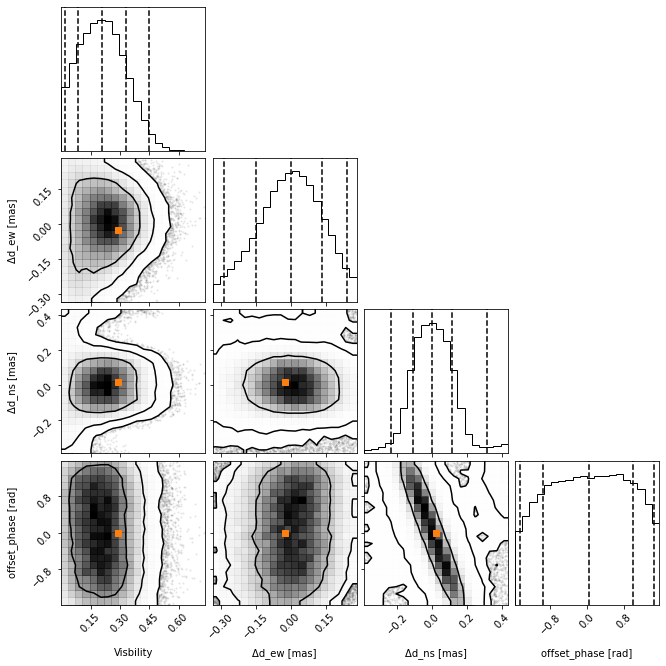

In [14]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_1.7_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_17_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.19291995976069748
590004
Sigma from MCMC = [0.0856531  0.05955422 0.08279736 0.83403922]


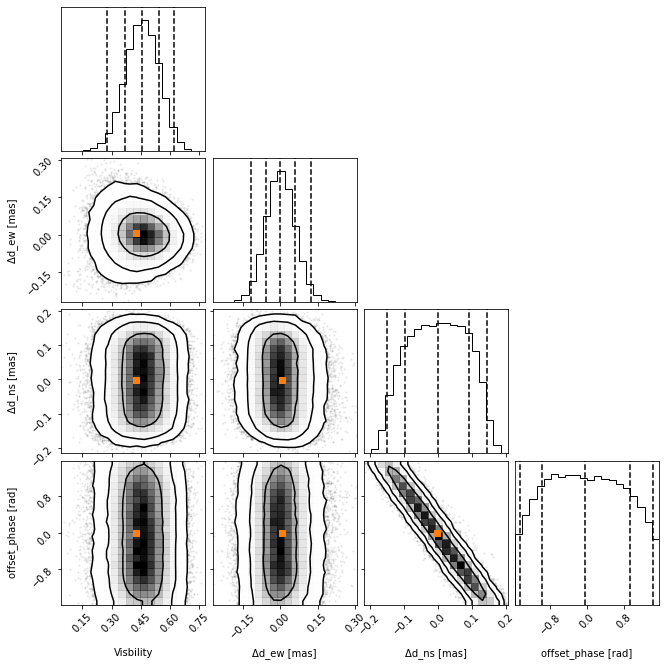

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.5_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_15_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.2893799396410462
590004
Sigma from MCMC = [0.12075911 0.07011461 0.08302935 0.82012887]


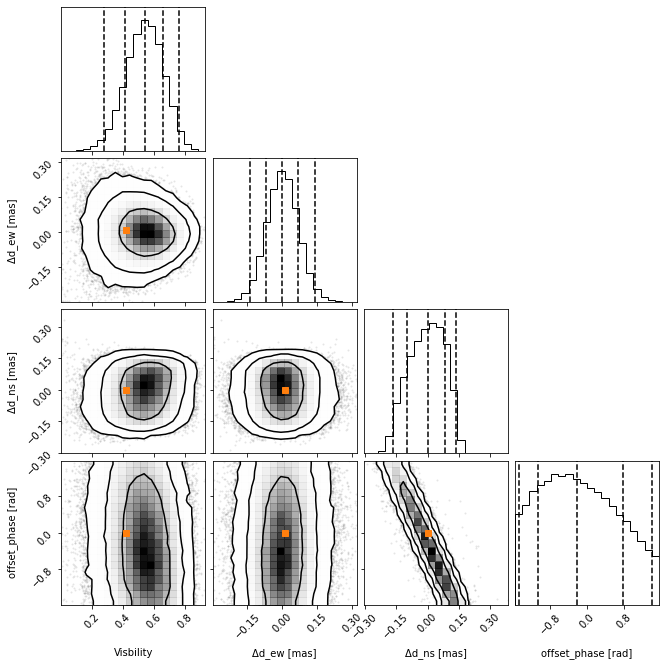

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.0_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_10_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.3617249245513078
590004
Sigma from MCMC = [0.14718348 0.11001287 0.09311626 0.84487796]


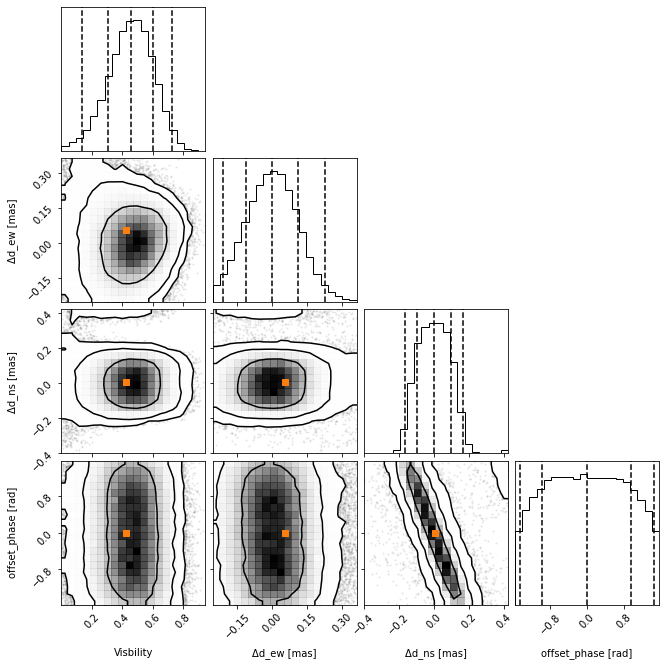

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_0.8_ns+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_08_ns_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.14678141485078033
590004
Sigma from MCMC = [0.08938568 0.06200265 0.099708   0.82681808]


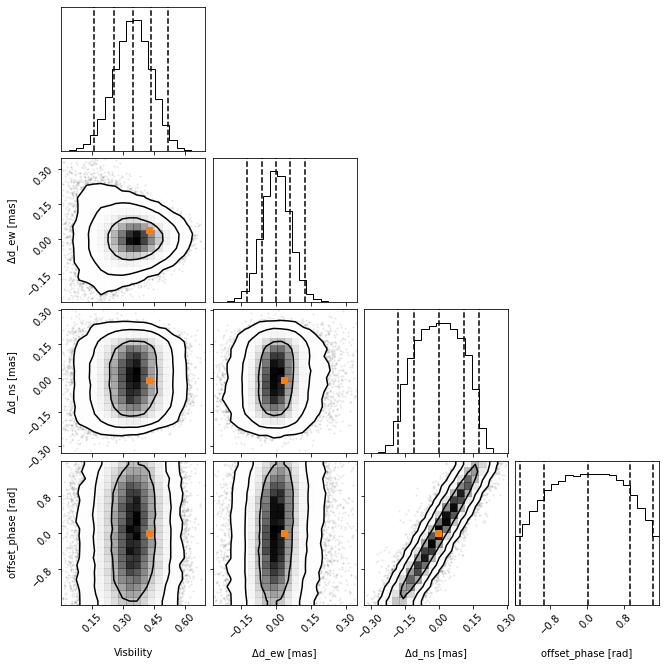

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.5_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_15_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.2201721222761705
590004
Sigma from MCMC = [0.12921128 0.07747118 0.11775697 0.82888213]


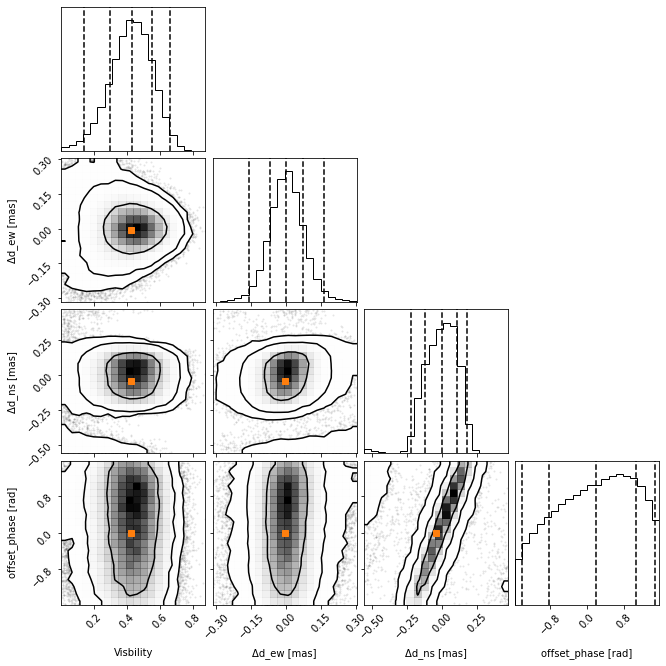

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.0_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_10_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.27521515284521314
590004
Sigma from MCMC = [0.17188979 0.10865715 0.12512436 0.8383955 ]


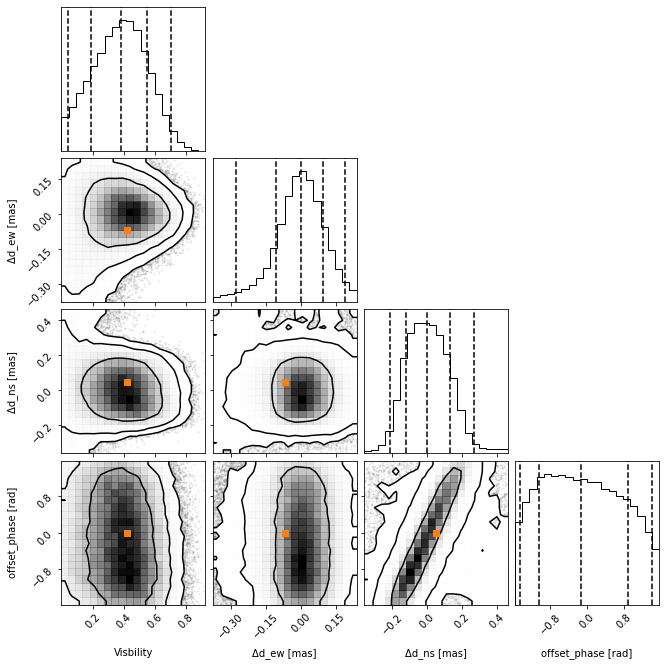

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_0.8_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_08_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.06538199556813622
Sigma ns from general formula = 0.07693252447113193
590004
Sigma from MCMC = [0.08768032 0.07290911 0.14680104 0.82831009]


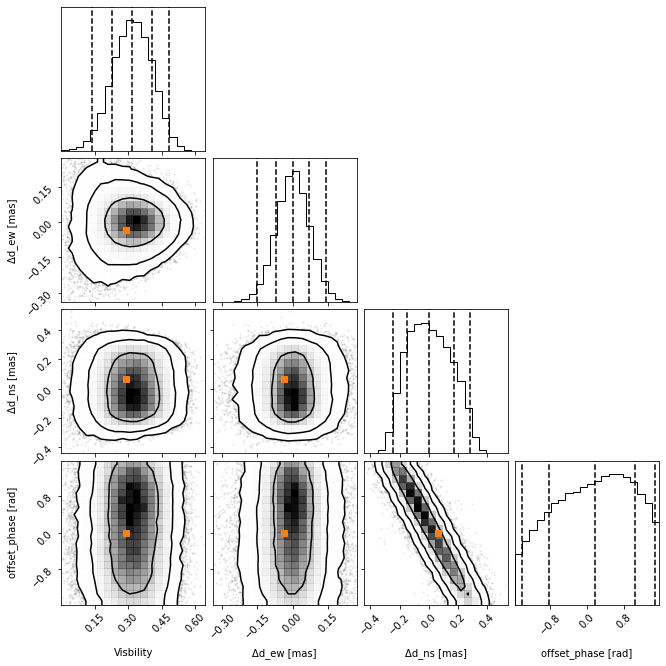

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.5_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_25_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08172749446017027
Sigma ns from general formula = 0.09616565558891489
590004
Sigma from MCMC = [0.1112252  0.08737486 0.15292551 0.82768126]


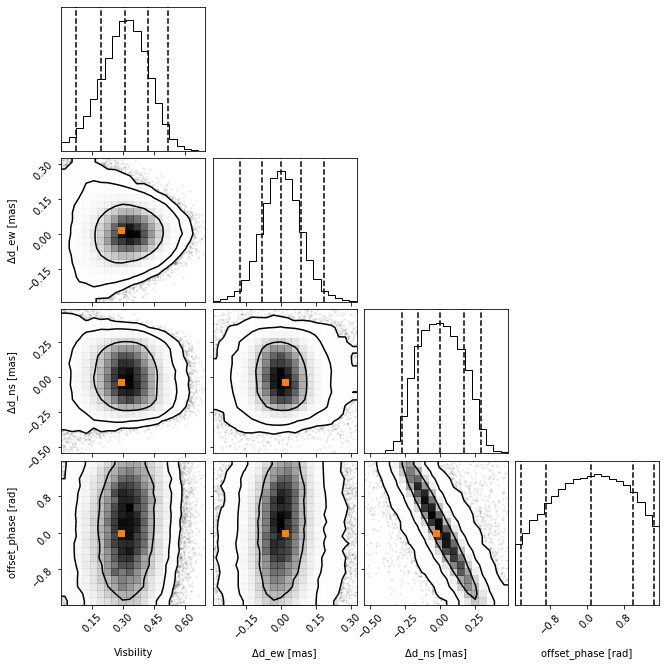

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.0_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_20_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.09614999348255328
Sigma ns from general formula = 0.11313606539872344
590004
Sigma from MCMC = [0.11838124 0.1170512  0.19132601 0.84129706]


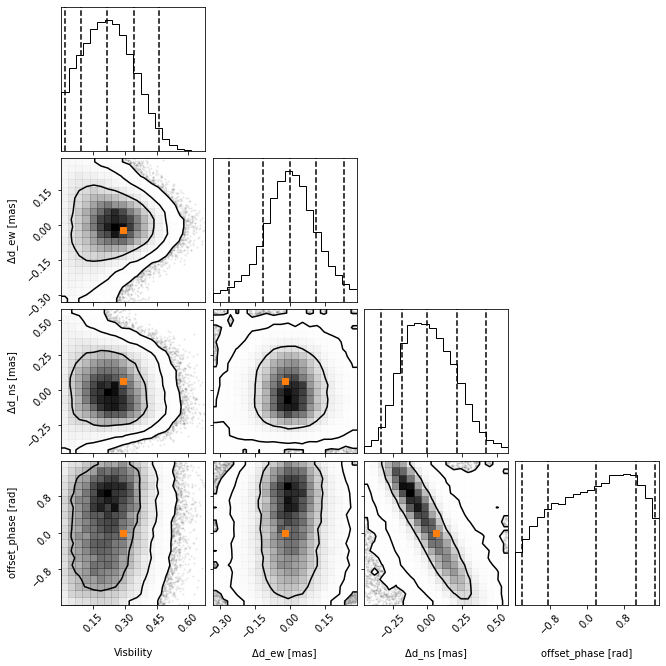

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_1.7_-.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_17_minus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.1463966667122462
590004
Sigma from MCMC = [0.07967844 0.04394269 0.09692106 0.81366893]


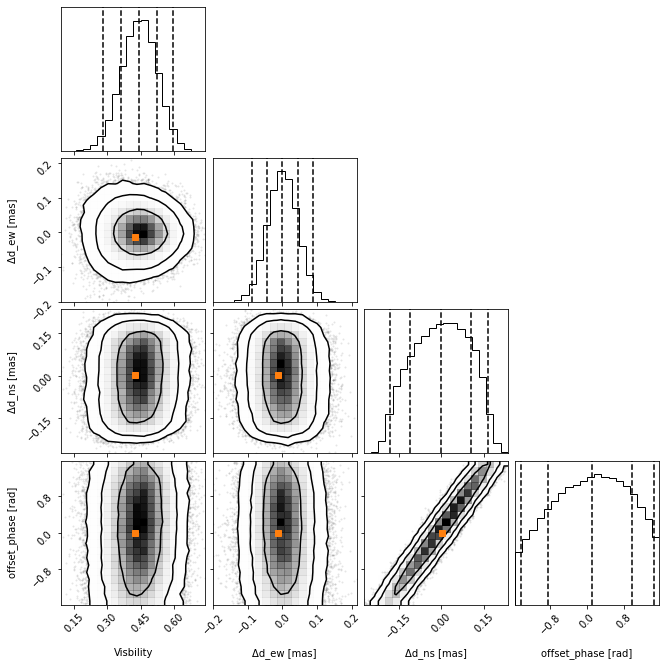

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.5_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_15_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.21959500006836927
590004
Sigma from MCMC = [0.12221271 0.0542023  0.09937851 0.82001478]


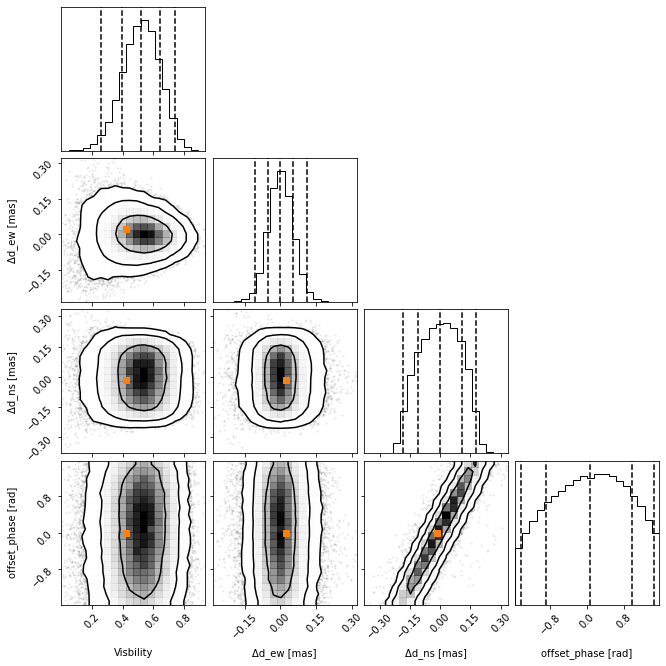

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_1.0_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_10_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.2744937500854616
590004
Sigma from MCMC = [0.16270984 0.11518372 0.12265901 0.84752271]


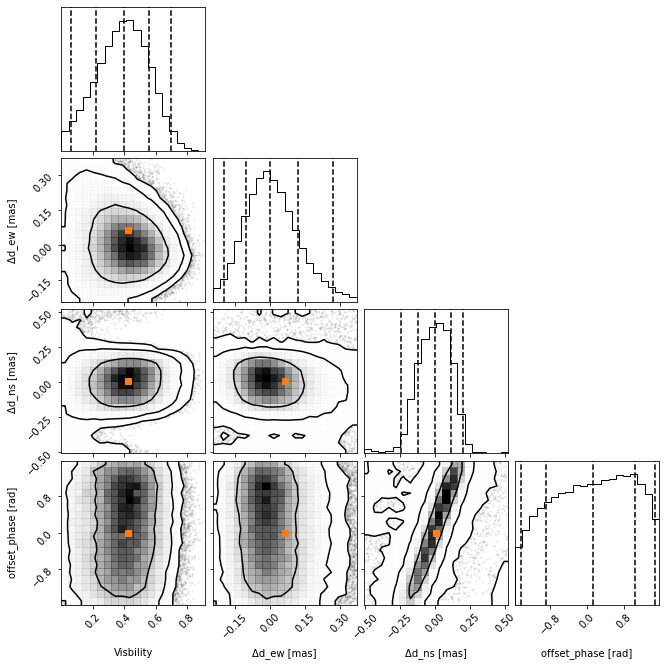

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1as_0.8_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1as_08_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.06538451442607698
Sigma ns from general formula = 0.07693548831612446
590004
Sigma from MCMC = [0.08369308 0.07334954 0.15034282 0.84108407]


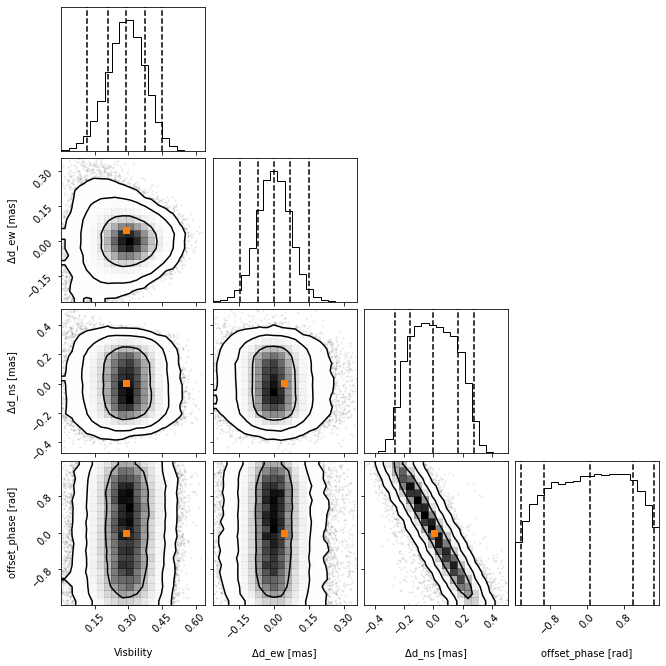

In [5]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.5_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_25_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.08173064303259622
Sigma ns from general formula = 0.09616936039515557
590004
Sigma from MCMC = [0.10639229 0.09613442 0.15817363 0.83041629]


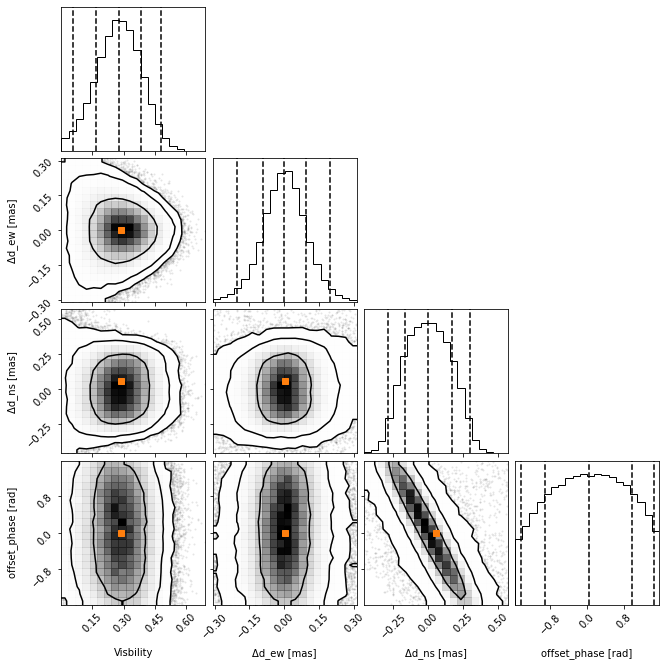

In [5]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_2.0_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_20_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.09615369768540734
Sigma ns from general formula = 0.1131404239943007
590004
Sigma from MCMC = [0.12138125 0.10482202 0.16807079 0.83391805]


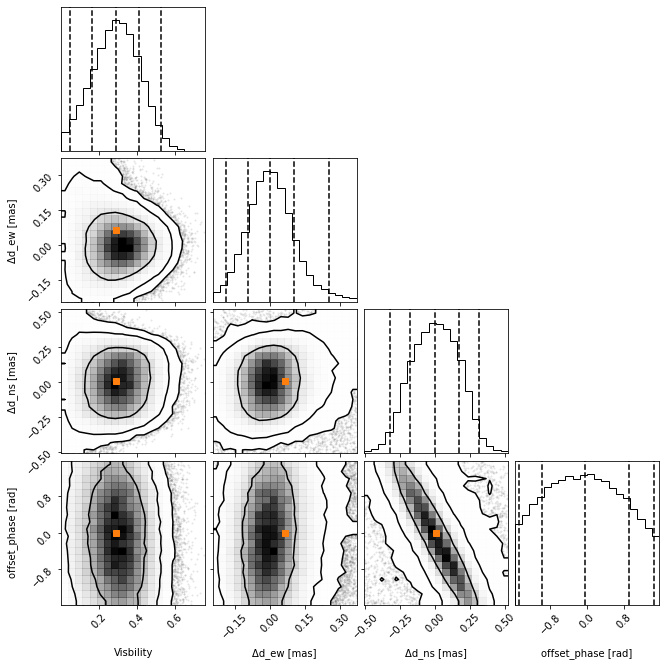

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15as_1.7_+.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15as_17_plus',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

590004
Sigma from MCMC = [1.48905287e-01 7.49957219e-10 1.36281170e-09 7.15430809e-01]
Sigma ew from general formula = 7.92541087891942e-10
Sigma ns from general formula = 0.0


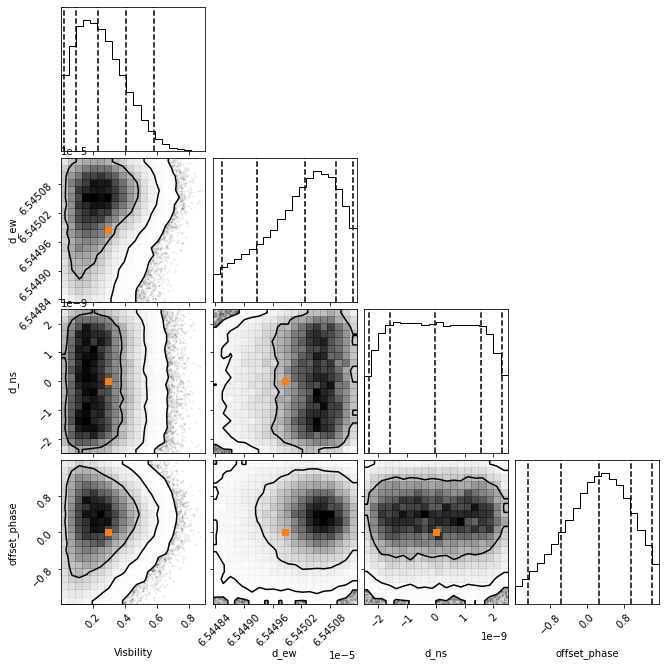

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_v_1x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [9.10859384e-02 4.01586174e-10 1.34310856e-09 3.61445178e-01]
Sigma ew from general formula = 3.544351494976036e-10
Sigma ns from general formula = 0.0


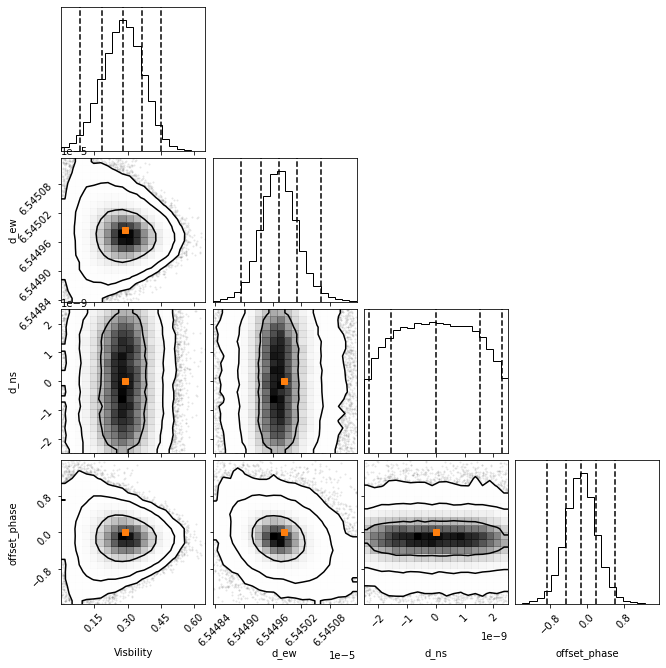

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_v_5x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [6.37035145e-02 2.38661901e-10 1.33191755e-09 2.07531569e-01]
Sigma ew from general formula = 2.506234977006232e-10
Sigma ns from general formula = 0.0


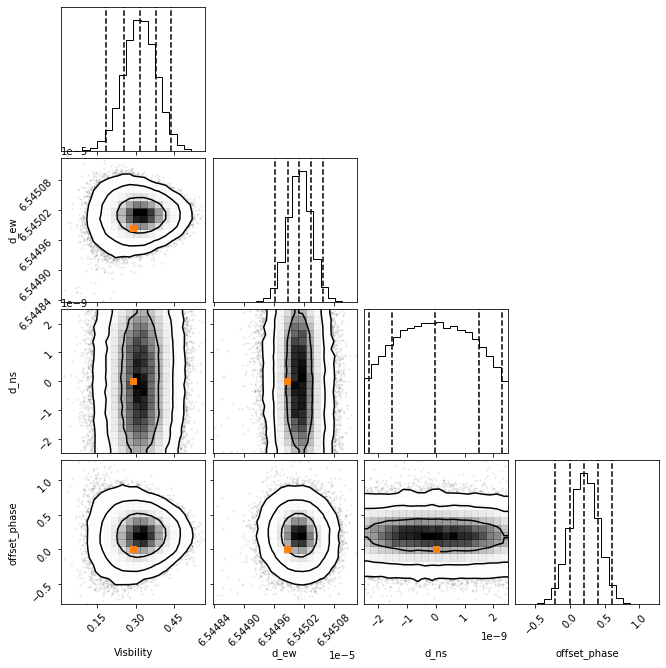

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_v_10x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [6.27605437e-02 1.60652149e-10 7.21026741e-10 7.90348170e-01]
Sigma ew from general formula = 2.506234977006232e-10
Sigma ns from general formula = 0.0


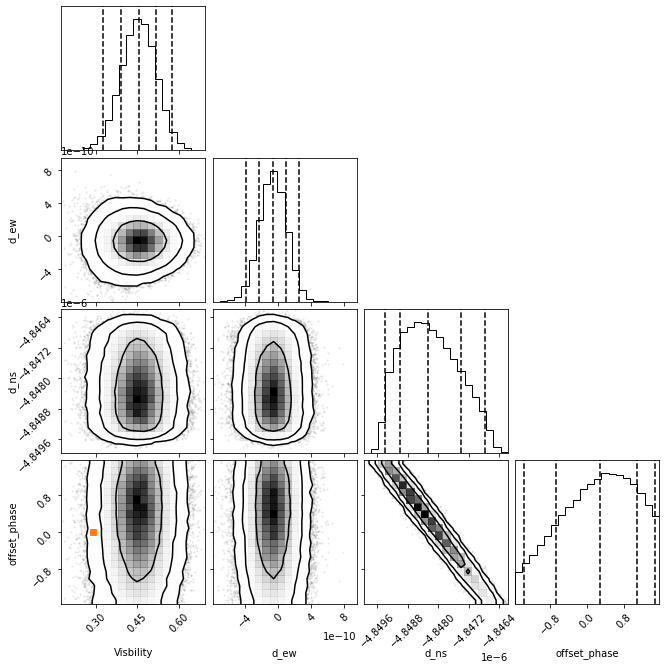

In [12]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_2.0m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 2.3565539388490263e-10
590004
Sigma from MCMC = [8.76503569e-02 5.17068673e-11 1.60107819e-10 8.28840495e-01]


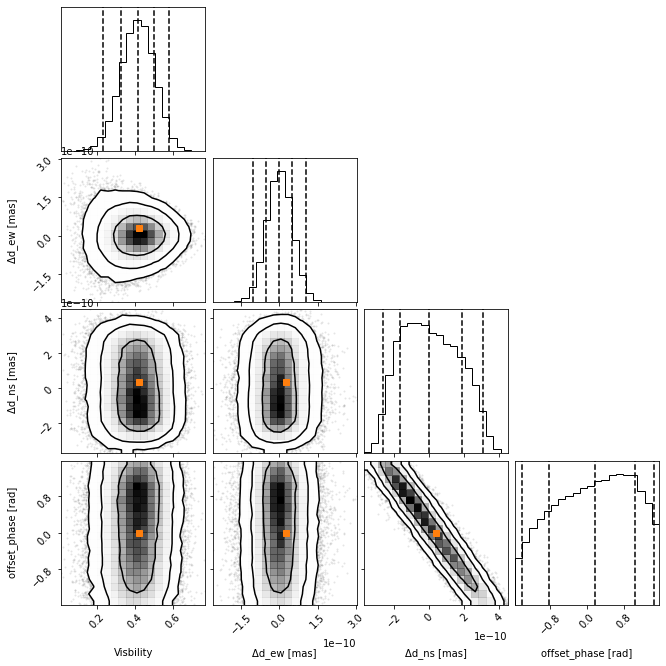

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_1.5m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1arcsec_15m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 3.534830908273539e-10
590004
Sigma from MCMC = [1.36290581e-01 8.67422414e-11 1.60919633e-10 8.19974920e-01]


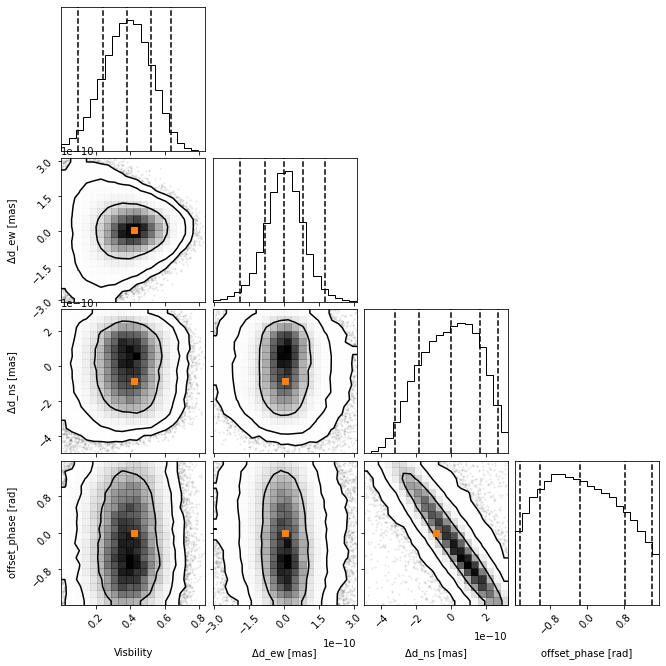

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_1.0m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1arcsec_10m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.0
Sigma ns from general formula = 0.4418538635341924
590004
Sigma from MCMC = [0.15668704 0.12435051 0.17387166 0.84722937]


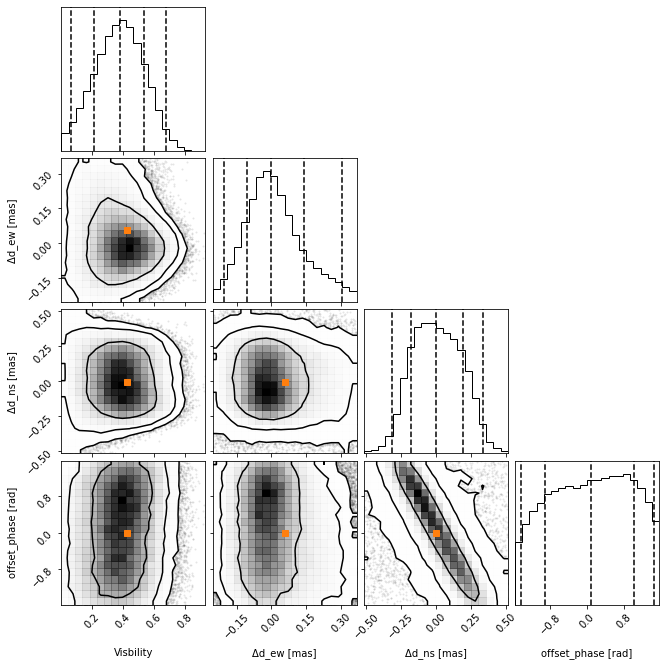

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.8m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('1arcsec_08m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

590004
Sigma from MCMC = [2.14338369e-01 6.55362934e-10 9.21956930e-10 8.34156039e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 3.4274687616356738e-09


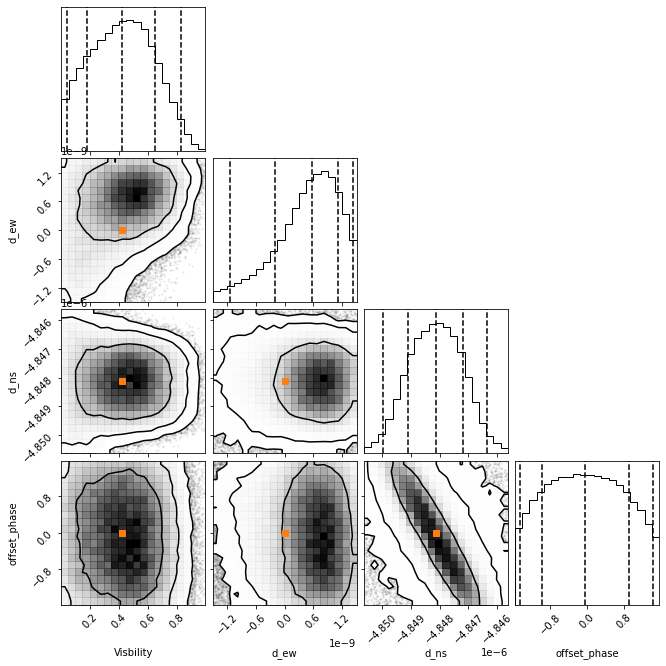

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.5m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [6.75192405e-02 2.50125595e-10 4.94462425e-10 8.15802415e-01]
Sigma ew from general formula = 2.6093981710685356e-10
Sigma ns from general formula = 4.3725157811321495e-10


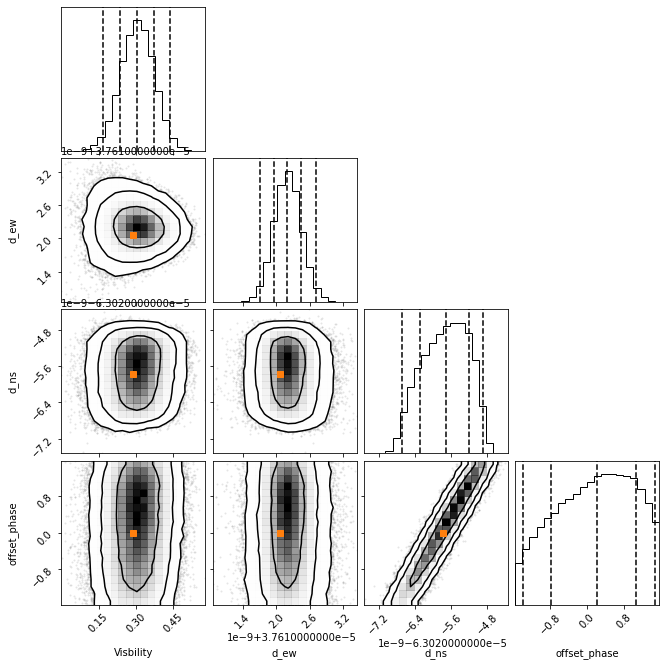

In [11]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_3.0m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

Sigma ew from general formula = 6.458724112905069e-11
Sigma ns from general formula = 1.082275346965989e-10
590004
Sigma from MCMC = [8.41166230e-02 7.57285457e-11 1.03935197e-10 8.27339955e-01]


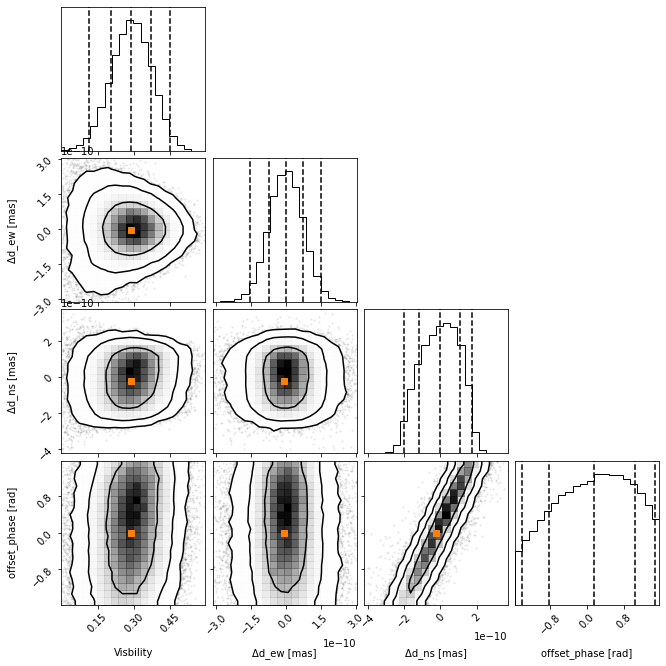

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_2.5m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15arcsec_25m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)


Sigma ew from general formula = 8.073405141131337e-11
Sigma ns from general formula = 1.352844183707486e-10
590004
Sigma from MCMC = [1.07058397e-01 9.96848792e-11 1.17130715e-10 8.28728185e-01]


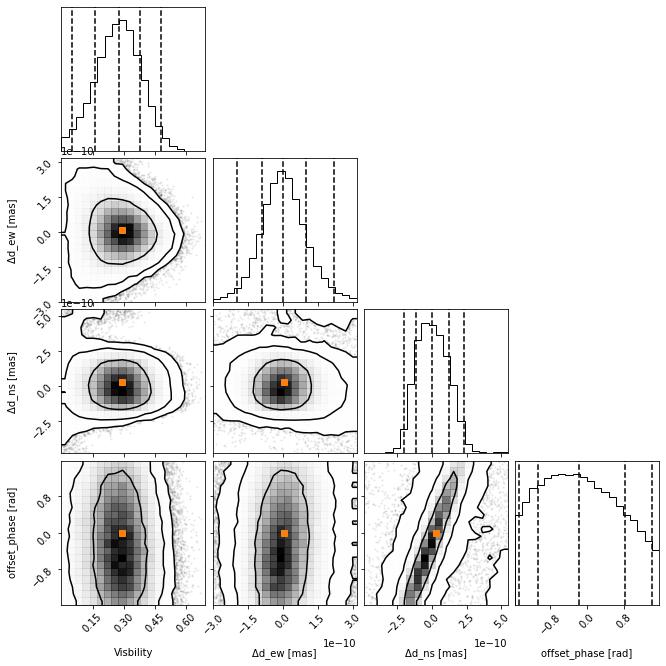

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_2.0m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15arcsec_20m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

Sigma ew from general formula = 0.09498123695448632
Sigma ns from general formula = 0.15915813925970426
590004
Sigma from MCMC = [0.1201444  0.11394508 0.12403706 0.84063818]


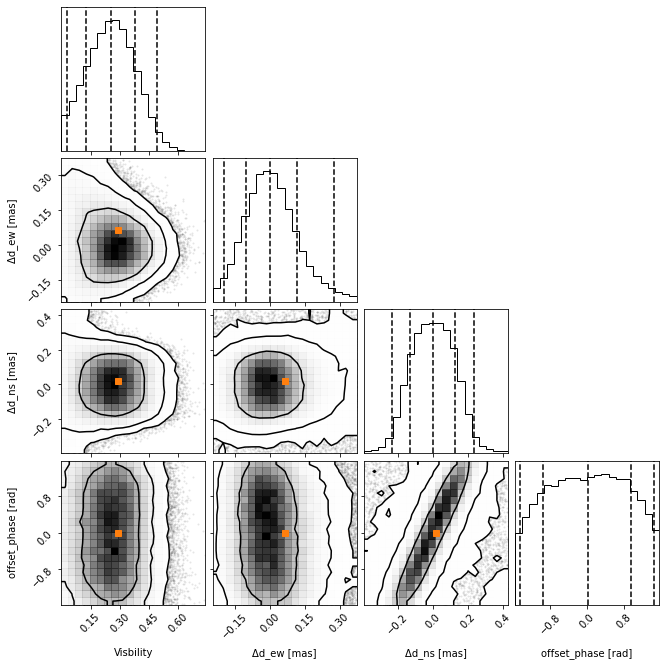

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_1.7m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew/4.8481368e-9)
print("Sigma ns from general formula =", theo_sigma_ns/4.8481368e-9)

# Find center point of d_ew and d_ns
d_ew_mid = corner.quantile(mcmc_data[:,1],0.5)
d_ns_mid = corner.quantile(mcmc_data[:,2],0.5)

mcmc_data[:,1] = (mcmc_data[:,1] - d_ew_mid)/4.8481368e-9
mcmc_data[:,2] = (mcmc_data[:,2] - d_ns_mid)/4.8481368e-9

theo_par[1] = (theo_par[1] - d_ew_mid)/4.8481368e-9
theo_par[2] = (theo_par[2] - d_ns_mid)/4.8481368e-9

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','Δd_ew [mas]','Δd_ns [mas]','offset_phase [rad]'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(list(theo_par))[None], marker="s", color="C1",label="Theo")
figure.savefig('15arcsec_17m',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

590004
Sigma from MCMC = [9.74733069e-02 7.55856970e-10 8.47092177e-10 8.37644145e-01]
Sigma ew from general formula = 5.218796342137071e-10
Sigma ns from general formula = 8.745031562264299e-10


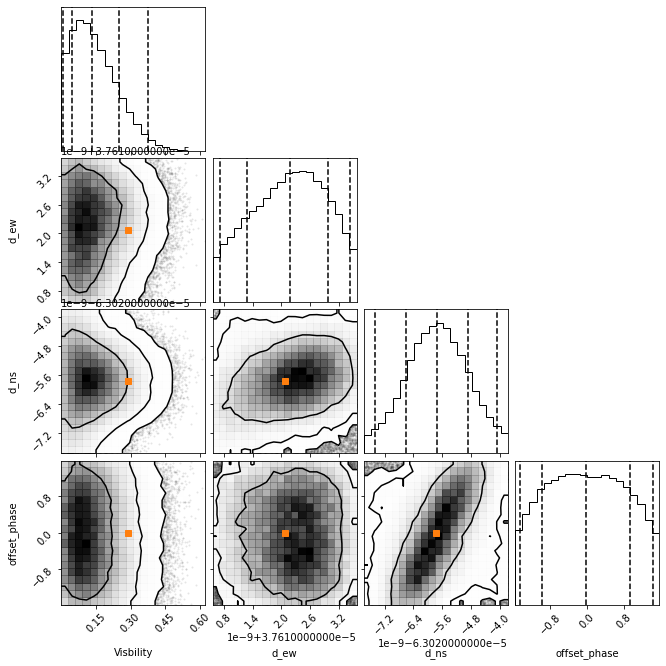

In [14]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_1.5m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.37354417e-01 7.89759648e-10 6.94878605e-10 8.29429292e-01]
Sigma ew from general formula = 7.828194513205606e-10
Sigma ns from general formula = 1.3117547343396448e-09


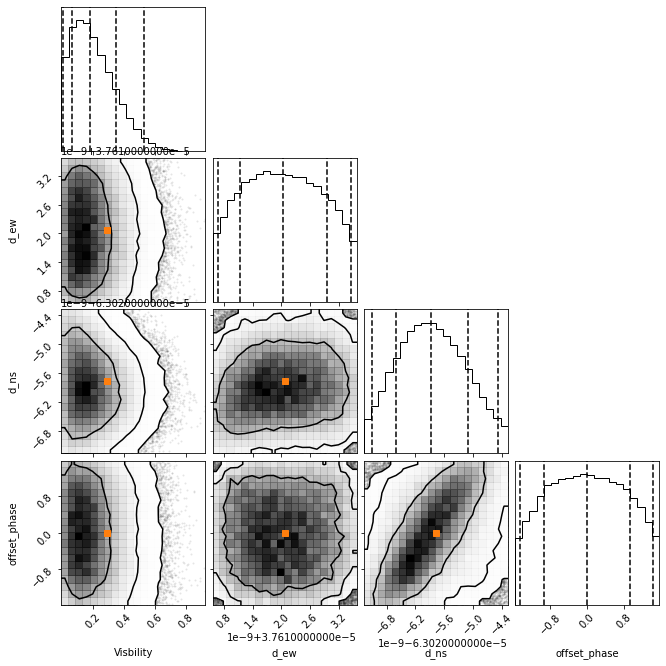

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_1.0m_v.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.10098094e-01 7.58403119e-10 1.00869939e-09 8.40638993e-01]
Sigma ew from general formula = 7.827885982532113e-10
Sigma ns from general formula = 1.3117030344782067e-09


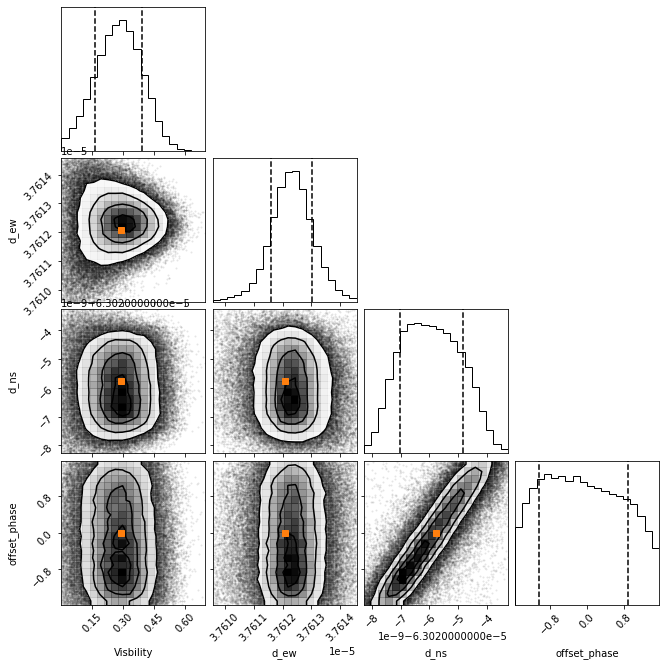

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_1.0m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.37862170e-01 1.10458832e-09 1.00428144e-09 8.28586343e-01]
Sigma ew from general formula = 9.78485747816514e-10
Sigma ns from general formula = 1.6396287930977581e-09


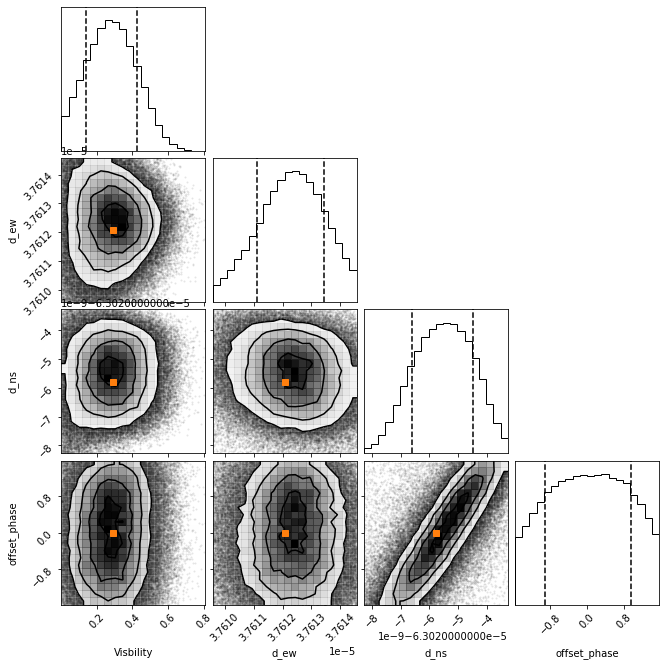

In [11]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_0.8m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.71499086e-01 9.68420256e-10 1.07850561e-09 8.19797344e-01]
Sigma ew from general formula = 1.204290151158787e-09
Sigma ns from general formula = 2.018004668428011e-09


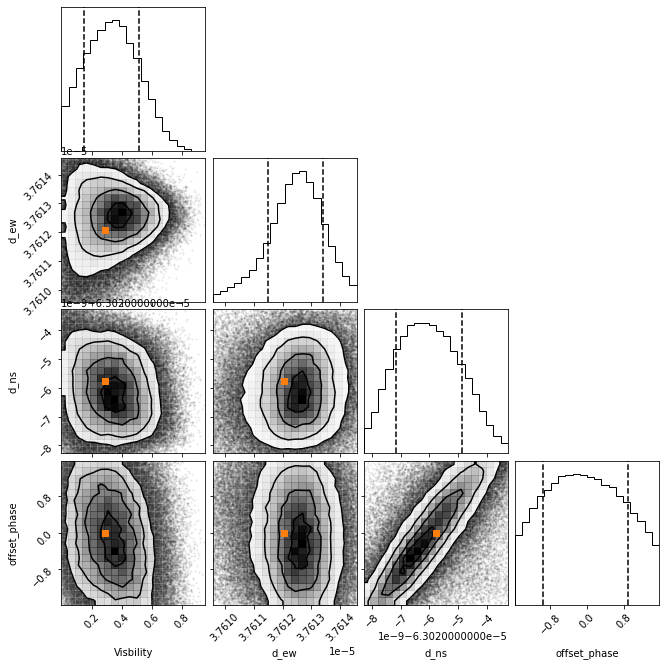

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_0.7m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.65974941e-01 1.13987245e-09 1.06789688e-09 8.26783745e-01]
Sigma ew from general formula = 1.3046476637553526e-09
Sigma ns from general formula = 2.1861717241303456e-09


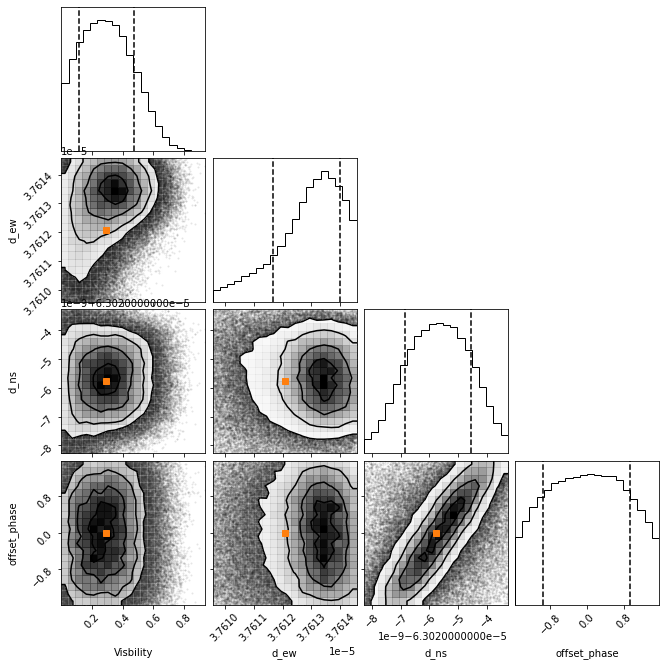

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_0.6m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.80308546e-01 1.16030717e-09 1.06253633e-09 8.30674869e-01]
Sigma ew from general formula = 1.5655771965064226e-09
Sigma ns from general formula = 2.6234060689564134e-09


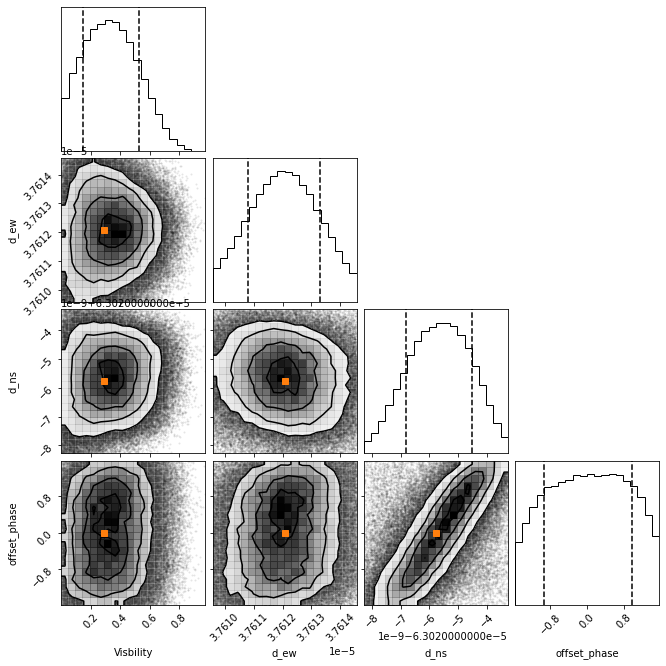

In [10]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_0.5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.93438227e-01 1.33418630e-09 1.20299872e-09 8.26590302e-01]
Sigma ew from general formula = 2.609295327510705e-09
Sigma ns from general formula = 4.372343448260691e-09


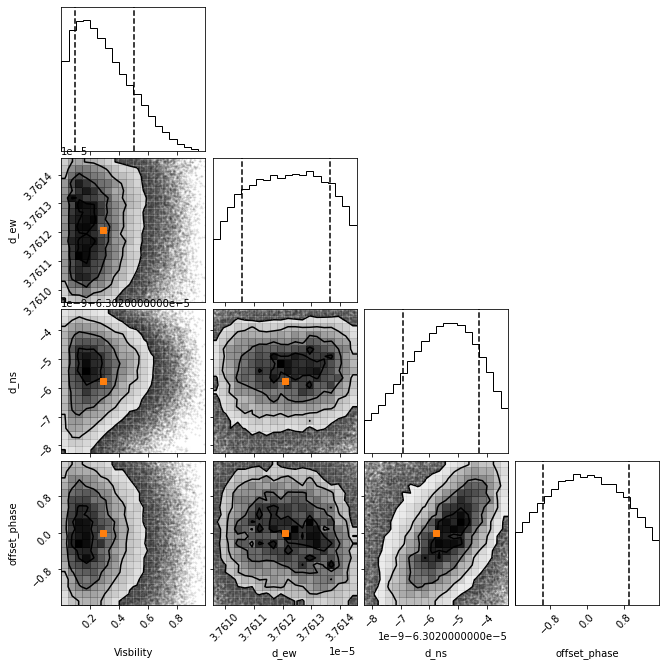

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/15arcsec_0.3m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [7.02320227e-02 4.52877041e-10 1.23410738e-09 7.71089929e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 1.7117645711847135e-09


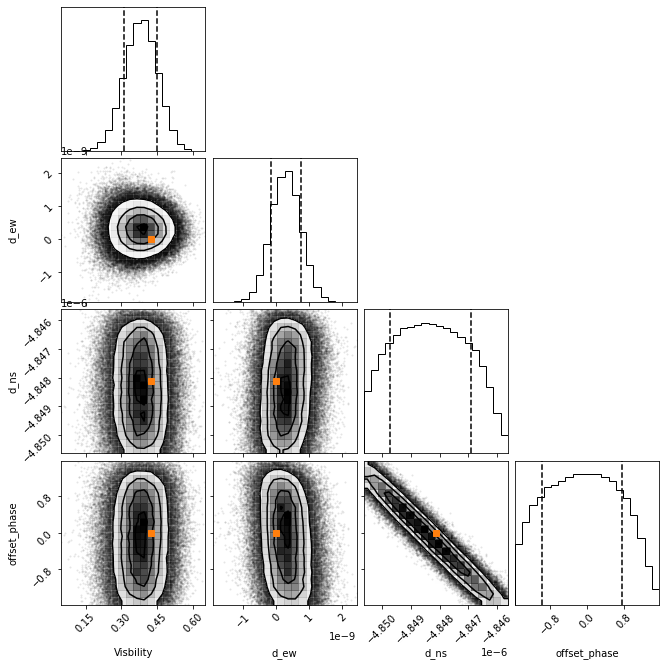

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_1.0m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [2.52756351e-01 1.14375151e-09 1.33309434e-09 8.40858334e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 3.423529142369427e-09


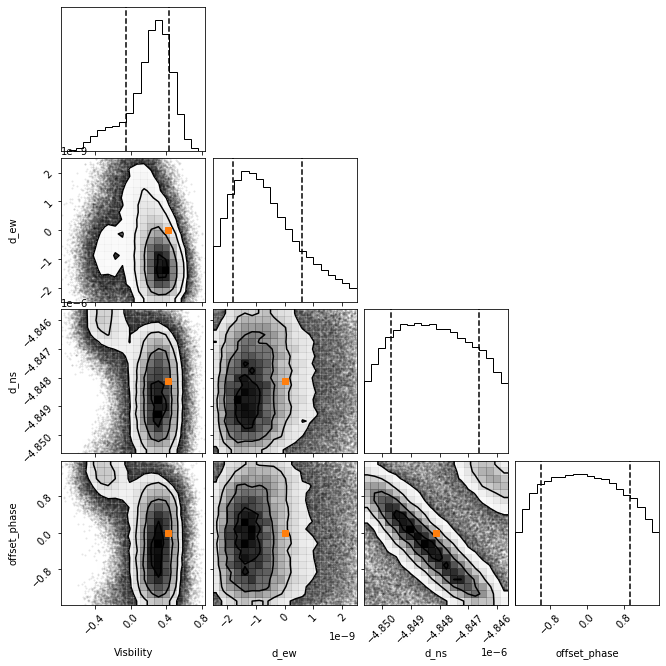

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.5m_2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [8.56171168e-02 4.77533808e-10 1.26083933e-09 7.74579496e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 2.139705713980892e-09


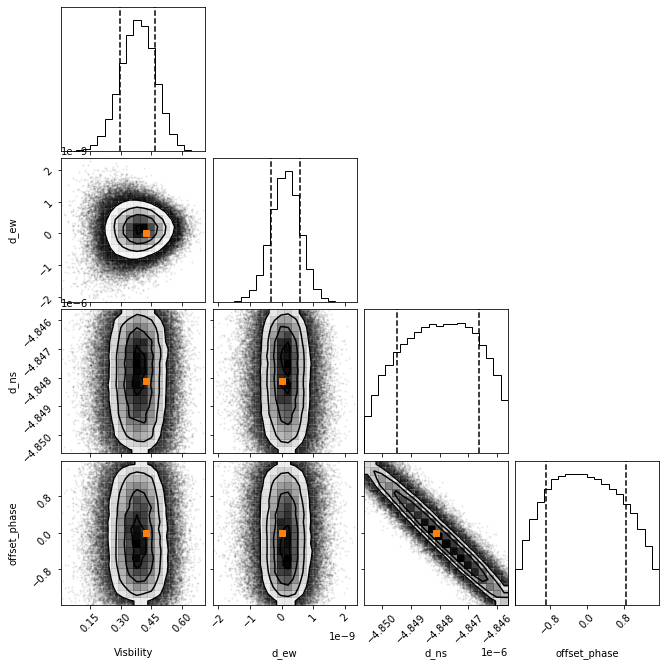

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.8m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.29417672e-01 5.91105472e-10 1.26505074e-09 7.68617425e-01]
Sigma ew from general formula = 0.0
Sigma ns fromDFG general formula = 3.423529142369427e-09


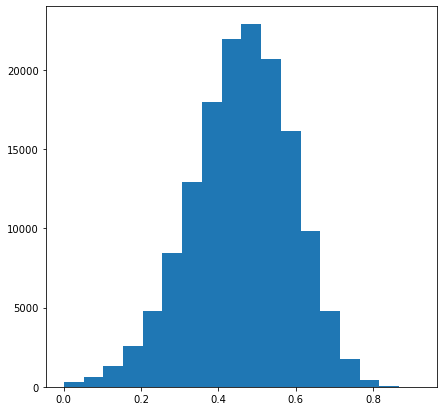

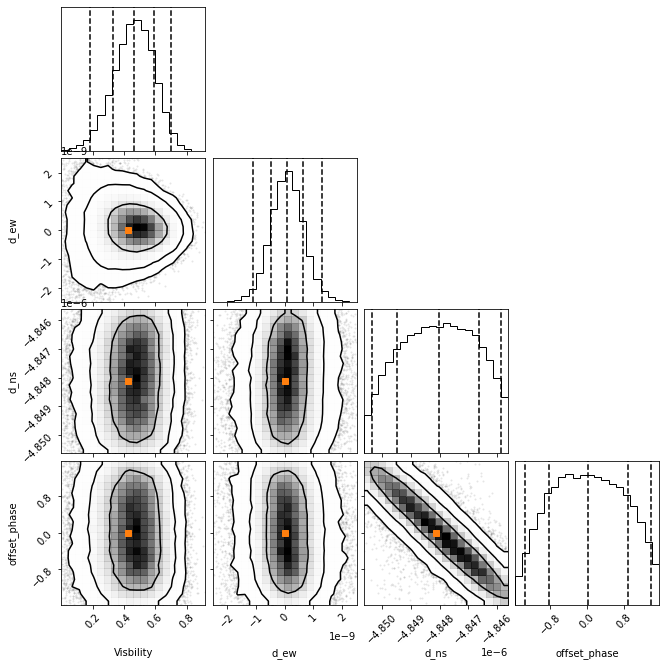

In [17]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.5m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
#fig = plt.figure(figsize=(7,7))
#ax = fig.add_subplot(111)
#ax.hist(mcmc_data[:,0],bins=18)

figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns fromDFG general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [2.08084837e-01 9.39406456e-10 1.22193042e-09 7.60538487e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 5.705881903949045e-09


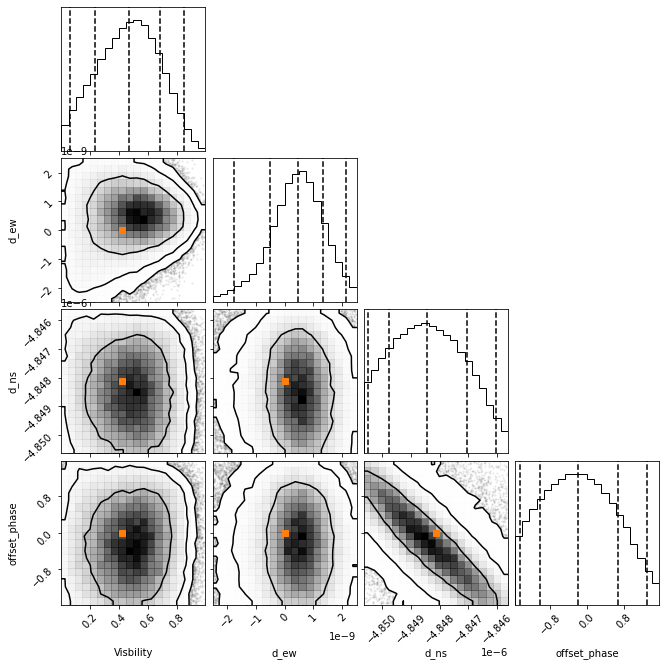

In [21]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.3m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.92527887e-01 1.17250362e-09 1.85137006e-09 8.43416356e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 5.705881903949045e-09


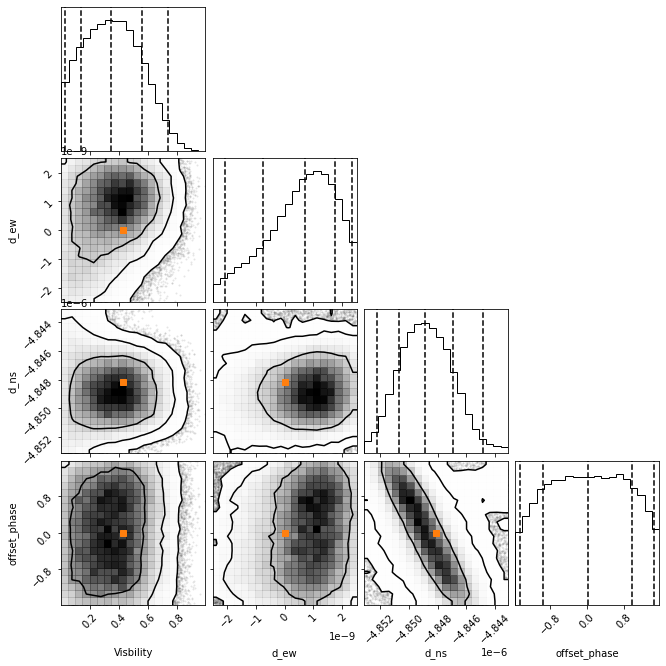

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.3m_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [2.19157071e-01 1.01182706e-09 1.70281723e-09 8.30797285e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 5.705881903949045e-09


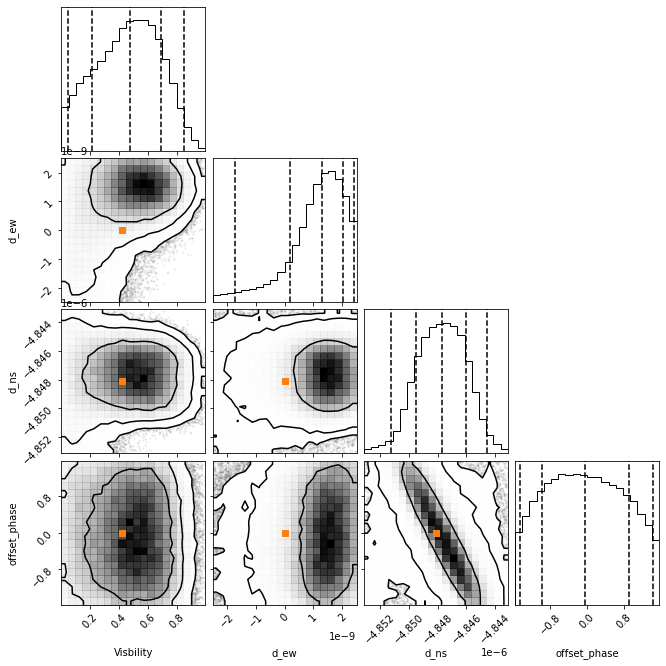

In [10]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.3m_2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [2.16056274e-01 8.25939015e-10 1.66210634e-09 8.45131665e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 5.705881903949045e-09


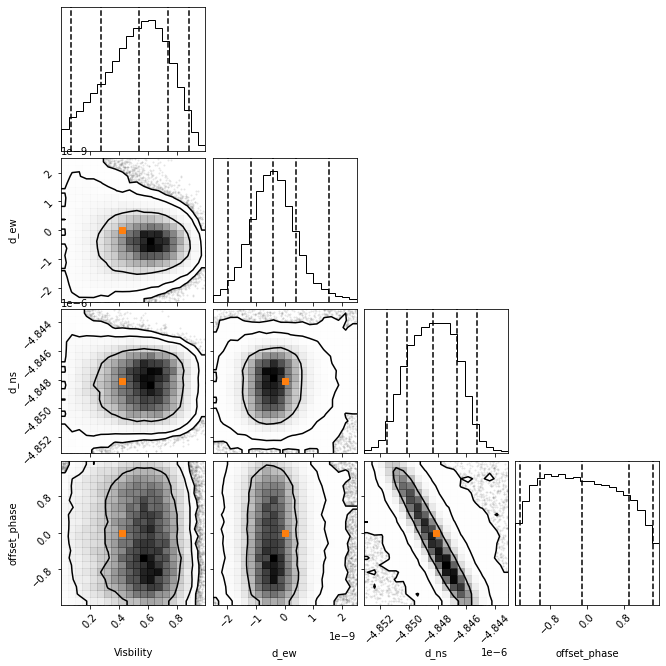

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.3m_3.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.023, 0.16, 0.5, 0.84,0.977),levels=(0.68,0.952,0.994))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [1.93547348e-01 1.27595941e-09 1.32913381e-09 8.16860564e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 8.558822855923567e-09


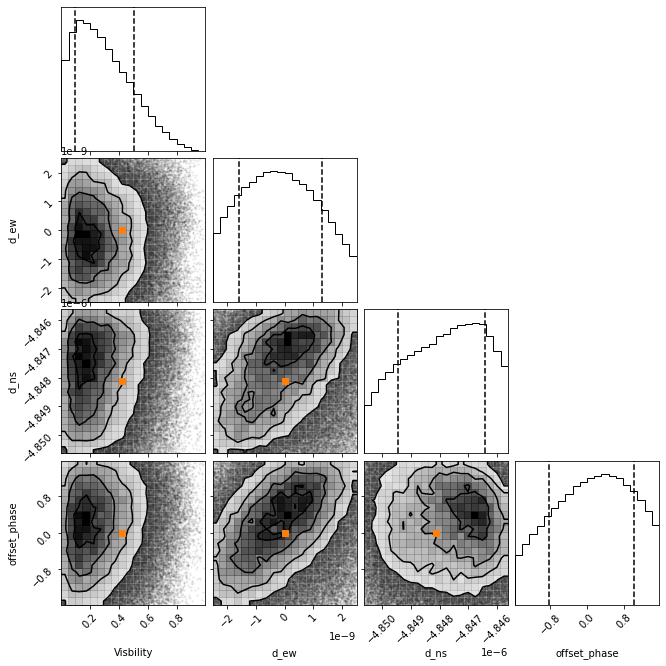

In [9]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.2m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [2.08948343e-01 1.32992135e-09 1.26416338e-09 8.04083686e-01]
Sigma ew from general formula = 0.0
Sigma ns from general formula = 1.7117645711847135e-08


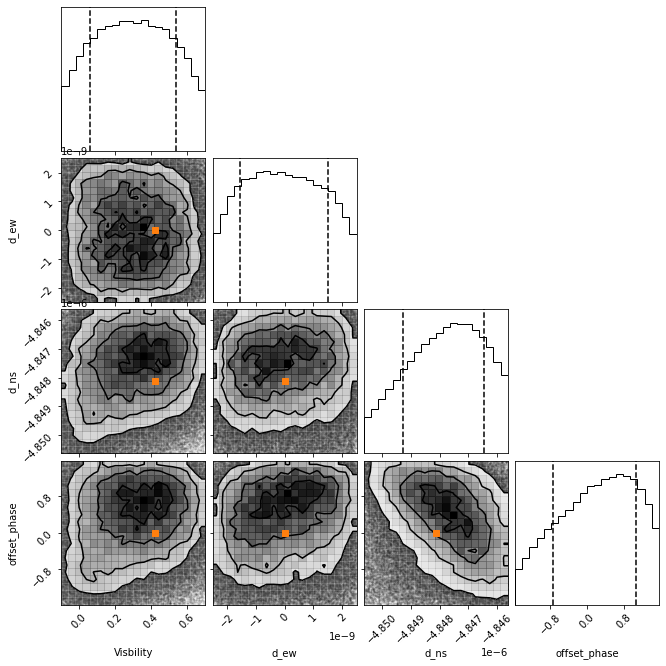

In [10]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/1arcsec_0.1m.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [5.39956664e-02 3.88492931e-10 8.88251326e-10 8.18782364e-01]
Sigma ew from general formula = 3.9139429912660564e-10
Sigma ns from general formula = 6.558515172391034e-10


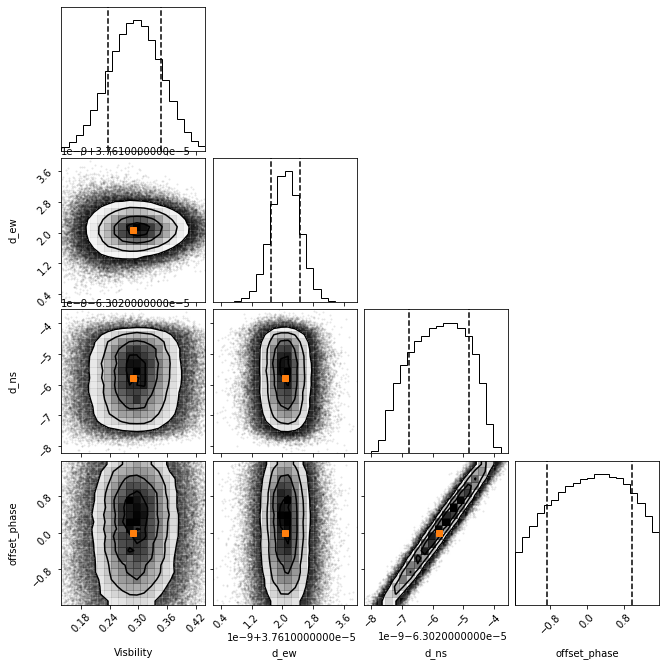

In [5]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_1x_A=2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [7.50698068e-02 8.92093811e-10 9.58061685e-10 8.29145882e-01]
Sigma ew from general formula = 7.827885982532113e-10
Sigma ns from general formula = 1.3117030344782067e-09


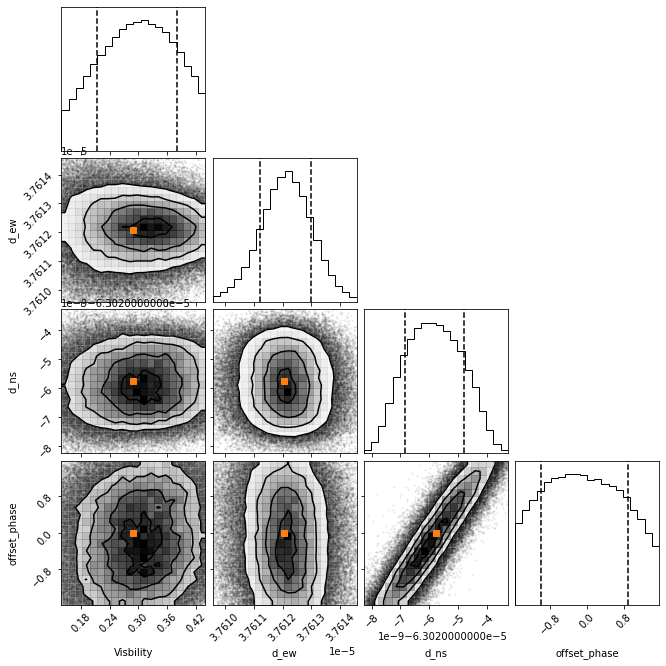

In [5]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_1x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [5.70288266e-02 4.93941929e-10 9.19863741e-10 8.12245479e-01]
Sigma ew from general formula = 4.519432079200615e-10
Sigma ns from general formula = 7.573121000528416e-10


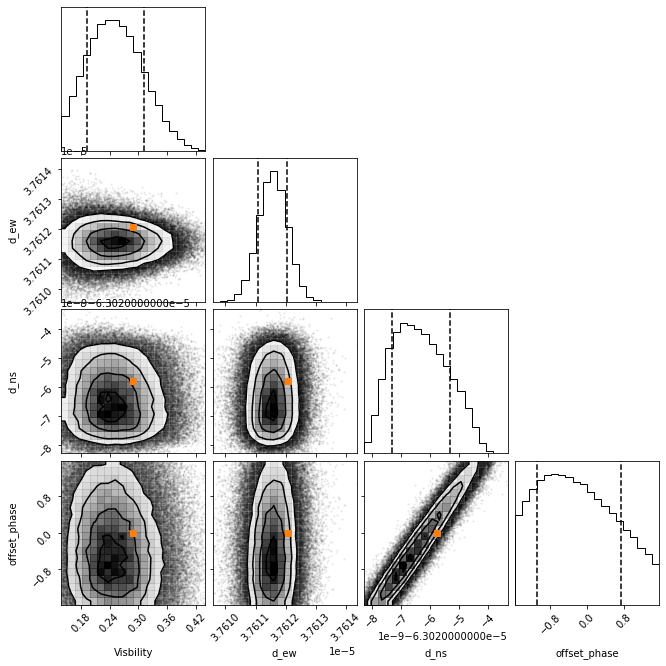

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_3x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

885004
Sigma from MCMC = [3.49665345e-02 2.45818753e-10 1.32775911e-09 1.25992485e-01]
Sigma ew from general formula = 2.5061272221201573e-10
Sigma ns from general formula = 0.0


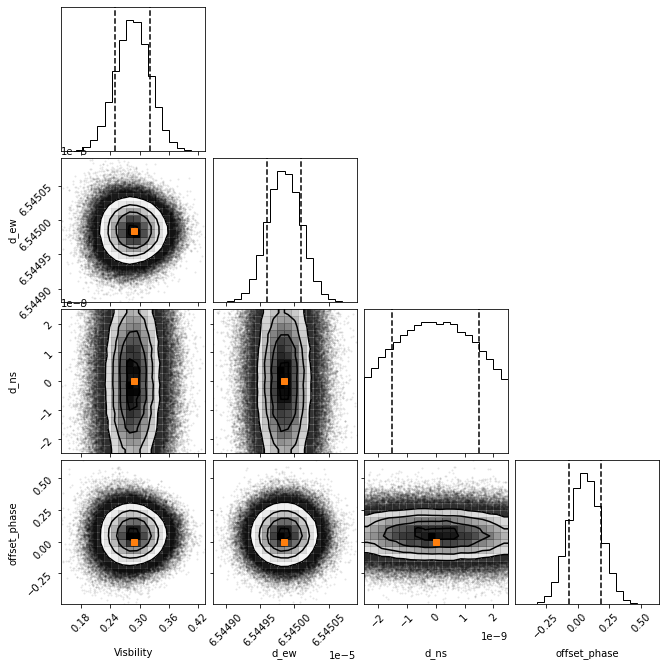

In [12]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_10x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*1/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

885004
Sigma from MCMC = [3.53566436e-02 2.45681893e-10 1.32843109e-09 1.28386706e-01]
Sigma ew from general formula = 2.5061272221201573e-10
Sigma ns from general formula = 0.0


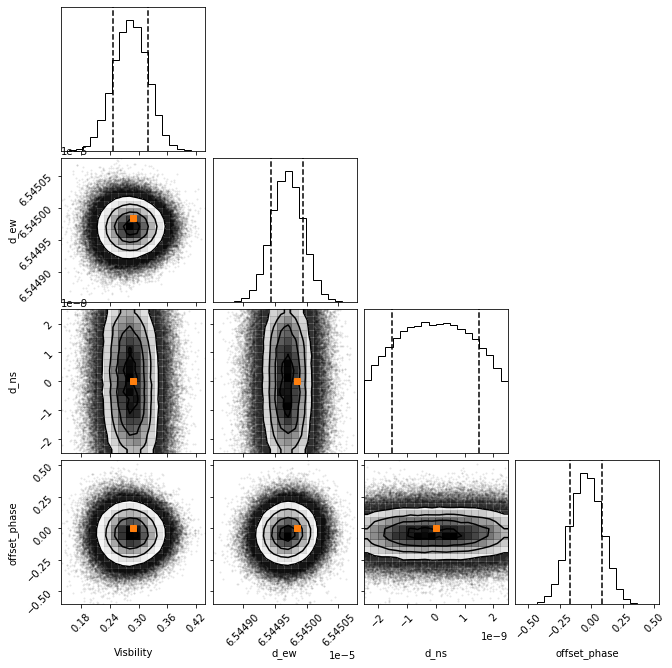

In [14]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_10x_2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*1/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_10x',facecolor='white')

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [4.89884890e-02 3.70626632e-10 1.33664549e-09 1.87656332e-01]
Sigma ew from general formula = 3.544199106554736e-10
Sigma ns from general formula = 0.0


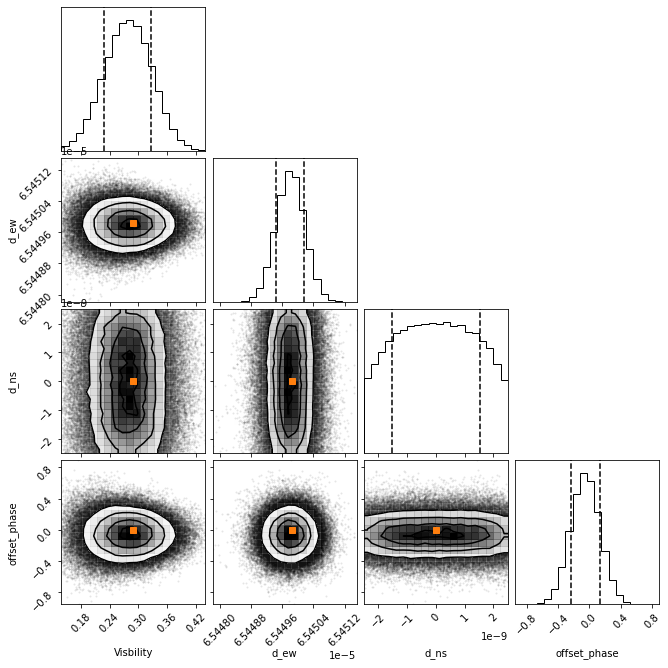

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_5x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*2/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")
figure.savefig('paper_5x',facecolor='white')


# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

295004
Sigma from MCMC = [5.77002578e-02 5.12985661e-10 1.33682212e-09 2.69799047e-01]
Sigma ew from general formula = 4.5755413717765616e-10
Sigma ns from general formula = 0.0


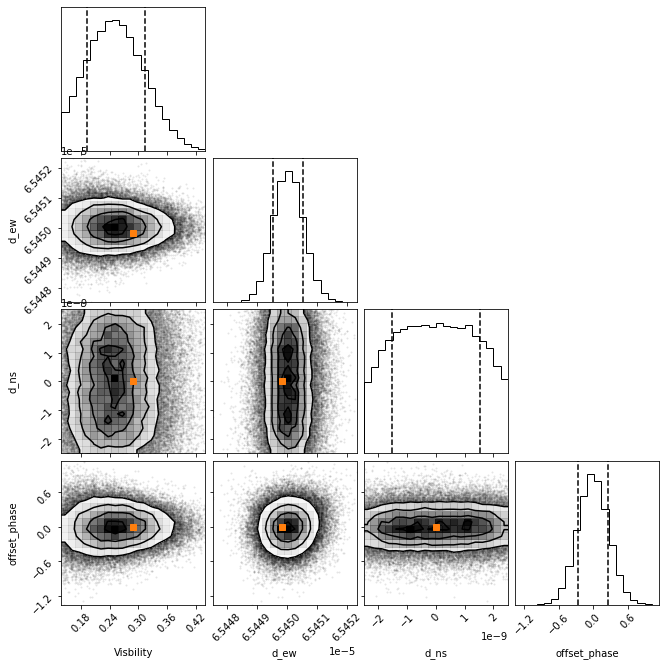

In [6]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_3x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*3/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/(np.sqrt(2*T[1]*task4.avg_rate))*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/(np.sqrt(2*T[1]*task4.avg_rate))*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

295004
Sigma from MCMC = [6.69677185e-02 6.38420051e-10 1.33953024e-09 2.84120776e-01]
Sigma ew from general formula = 5.603870828923387e-10
Sigma ns from general formula = 0.0


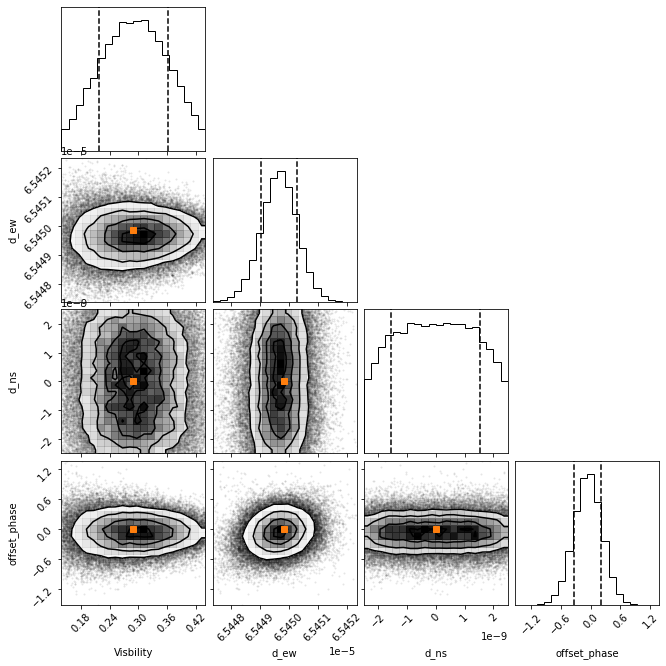

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_2x_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*3/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [6.52039976e-02 1.05210532e-09 1.33481239e-09 5.25613318e-01]
Sigma ew from general formula = 7.925070128050411e-10
Sigma ns from general formula = 0.0


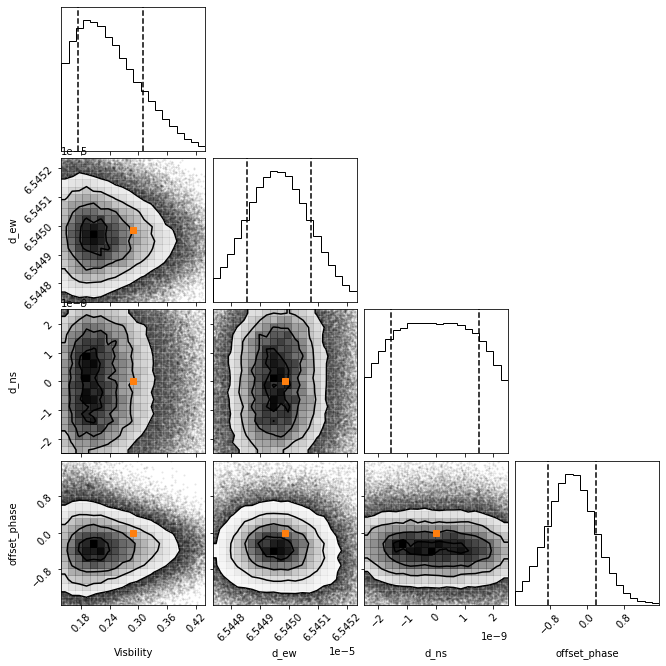

In [8]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_1x_1.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*2.0/4.0)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])
# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [7.29705524e-02 8.80234196e-10 1.33850909e-09 4.17842174e-01]
Sigma ew from general formula = 7.925070128050411e-10
Sigma ns from general formula = 0.0


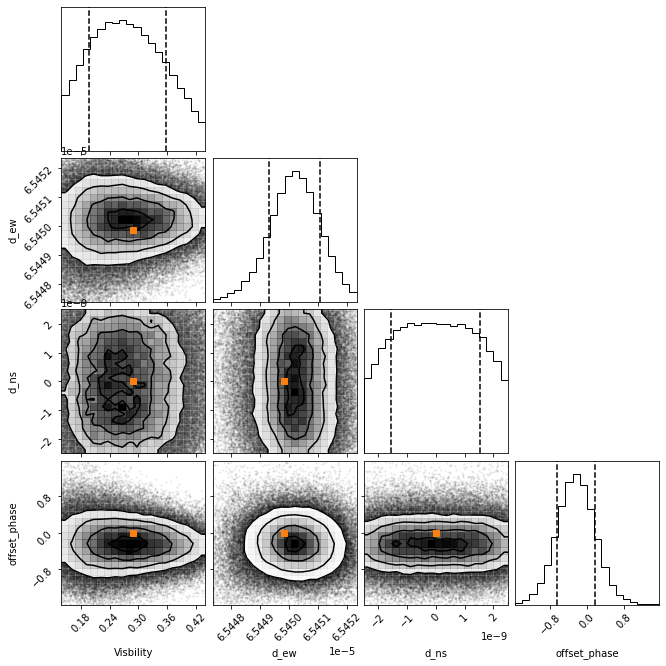

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_1x_2.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*2.0/4.0)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])
# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

885004
Sigma from MCMC = [7.38335465e-02 1.16913816e-09 1.33016695e-09 6.31986082e-01]
Sigma ew from general formula = 1.1207741657846775e-09
Sigma ns from general formula = 0.0


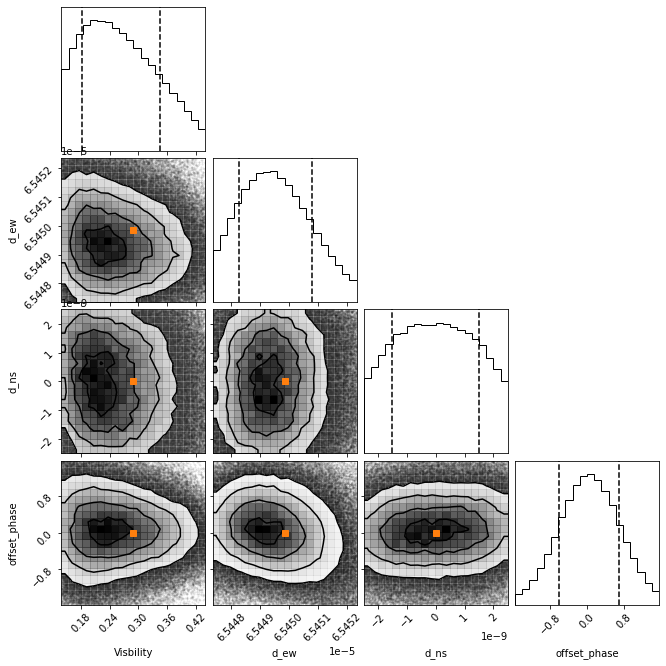

In [7]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_0.5x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*1/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

295004
Sigma from MCMC = [7.92913745e-02 1.29270493e-09 1.31917159e-09 7.23740136e-01]
Sigma ew from general formula = 2.506127222120154e-09
Sigma ns from general formula = 0.0


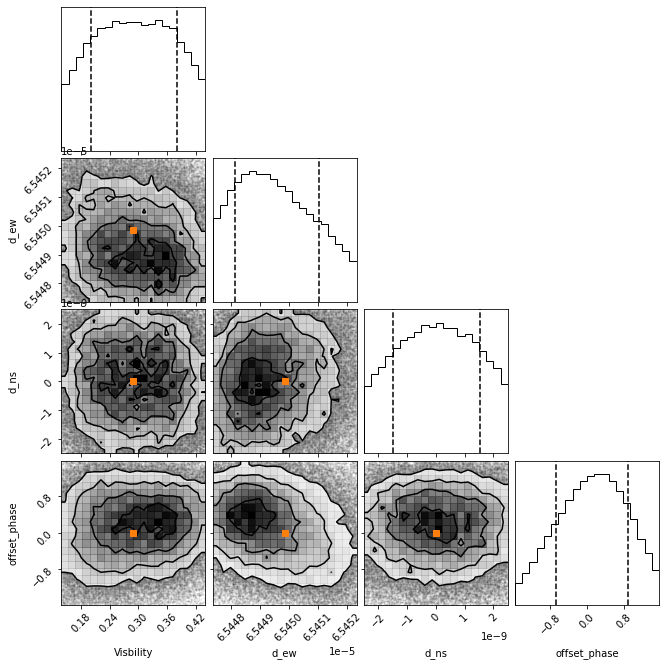

In [15]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/paper_200m_0.1x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size*3/4)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [3.57828264e-02 1.12811052e-09 1.34751726e-09 1.27074911e-01]
Sigma ew from general formula = 1.0568224301086663e-10
Sigma ns from general formula = 1.7708959884846962e-10


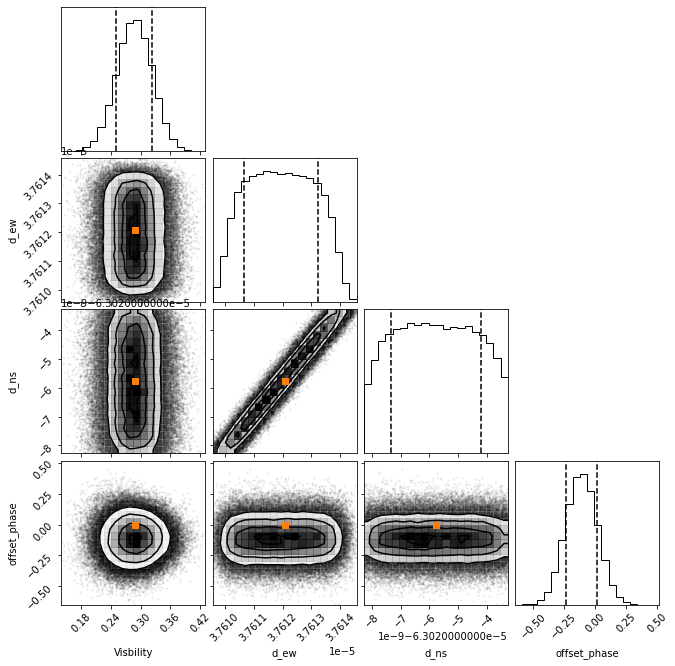

In [28]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_T_T_10x_cos.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

590004
Sigma from MCMC = [3.49558420e-02 1.43903286e-10 1.47220950e-10 1.17273674e-01]
Sigma ew from general formula = 4.306344436576432e-11
Sigma ns from general formula = 7.216054344136554e-11


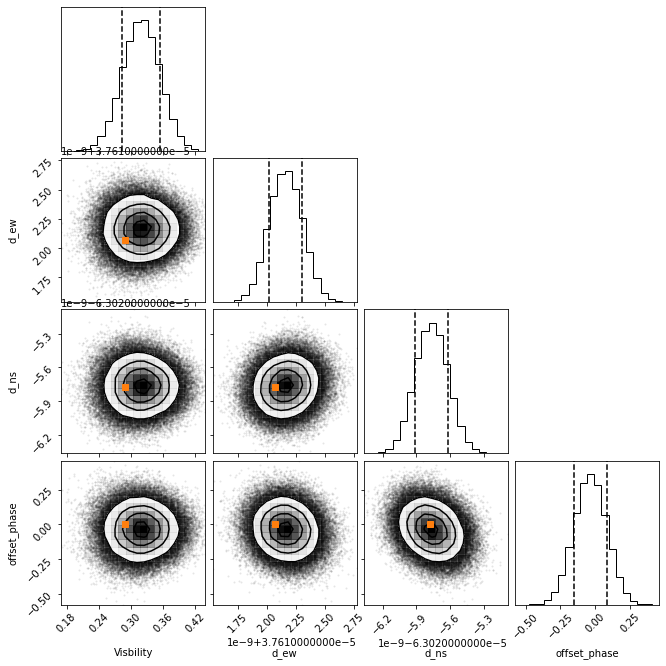

In [10]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_T_T_10x_5x.txt")
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_ew','d_ns','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, np.array(theo_par)[None], marker="s", color="C1",label="Theo")

# Find sigma from the MCMC by calculating the square root of covariance matrix
sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print("Sigma from MCMC =",sigma)

# Find Sigma using formula in the paper:
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
theo_d = np.linalg.norm(d_source[0,0,:])

# Using the General formula:
theo_sigma_ew = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[1]/task4.N)  #
theo_sigma_ns = np.absolute(np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(2*T[1]*task4.avg_rate)*theo_par[2]/task4.N) 
print("Sigma ew from general formula =", theo_sigma_ew)
print("Sigma ns from general formula =", theo_sigma_ns)

In [ ]:
''' Make histogram  '''
theo_phase = task4.phase                          # Theoretical phase
theo = sim_data(theo_par,B,pos[3],task4.timestamp,lam,d_source[0,0,:])  
theo_log = theo.loglike_wprior(Num = True)

maxLike_par = np.delete(np.loadtxt("/home/Zhi/QA-sim/MCMC_output/EW_200m_6PI_T_T_10x.maxlike"),[0,1])
maxLike =sim_data(maxLike_par,B,pos[3],task4.timestamp,lam,d_source[0,0,:])  
maxLike_phase = np.mod((maxLike.get_phase() + np.pi),2*np.pi) - np.pi                  #Phase of maxlike phase
maxLike_log = maxLike.loglike_wprior(Num = True)


shift = np.array([0.,0.,0.,2.])
shiftLike = sim_data(maxLike_par+shift,B,pos[3],task4.timestamp,lam,d_source[0,0,:])
shiftLike_phase = np.mod((shiftLike.get_phase() + np.pi),2*np.pi) - np.pi    #
shiftLike_log = shiftLike.loglike_wprior(Num = True)


diff_maxLike = np.mod((maxLike_phase - theo_phase+ np.pi),2*np.pi) - np.pi     #[-pi, pi] x-axis of hist
#diff_maxLike = maxLike_phase - theo_phase

diff_shiftLike = np.mod((shiftLike_phase - theo_phase + np.pi), 2*np.pi) - np.pi  # x-axis of his
#diff_shiftLike = shiftLike_phase - theo_phase

In [ ]:
nbin = 200
fig = plt.figure(figsize=(15,15))

ax1 = fig.add_subplot(221)
ax1.hist(diff_maxLike,nbin)
ax1.set_xlabel(r'$\Delta \phi$')
ax1.set_title('Phase diff between theo phase and maxlike phase')

ax2 = fig.add_subplot(222)
ax2.hist(diff_shiftLike,nbin)
ax2.set_xlabel(r'$\Delta \phi$')
ax2.set_title('Phase diff between Shift Phase par from maxlike and theo phase')

total loglike of diff maxlike:  887.5043852854844
total loglike of diff shiftlike:  -452.7671523958803


Text(0.5, 1.0, 'Phase diff between Shift Phase par from maxlike and theo phase')

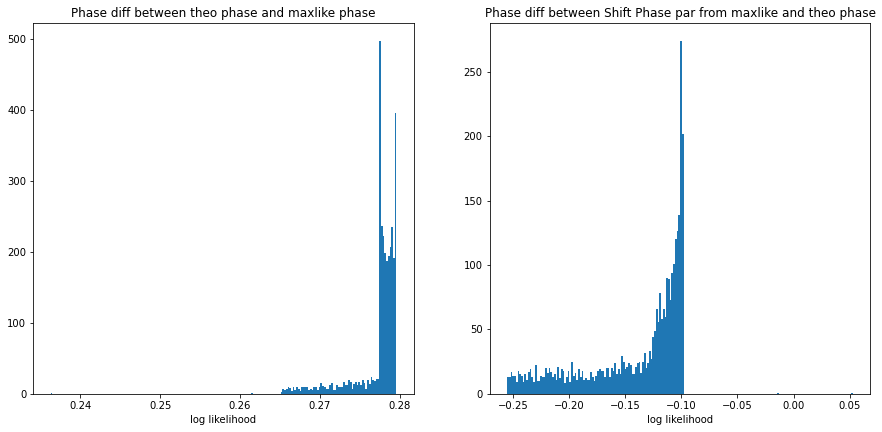

In [100]:
nbin = 200
fig = plt.figure(figsize=(15,15))
h_max = np.histogram(maxLike_log,nbin)[0]
h_shift = np.histogram(shiftLike_log,nbin)[0]

def loglike(dphi,V):
    return np.log(1+V*np.cos(dphi))

ax1 = fig.add_subplot(221)
#ax1.plot(np.linspace(np.amin(diff_maxLike),np.amax(diff_maxLike),len(h_max)),h_max)
#ax1.hist(maxLike_log,nbin)
ax1.hist(loglike(diff_maxLike,maxLike_par[0]),nbin)
print('total loglike of diff maxlike: ',np.sum(loglike(diff_maxLike,maxLike_par[0])))
ax1.set_xlabel('log likelihood');ax1.set_ylabel('')
ax1.set_title('Phase diff between theo phase and maxlike phase')

ax2 = fig.add_subplot(222)
#ax2.plot(np.linspace(np.amin(diff_shiftLike),np.amax(diff_shiftLike),len(h_shift)),h_shift)
#ax2.hist(shiftLike_log,nbin)
ax2.hist(loglike(diff_shiftLike,maxLike_par[0]),nbin)
print('total loglike of diff shiftlike: ' ,np.sum(loglike(diff_shiftLike,maxLike_par[0])))
ax2.set_xlabel('log likelihood')
ax2.set_title('Phase diff between Shift Phase par from maxlike and theo phase')

loglike after shifting phase =  9.12487008725832
loglike after shifting EW separation =  8.92813166957442


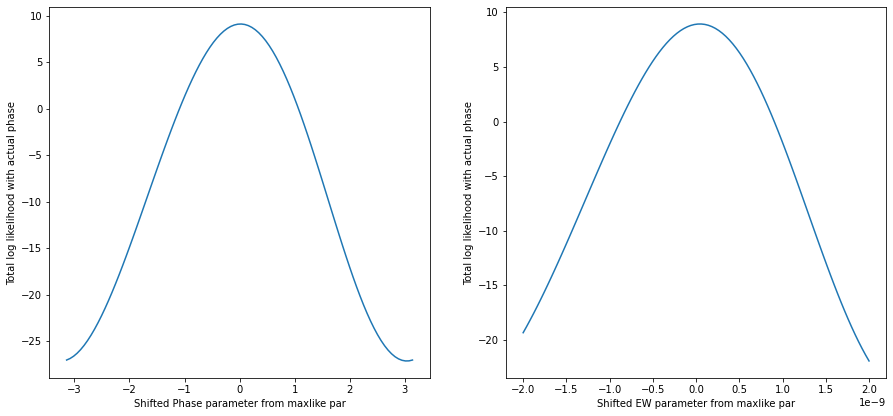

In [24]:
# For phase (not diff phase)
theo_phase = task4.phase                          # Theoretical phase
theo = sim_data(theo_par,B,source,task4.timestamp,lam,d_source[0,0,:])  

maxLike_par = np.delete(np.loadtxt("/home/Zhi/QA-sim/MCMC_output/BSC_200m_T_T_10x_2.maxlike"),[0,1])
maxLike =sim_data(maxLike_par,B,source,task4.timestamp,lam,d_source[0,0,:])  
maxLike_phase = np.mod((maxLike.get_phase() + np.pi),2*np.pi) - np.pi                  #Phase of maxlike phase

shiftLike_phi = []
phi = np.linspace(-np.pi,np.pi,100)
nbin = 200

for i in phi:
    shift = np.array([0.,0.,0.,i])
    shiftLike = sim_data(maxLike_par+shift,B,source,task4.timestamp,lam,d_source[0,0,:])
    shiftLike_log = shiftLike.loglike_wprior()
    shiftLike_phi.append(shiftLike_log)

shiftLike_phi = np.array(shiftLike_phi)

shiftLike_EW = []
EW = np.linspace(-2e-9,2e-9,100)
for i in EW:
    shift = np.array([0.,i,1e-9,0.])
    shiftLike = sim_data(maxLike_par+shift,B,source,task4.timestamp,lam,d_source[0,0,:])
    shiftLike_log = shiftLike.loglike_wprior()
    shiftLike_EW.append(shiftLike_log)

shiftLike_EW = np.array(shiftLike_EW)

fig = plt.figure(figsize=(15,15))
ax1 = fig.add_subplot(221)
ax1.plot(phi,shiftLike_phi)
ax1.set_xlabel('Shifted Phase parameter from maxlike par');ax1.set_ylabel('Total log likelihood with actual phase')
ax2 = fig.add_subplot(222)
ax2.plot(EW,shiftLike_EW)
ax2.set_xlabel('Shifted EW parameter from maxlike par');ax2.set_ylabel('Total log likelihood with actual phase')

'''
def loglike(dphi,V):
    return np.sum(np.log(1+V*np.cos(dphi)))

shiftLike_diffPhi = []
for i in phi:
    shift = np.array([0.,2e-9,2e-9,i])
    shiftLike = sim_data(maxLike_par+shift,B,pos[3],task4.timestamp,lam,d_source[0,0,:])
    shiftLike_phase = np.mod((shiftLike.get_phase() + np.pi),2*np.pi) - np.pi    #
    diff_shiftLike = np.mod((shiftLike_phase - theo_phase + np.pi), 2*np.pi) - np.pi
    shiftLike_diffPhi.append(loglike(diff_shiftLike,maxLike_par[0]))
    
shiftLike_diffPhi = np.array(shiftLike_diffPhi)

ax2 = fig.add_subplot(222)
ax2.plot(phi,shiftLike_diffPhi)
ax2.set_xlabel('Shifted Phase parameter from maxlike par');ax1.set_ylabel('Total log likelihood with difference in phase')
'''

print('loglike after shifting phase = ',np.amax(shiftLike_phi))
print('loglike after shifting EW separation = ',np.amax(shiftLike_EW))